# CODICE FINALE!!!

In [1]:
# Importiamo le librerie necessarie
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns

# Caricamento dei dati (modifica i percorsi ai tuoi file)
print("=== 1. Lettura dei CSV ===")
transfers = pd.read_csv("../Datasets/SNA/transfers.csv")
clubs = pd.read_csv("../Datasets/SNA/clubs.csv")

# Verifica dei dati caricati
print("\nAnteprima del dataset Clubs:")
print(clubs.head())

print("\nAnteprima del dataset Transfers:")
print(transfers.head())


The history saving thread hit an unexpected error (DatabaseError('database disk image is malformed')).History will not be written to the database.
=== 1. Lettura dei CSV ===

Anteprima del dataset Clubs:
   club_id          club_code                             name  \
0      105    sv-darmstadt-98                  SV Darmstadt 98   
1    11127  ural-ekaterinburg               Ural Yekaterinburg   
2      114  besiktas-istanbul        Beşiktaş Jimnastik Kulübü   
3       12             as-rom       Associazione Sportiva Roma   
4      148  tottenham-hotspur  Tottenham Hotspur Football Club   

  domestic_competition_id  total_market_value  squad_size  average_age  \
0                      L1                 NaN          27         25.6   
1                     RU1                 NaN          30         26.5   
2                     TR1                 NaN          31         26.4   
3                     IT1                 NaN          26         26.4   
4                     GB1    

In [2]:
# ------------------------------------------------------
# 2. CONVERSIONE DEI DATI
# ------------------------------------------------------
print("\n=== 2. Conversione dei club_id in entrambi i dataset ===")

# Assicuriamoci che 'club_id' sia un intero
clubs["club_id"] = clubs["club_id"].astype(int)
transfers["from_club_id"] = transfers["from_club_id"].astype(int)
transfers["to_club_id"] = transfers["to_club_id"].astype(int)

# Verifica che i tipi siano corretti
print(f"\nTipo di 'club_id' in clubs: {clubs['club_id'].dtype}")
print(f"Tipo di 'from_club_id' e 'to_club_id' in transfers: {transfers['from_club_id'].dtype}, {transfers['to_club_id'].dtype}")


=== 2. Conversione dei club_id in entrambi i dataset ===

Tipo di 'club_id' in clubs: int64
Tipo di 'from_club_id' e 'to_club_id' in transfers: int64, int64


In [3]:
# ------------------------------------------------------
# 3. CREAZIONE DEL DIZIONARIO CLUB_ID -> CLUB_NAME
# ------------------------------------------------------
print("\n=== 3. Creazione dizionario club_id -> club_name ===")
club_id_to_name = dict(zip(clubs["club_id"], clubs["name"]))

# Verifica del dizionario
print("\nEsempio di dizionario club_id -> club_name (primi 5):")
for i, (k, v) in enumerate(club_id_to_name.items()):
    if i >= 5:
        break
    print(f"{k} -> {v}")


=== 3. Creazione dizionario club_id -> club_name ===

Esempio di dizionario club_id -> club_name (primi 5):
105 -> SV Darmstadt 98
11127 -> Ural Yekaterinburg
114 -> Beşiktaş Jimnastik Kulübü
12 -> Associazione Sportiva Roma
148 -> Tottenham Hotspur Football Club


Dettaglio delle metriche:


	•	Numero di nodi: Calcola il numero di nodi nel grafo.
	•	Numero di archi: Calcola il numero di archi nel grafo.
	•	Densità: La densità di un grafo è il rapporto tra il numero di archi effettivi e il numero massimo di archi possibili in un grafo completo.
	•	Clustering medio: La media dei coefficienti di clustering per tutti i nodi del grafo. Indica la “densità” di connessioni tra vicini di un nodo.
	•	Raggio: Il raggio del grafo è la massima distanza più breve tra un nodo e qualsiasi altro nodo (solo nei grafi connessi).
	•	Diametro: Il diametro del grafo è la massima distanza tra due nodi qualsiasi (solo nei grafi connessi). (Uso average_clustering: Poiché stiamo lavorando con un grafo diretto, il calcolo del clustering viene fatto su una versione non diretta del grafo, utilizzando G.to_undirected(). Questo converte temporaneamente il grafo diretto in uno non diretto per il calcolo del clustering, che non è definito per i grafi diretti.)
	•	Grado dei nodi: Il grado di un nodo è il numero di archi incidenti su di esso. La funzione restituisce un dizionario con il grado per ogni nodo.
	•	Centralità di grado: La centralità di grado di un nodo è il rapporto tra il grado del nodo e il numero massimo di nodi che può avere.
	•	Centralità di betweenness: La centralità di betweenness misura quanto un nodo funge da ponte (o “mediator”) tra altri due nodi.
	•	Centralità di PageRank: Misura la “importanza” di un nodo basata sulla struttura del grafo, considerando la centralità dei suoi vicini.

In [4]:
import networkx as nx

def calculate_and_print_graph_metrics(G):
    # Numero di nodi
    num_nodes = G.number_of_nodes()

    # Numero di archi
    num_edges = G.number_of_edges()

    # Densità del grafo
    density = round(nx.density(G), 3)

    # Clustering medio (per grafi diretti)
    avg_clustering = round(nx.average_clustering(G.to_undirected()), 3)  # Usiamo la versione non diretta per il clustering

    # Verifica se il grafo è fortemente connesso
    if nx.is_strongly_connected(G):
        radius = nx.radius(G)
        diameter = nx.diameter(G)
    else:
        radius = None
        diameter = None

    # Grado dei nodi
    degree = dict(G.degree())

    # Centralità di grado
    degree_centrality = nx.degree_centrality(G)

    # Centralità di betweenness
    betweenness_centrality = nx.betweenness_centrality(G)

    # Aggiungiamo altre metriche interessanti come la centralità di PageRank
    pagerank_centrality = nx.pagerank(G)

    # Stampiamo le metriche
    print("\n=== Metriche del grafo ===")
    print(f"Numero di nodi: {num_nodes}")
    print(f"Numero di archi: {num_edges}")
    print(f"Densità del grafo: {density}")
    print(f"Clustering medio: {avg_clustering}")
    print(f"Raggio del grafo: {radius}")
    print(f"Diametro del grafo: {diameter}")
    print(f"Grado dei nodi: {degree}")
    print(f"Centralità di grado: {degree_centrality}")
    print(f"Centralità di betweenness: {betweenness_centrality}")
    print(f"Centralità di PageRank: {pagerank_centrality}")

In [5]:
# ------------------------------------------------------
# 4. CREAZIONE DEL GRAFO DEI CLUB
# ------------------------------------------------------
print("\n=== 4. Creazione del grafo dei club con tutti i trasferimenti ===")

# Creiamo un grafo diretto (i trasferimenti vanno da un club a un altro)
G = nx.DiGraph()

# Contatori per i trasferimenti scartati e per club non validi
ignored_transfers = 0
valid_transfers = 0
missing_club_counts = {}

# Aggiungiamo gli archi (trasferimenti tra club)
for idx, row in transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    # Verifica che i club_id siano validi nel dizionario
    if from_club in club_id_to_name and to_club in club_id_to_name:
        valid_transfers += 1
        if G.has_edge(from_club, to_club):
            # Incrementa il peso (numero di trasferimenti)
            G[from_club][to_club]["weight"] += 1
            G[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
        else:
            # Aggiungi l'arco con peso 1
            G.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))
    else:
        ignored_transfers += 1
        # Traccia i club mancanti e incrementa il contatore
        missing_clubs = []
        if from_club not in club_id_to_name:
            missing_clubs.append(f"from_club: {from_club}")
            if from_club not in missing_club_counts:
                missing_club_counts[from_club] = 0
            missing_club_counts[from_club] += 1
        if to_club not in club_id_to_name:
            missing_clubs.append(f"to_club: {to_club}")
            if to_club not in missing_club_counts:
                missing_club_counts[to_club] = 0
            missing_club_counts[to_club] += 1
        
        print(f"Trasferimento ignorato per club_id non valido: {', '.join(missing_clubs)}")

# Stampa dei risultati
print(f"\nNumero di nodi (club) nel grafo: {G.number_of_nodes()}")
print(f"Numero di archi (trasferimenti) nel grafo: {G.number_of_edges()}")
print(f"\nNumero totale di trasferimenti: {valid_transfers}")
print(f"Numero di trasferimenti ignorati: {ignored_transfers}")

# Ordinare il dizionario in ordine decrescente in base al numero di occorrenze
sorted_missing_clubs = sorted(missing_club_counts.items(), key=lambda x: x[1])

# Stampa il numero di trasferimenti ignorati per ciascun club mancante in ordine decrescente
for club, count in sorted_missing_clubs:
    print(f"Trasferimenti mancati a causa del club {club}: {count}")
    
calculate_and_print_graph_metrics(G)


=== 4. Creazione del grafo dei club con tutti i trasferimenti ===
Trasferimento ignorato per club_id non valido: from_club: 279
Trasferimento ignorato per club_id non valido: to_club: 1030
Trasferimento ignorato per club_id non valido: from_club: 3837, to_club: 11204
Trasferimento ignorato per club_id non valido: to_club: 123
Trasferimento ignorato per club_id non valido: to_club: 123
Trasferimento ignorato per club_id non valido: to_club: 123
Trasferimento ignorato per club_id non valido: to_club: 515
Trasferimento ignorato per club_id non valido: to_club: 515
Trasferimento ignorato per club_id non valido: to_club: 515
Trasferimento ignorato per club_id non valido: from_club: 7732
Trasferimento ignorato per club_id non valido: from_club: 8815
Trasferimento ignorato per club_id non valido: from_club: 6945
Trasferimento ignorato per club_id non valido: from_club: 447
Trasferimento ignorato per club_id non valido: from_club: 15642
Trasferimento ignorato per club_id non valido: from_club

In [6]:
# ------------------------------------------------------
# 4.1 Creazione del grafo G con la gestione degli svincolati
# ------------------------------------------------------
print("\n=== 4.1 Creazione del grafo G con la gestione degli svincolati ===")

# Creiamo una copia del grafo originale G_backup per non alterarlo
G_backup = G.copy()

# Creiamo il grafo G, che sarà il grafo modificato
G = nx.DiGraph()

# Creiamo un dizionario per contare i trasferimenti mancati per ogni club
missing_transfers_count = {}

# Aggiungiamo gli archi (trasferimenti tra club)
for idx, row in transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]

    # Se il club di origine o destinazione è 515 (svincolati), lo sostituiamo con "Svincolati"
    if from_club == 515:
        from_club = "Svincolati"
    if to_club == 515:
        to_club = "Svincolati"

    # Verifica che i club_id siano validi nel dizionario (adesso include anche "Svincolati")
    if from_club in club_id_to_name or from_club == "Svincolati":
        if to_club in club_id_to_name or to_club == "Svincolati":
            if G.has_edge(from_club, to_club):
                # Incrementa il peso (numero di trasferimenti)
                G[from_club][to_club]["weight"] += 1
                G[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
            else:
                # Aggiungi l'arco con peso 1
                G.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))
        else:
            # Incrementa i trasferimenti mancati a causa del club di destinazione non valido
            if to_club not in missing_transfers_count:
                missing_transfers_count[to_club] = 0
            missing_transfers_count[to_club] += 1
            print(f"Trasferimento ignorato: il club {to_club} non è valido")
    else:
        # Incrementa i trasferimenti mancati a causa del club di origine non valido
        if from_club not in missing_transfers_count:
            missing_transfers_count[from_club] = 0
        missing_transfers_count[from_club] += 1
        print(f"Trasferimento ignorato: il club {from_club} non è valido")

# Verifica il numero di nodi e archi nel grafo G
print(f"\nNumero di nodi nel grafo G: {G.number_of_nodes()}")
print(f"Numero di archi nel grafo G: {G.number_of_edges()}")

# Stampa i club coinvolti nel grafo
print("\nNodi nel grafo G:")
print(G.nodes())

# Stampa il numero di trasferimenti tra club nel grafo G
total_transfers = sum([G[u][v]['weight'] for u, v in G.edges()])
print(f"\nNumero totale di trasferimenti nel grafo G: {total_transfers}")

calculate_and_print_graph_metrics(G)


=== 4.1 Creazione del grafo G con la gestione degli svincolati ===
Trasferimento ignorato: il club 279 non è valido
Trasferimento ignorato: il club 1030 non è valido
Trasferimento ignorato: il club 3837 non è valido
Trasferimento ignorato: il club 123 non è valido
Trasferimento ignorato: il club 123 non è valido
Trasferimento ignorato: il club 123 non è valido
Trasferimento ignorato: il club 7732 non è valido
Trasferimento ignorato: il club 8815 non è valido
Trasferimento ignorato: il club 6945 non è valido
Trasferimento ignorato: il club 447 non è valido
Trasferimento ignorato: il club 15642 non è valido
Trasferimento ignorato: il club 101362 non è valido
Trasferimento ignorato: il club 978 non è valido
Trasferimento ignorato: il club 409 non è valido
Trasferimento ignorato: il club 332 non è valido
Trasferimento ignorato: il club 1017 non è valido
Trasferimento ignorato: il club 279 non è valido
Trasferimento ignorato: il club 2581 non è valido
Trasferimento ignorato: il club 31614 

In [7]:
# ------------------------------------------------------
# 4.2 Stampa dei trasferimenti mancati per club
# ------------------------------------------------------
print("\n=== Trasferimenti mancati a causa dei club ===")

# Ordina i trasferimenti mancati in ordine crescente di occorrenze
sorted_missing_transfers = sorted(missing_transfers_count.items(), key=lambda x: x[1])

# Stampa i trasferimenti mancati per ogni club
for club, count in sorted_missing_transfers:
    print(f"Trasferimenti mancati a causa del club {club}: {count}")


=== Trasferimenti mancati a causa dei club ===
Trasferimenti mancati a causa del club 34499: 1
Trasferimenti mancati a causa del club 46293: 1
Trasferimenti mancati a causa del club 52687: 1
Trasferimenti mancati a causa del club 16576: 1
Trasferimenti mancati a causa del club 12497: 1
Trasferimenti mancati a causa del club 75596: 1
Trasferimenti mancati a causa del club 76417: 1
Trasferimenti mancati a causa del club 120394: 1
Trasferimenti mancati a causa del club 101813: 1
Trasferimenti mancati a causa del club 79389: 1
Trasferimenti mancati a causa del club 15916: 1
Trasferimenti mancati a causa del club 2945: 1
Trasferimenti mancati a causa del club 95354: 1
Trasferimenti mancati a causa del club 12019: 1
Trasferimenti mancati a causa del club 91427: 1
Trasferimenti mancati a causa del club 98106: 1
Trasferimenti mancati a causa del club 8231: 1
Trasferimenti mancati a causa del club 20887: 1
Trasferimenti mancati a causa del club 83266: 1
Trasferimenti mancati a causa del club 5

In [8]:
# ------------------------------------------------------
# 5. RILABEL DEI NODI CON I NOMI DEI CLUB
# ------------------------------------------------------
print("\n=== 5. Rilabel dei nodi con i nomi dei club ===")

# Rilabel dei nodi nel grafo con i nomi dei club
nx.relabel_nodes(G, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")
    
# Stampa i club coinvolti nel grafo
print("\nNodi nel grafo G:")
print(G.nodes())


=== 5. Rilabel dei nodi con i nomi dei club ===

Esempio di nodi con nome (primi 5):
Svincolati -> {}
Verein für Bewegungsspiele Stuttgart 1893 -> {}
FC Bayern München -> {}
1. Fußball- und Sportverein Mainz 05 -> {}
Società Sportiva Lazio S.p.A. -> {}

Nodi nel grafo G:
['Svincolati', 'Verein für Bewegungsspiele Stuttgart 1893', 'FC Bayern München', '1. Fußball- und Sportverein Mainz 05', 'Società Sportiva Lazio S.p.A.', 'US Salernitana 1919', 'APO Levadiakos Football Club', 'Panathinaikos Athlitikos Omilos', 'Inverness Caledonian Thistle FC', 'Dundee United Football Club', 'Sport Lisboa e Benfica', 'Beşiktaş Jimnastik Kulübü', 'Brøndby Idrætsforening', 'FK Rostov', 'Fußball-Club Augsburg 1907', 'Stade brestois 29', 'Associazione Calcio Fiorentina', 'Fenerbahçe Spor Kulübü', 'Associazione Calcio Monza', 'Juventus Football Club', 'Association sportive de Monaco Football Club', 'Galatasaray Spor Kulübü', 'Aalborg Boldspilklub', 'Borussia Verein für Leibesübungen 1900 Mönchengladbach', 

In [9]:
# ------------------------------------------------------
# 5. RILABEL DEI NODI CON I NOMI DEI CLUB (anche per il grafo senza svincolati)
# ------------------------------------------------------
print("\n=== 5. Rilabel dei nodi con i nomi dei club ===")

# Rilabel dei nodi nel grafo con i nomi dei club
nx.relabel_nodes(G_backup, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_backup.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")
    
# Stampa i club coinvolti nel grafo
print("\nNodi nel grafo G_backup:")
print(G_backup.nodes())


=== 5. Rilabel dei nodi con i nomi dei club ===

Esempio di nodi con nome (primi 5):
Verein für Bewegungsspiele Stuttgart 1893 -> {}
FC Bayern München -> {}
1. Fußball- und Sportverein Mainz 05 -> {}
Società Sportiva Lazio S.p.A. -> {}
US Salernitana 1919 -> {}

Nodi nel grafo G_backup:
['Verein für Bewegungsspiele Stuttgart 1893', 'FC Bayern München', '1. Fußball- und Sportverein Mainz 05', 'Società Sportiva Lazio S.p.A.', 'US Salernitana 1919', 'APO Levadiakos Football Club', 'Panathinaikos Athlitikos Omilos', 'Inverness Caledonian Thistle FC', 'Dundee United Football Club', 'Sport Lisboa e Benfica', 'Beşiktaş Jimnastik Kulübü', 'Fußball-Club Augsburg 1907', 'Stade brestois 29', 'Associazione Calcio Fiorentina', 'Fenerbahçe Spor Kulübü', 'Associazione Calcio Monza', 'Juventus Football Club', 'Association sportive de Monaco Football Club', 'Galatasaray Spor Kulübü', 'Borussia Verein für Leibesübungen 1900 Mönchengladbach', 'Associazione Sportiva Roma', 'Girona Fútbol Club S. A. D.', 


=== 6. Visualizzazione del grafo ===


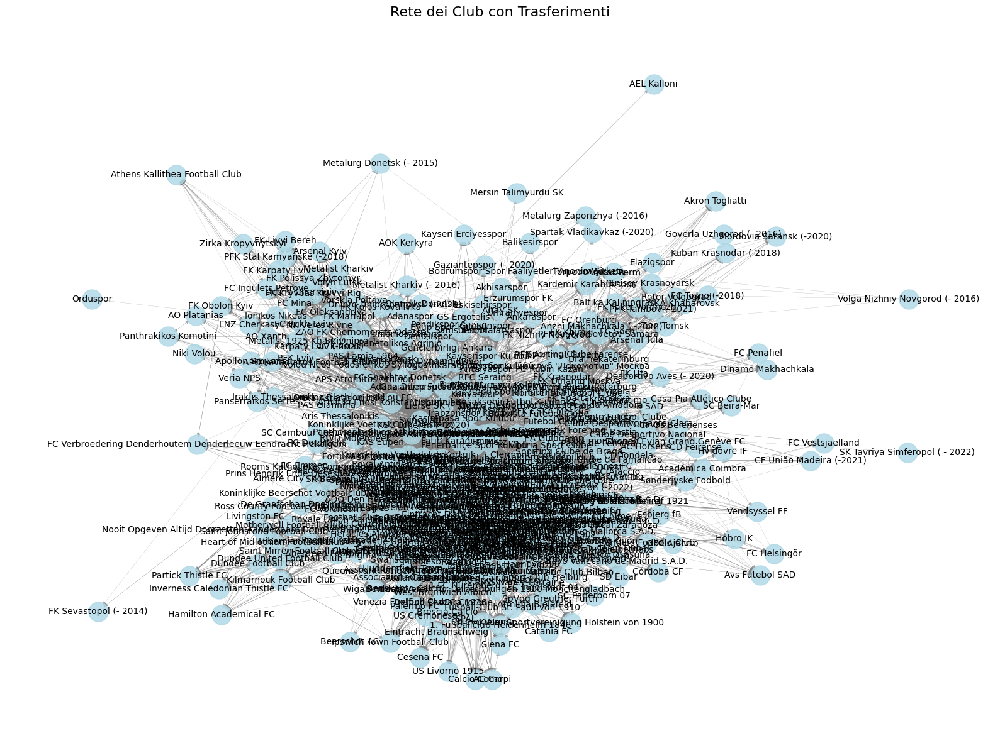


=== Fine della visualizzazione del grafo ===


In [10]:
# ------------------------------------------------------
# 6. VISUALIZZAZIONE DEL GRAFO
# ------------------------------------------------------
print("\n=== 6. Visualizzazione del grafo ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G, seed=42, k=0.5, iterations=200)

# Disegnare i nodi
nx.draw_networkx_nodes(G, pos, node_size=500, node_color='lightblue', alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G, 'weight').items())
nx.draw_networkx_edges(G, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare le etichette dei nodi (nomi dei club)
nx.draw_networkx_labels(G, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei Club con Trasferimenti", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo ===")

In [11]:
calculate_and_print_graph_metrics(G)


=== Metriche del grafo ===
Numero di nodi: 439
Numero di archi: 13183
Densità del grafo: 0.069
Clustering medio: 0.38
Raggio del grafo: None
Diametro del grafo: None
Grado dei nodi: {'Svincolati': 550, 'Verein für Bewegungsspiele Stuttgart 1893': 107, 'FC Bayern München': 97, '1. Fußball- und Sportverein Mainz 05': 103, 'Società Sportiva Lazio S.p.A.': 109, 'US Salernitana 1919': 81, 'APO Levadiakos Football Club': 25, 'Panathinaikos Athlitikos Omilos': 95, 'Inverness Caledonian Thistle FC': 21, 'Dundee United Football Club': 34, 'Sport Lisboa e Benfica': 201, 'Beşiktaş Jimnastik Kulübü': 128, 'Brøndby Idrætsforening': 56, 'FK Rostov': 86, 'Fußball-Club Augsburg 1907': 93, 'Stade brestois 29': 73, 'Associazione Calcio Fiorentina': 133, 'Fenerbahçe Spor Kulübü': 147, 'Associazione Calcio Monza': 52, 'Juventus Football Club': 138, 'Association sportive de Monaco Football Club': 152, 'Galatasaray Spor Kulübü': 160, 'Aalborg Boldspilklub': 42, 'Borussia Verein für Leibesübungen 1900 Mönch


=== 7. Filtraggio dei trasferimenti nel campionato italiano ===

Numero di club italiani: 38
ID dei club italiani: [  12 1025  410  458   46]

Numero di trasferimenti avvenuti tra club italiani: 2082
    player_id transfer_date transfer_season  from_club_id  to_club_id  \
2      626913    2026-06-30           25/26           398         380   
17     301238    2025-07-01           25/26          2919         506   
21     486031    2025-07-01           25/26           430         506   
31      88682    2025-06-30           24/25           749         506   
32      88706    2025-06-30           24/25          1038        8970   

   from_club_name to_club_name  transfer_fee  market_value_in_eur  \
2           Lazio  Salernitana           0.0           15000000.0   
17          Monza     Juventus    14300000.0           18000000.0   
21     Fiorentina     Juventus    28100000.0           35000000.0   
31      FC Empoli     Juventus           0.0            1000000.0   
32      Sampdor

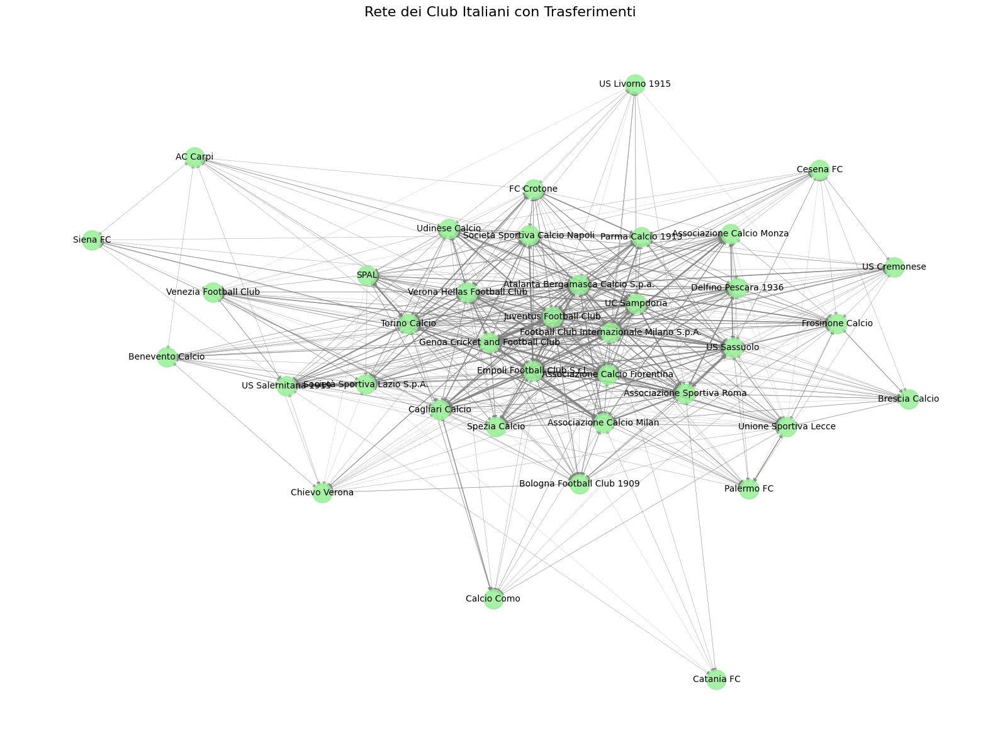


=== Fine della visualizzazione del grafo dei trasferimenti italiani ===

=== Metriche del grafo ===
Numero di nodi: 38
Numero di archi: 784
Densità del grafo: 0.558
Clustering medio: 0.719
Raggio del grafo: 2
Diametro del grafo: 2
Grado dei nodi: {'Società Sportiva Lazio S.p.A.': 46, 'US Salernitana 1919': 46, 'Associazione Calcio Monza': 41, 'Juventus Football Club': 62, 'Associazione Calcio Fiorentina': 54, 'Empoli Football Club S.r.l.': 56, 'UC Sampdoria': 51, 'Frosinone Calcio': 44, 'Calcio Como': 20, 'Genoa Cricket and Football Club': 58, 'Atalanta Bergamasca Calcio S.p.a.': 60, 'Unione Sportiva Lecce': 44, 'Bologna Football Club 1909': 40, 'Verona Hellas Football Club': 55, 'US Sassuolo': 52, 'Associazione Calcio Milan': 55, 'Associazione Sportiva Roma': 46, 'Cagliari Calcio': 44, 'Società Sportiva Calcio Napoli': 49, 'Torino Calcio': 57, 'Spezia Calcio': 40, 'Palermo FC': 28, 'Venezia Football Club': 33, 'Udinese Calcio': 49, 'Football Club Internazionale Milano S.p.A.': 65, 'P

In [12]:
# ------------------------------------------------------
# 7. FILTRARE I CLUB ITALIANI E I TRASFERIMENTI ITALIANI
# ------------------------------------------------------

print("\n=== 7. Filtraggio dei trasferimenti nel campionato italiano ===")

# Filtriamo i club italiani (domestic_competition_id == 'IT1')
italian_clubs = clubs[clubs["domestic_competition_id"] == "IT1"]
italian_club_ids = italian_clubs["club_id"].unique()

print(f"\nNumero di club italiani: {len(italian_clubs)}")
print(f"ID dei club italiani: {italian_club_ids[:5]}")  # Mostriamo i primi 5 club

# Filtriamo i trasferimenti che coinvolgono solo club italiani
italian_transfers = transfers[
    (transfers["from_club_id"].isin(italian_club_ids)) &
    (transfers["to_club_id"].isin(italian_club_ids))
]

print(f"\nNumero di trasferimenti avvenuti tra club italiani: {len(italian_transfers)}")
print(italian_transfers.head())

# ------------------------------------------------------
# 8. CREAZIONE DEL GRAFO CON I TRASFERIMENTI ITALIANI
# ------------------------------------------------------
print("\n=== 8. Creazione del grafo per i trasferimenti italiani ===")

# Creiamo un grafo per i trasferimenti italiani
G_italian = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti italiani
for idx, row in italian_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    if G_italian.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti)
        G_italian[from_club][to_club]["weight"] += 1
        G_italian[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
    else:
        # Aggiungi l'arco con peso 1
        G_italian.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))

print(f"\nNumero di nodi (club italiani) nel grafo: {G_italian.number_of_nodes()}")
print(f"Numero di archi (trasferimenti italiani) nel grafo: {G_italian.number_of_edges()}")

# ------------------------------------------------------
# 9. RILABEL DEI NODI CON I NOMI DEI CLUB ITALIANI
# ------------------------------------------------------
print("\n=== 9. Rilabel dei nodi con i nomi dei club italiani ===")

# Rilabel dei nodi nel grafo con i nomi dei club italiani
nx.relabel_nodes(G_italian, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_italian.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")

# ------------------------------------------------------
# 10. VISUALIZZAZIONE DEL GRAFO DEI TRASFERIMENTI ITALIANI
# ------------------------------------------------------
print("\n=== 10. Visualizzazione del grafo dei trasferimenti italiani ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G_italian, seed=42, k=0.5, iterations=200)

# Disegnare i nodi
nx.draw_networkx_nodes(G_italian, pos, node_size=500, node_color='lightgreen', alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G_italian, 'weight').items())
nx.draw_networkx_edges(G_italian, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare le etichette dei nodi (nomi dei club italiani)
nx.draw_networkx_labels(G_italian, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei Club Italiani con Trasferimenti", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo dei trasferimenti italiani ===")

calculate_and_print_graph_metrics(G_italian)

In [13]:
# ------------------------------------------------------
# 7 FILTRARE I TRASFERIMENTI TRA CLUB ITALIANI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 7 Filtraggio dei trasferimenti tra club italiani e Svincolati ===")

# Filtriamo i club italiani (domestic_competition_id == 'IT1')
italian_clubs = clubs[clubs["domestic_competition_id"] == "IT1"]
italian_club_ids = italian_clubs["club_id"].unique()

print(f"\nNumero di club italiani: {len(italian_clubs)}")
print(f"ID dei club italiani: {italian_club_ids[:5]}")  # Mostriamo i primi 5 club

# Filtriamo i trasferimenti che coinvolgono:
# - trasferimenti tra club italiani
# - trasferimenti tra un club italiano e "Svincolati" (515)
italian_svincolati_transfers = transfers[
    ((transfers["from_club_id"].isin(italian_club_ids)) & (transfers["to_club_id"] == 515)) | 
    ((transfers["to_club_id"].isin(italian_club_ids)) & (transfers["from_club_id"] == 515)) |
    ((transfers["from_club_id"].isin(italian_club_ids)) & (transfers["to_club_id"].isin(italian_club_ids)))
]

print(f"\nNumero di trasferimenti che coinvolgono club italiani e svincolati: {len(italian_svincolati_transfers)}")
print(italian_svincolati_transfers.head())


=== 7 Filtraggio dei trasferimenti tra club italiani e Svincolati ===

Numero di club italiani: 38
ID dei club italiani: [  12 1025  410  458   46]

Numero di trasferimenti che coinvolgono club italiani e svincolati: 2162
    player_id transfer_date transfer_season  from_club_id  to_club_id  \
2      626913    2026-06-30           25/26           398         380   
17     301238    2025-07-01           25/26          2919         506   
21     486031    2025-07-01           25/26           430         506   
31      88682    2025-06-30           24/25           749         506   
32      88706    2025-06-30           24/25          1038        8970   

   from_club_name to_club_name  transfer_fee  market_value_in_eur  \
2           Lazio  Salernitana           0.0           15000000.0   
17          Monza     Juventus    14300000.0           18000000.0   
21     Fiorentina     Juventus    28100000.0           35000000.0   
31      FC Empoli     Juventus           0.0            100000

In [14]:
# ------------------------------------------------------
# 8. CREAZIONE DEL GRAFO CON I TRASFERIMENTI ITALIANI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 8. Creazione del grafo per i trasferimenti italiani e svincolati ===")

# Creiamo un grafo per i trasferimenti italiani e svincolati
G_italian_svincolati = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti italiani e svincolati
for idx, row in italian_svincolati_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    # Se il club di origine o destinazione è 515 (svincolati), lo sostituiamo con "Svincolati"
    if from_club == 515:
        from_club = "Svincolati"
    if to_club == 515:
        to_club = "Svincolati"

    if G_italian_svincolati.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti)
        G_italian_svincolati[from_club][to_club]["weight"] += 1
        G_italian_svincolati[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
    else:
        # Aggiungi l'arco con peso 1
        G_italian_svincolati.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))

print(f"\nNumero di nodi (club italiani e svincolati) nel grafo: {G_italian_svincolati.number_of_nodes()}")
print(f"Numero di archi (trasferimenti italiani e svincolati) nel grafo: {G_italian_svincolati.number_of_edges()}")


=== 8. Creazione del grafo per i trasferimenti italiani e svincolati ===

Numero di nodi (club italiani e svincolati) nel grafo: 39
Numero di archi (trasferimenti italiani e svincolati) nel grafo: 823


In [15]:
# ------------------------------------------------------
# 9. RILABEL DEI NODI CON I NOMI DEI CLUB ITALIANI
# ------------------------------------------------------

print("\n=== 9. Rilabel dei nodi con i nomi dei club italiani e svincolati ===")

# Rilabel dei nodi nel grafo con i nomi dei club italiani (compreso "Svincolati")
nx.relabel_nodes(G_italian_svincolati, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_italian_svincolati.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")


=== 9. Rilabel dei nodi con i nomi dei club italiani e svincolati ===

Esempio di nodi con nome (primi 5):
Svincolati -> {}
Società Sportiva Lazio S.p.A. -> {}
US Salernitana 1919 -> {}
Associazione Calcio Monza -> {}
Juventus Football Club -> {}



=== 10. Visualizzazione del grafo dei trasferimenti italiani e svincolati ===


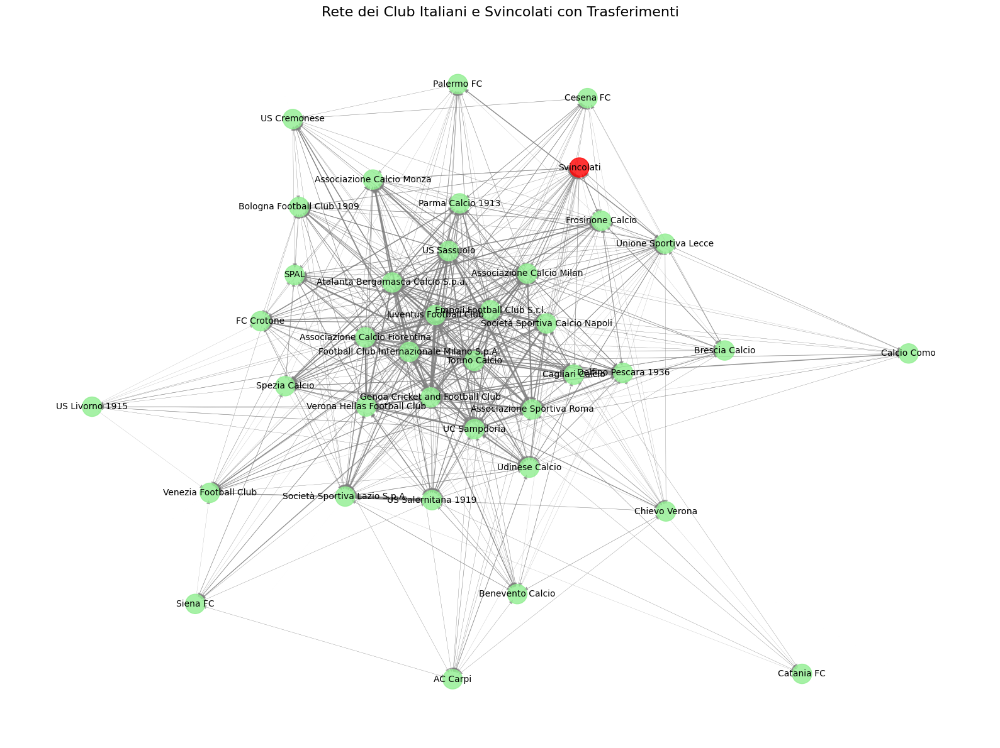


=== Fine della visualizzazione del grafo dei trasferimenti italiani e svincolati ===

=== Metriche del grafo ===
Numero di nodi: 39
Numero di archi: 823
Densità del grafo: 0.555
Clustering medio: 0.725
Raggio del grafo: 2
Diametro del grafo: 2
Grado dei nodi: {'Svincolati': 39, 'Società Sportiva Lazio S.p.A.': 47, 'US Salernitana 1919': 48, 'Associazione Calcio Monza': 43, 'Juventus Football Club': 63, 'Associazione Calcio Fiorentina': 56, 'Empoli Football Club S.r.l.': 57, 'UC Sampdoria': 53, 'Frosinone Calcio': 46, 'Calcio Como': 20, 'Genoa Cricket and Football Club': 60, 'Atalanta Bergamasca Calcio S.p.a.': 60, 'Unione Sportiva Lecce': 46, 'Bologna Football Club 1909': 42, 'Verona Hellas Football Club': 57, 'US Sassuolo': 53, 'Associazione Calcio Milan': 57, 'Associazione Sportiva Roma': 48, 'Cagliari Calcio': 46, 'Società Sportiva Calcio Napoli': 50, 'Torino Calcio': 58, 'Spezia Calcio': 41, 'Palermo FC': 28, 'Venezia Football Club': 33, 'Udinese Calcio': 51, 'Football Club Intern

In [16]:
# ------------------------------------------------------
# 10. VISUALIZZAZIONE DEL GRAFO DEI TRASFERIMENTI ITALIANI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 10. Visualizzazione del grafo dei trasferimenti italiani e svincolati ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G_italian_svincolati, seed=42, k=0.5, iterations=200)

node_colors = ['lightgreen' if node != "Svincolati" else 'red' for node in G_italian_svincolati.nodes()]
# Disegnare i nodi
nx.draw_networkx_nodes(G_italian_svincolati, pos, node_size=500, node_color=node_colors, alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G_italian_svincolati, 'weight').items())
nx.draw_networkx_edges(G_italian_svincolati, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare le etichette dei nodi (nomi dei club italiani e svincolati)
nx.draw_networkx_labels(G_italian_svincolati, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei Club Italiani e Svincolati con Trasferimenti", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo dei trasferimenti italiani e svincolati ===")

calculate_and_print_graph_metrics(G_italian_svincolati)

In [17]:
# ------------------------------------------------------
# 7. FILTRARE I CLUB INGLESI E I TRASFERIMENTI INGLESI
# ------------------------------------------------------

print("\n=== 7. Filtraggio dei trasferimenti nel campionato inglese ===")

# Filtriamo i club inglesi (domestic_competition_id == 'GB1')
english_clubs = clubs[clubs["domestic_competition_id"] == "GB1"]
english_club_ids = english_clubs["club_id"].unique()

print(f"\nNumero di club inglesi: {len(english_clubs)}")
print(f"ID dei club inglesi: {english_club_ids[:5]}")  # Mostriamo i primi 5 club

# Filtriamo i trasferimenti che coinvolgono solo club inglesi
english_transfers = transfers[
    (transfers["from_club_id"].isin(english_club_ids)) &
    (transfers["to_club_id"].isin(english_club_ids))
]

print(f"\nNumero di trasferimenti avvenuti tra club inglesi: {len(english_transfers)}")
print(english_transfers.head())


=== 7. Filtraggio dei trasferimenti nel campionato inglese ===

Numero di club inglesi: 37
ID dei club inglesi: [ 148  603  989 3008   31]

Numero di trasferimenti avvenuti tra club inglesi: 1244
     player_id transfer_date transfer_season  from_club_id  to_club_id  \
33      111819    2025-06-30           24/25            11         989   
50      181579    2025-06-30           24/25           703         379   
65      234781    2025-06-30           24/25           180         379   
119     340325    2025-06-30           24/25           931          11   
124     344152    2025-06-30           24/25          1003         873   

    from_club_name    to_club_name  transfer_fee  market_value_in_eur  \
33         Arsenal     Bournemouth           0.0            2000000.0   
50    Nottm Forest        West Ham           0.0           16000000.0   
65     Southampton        West Ham           0.0            8000000.0   
119         Fulham         Arsenal           0.0           1800000

In [18]:
# ------------------------------------------------------
# 8. CREAZIONE DEL GRAFO CON I TRASFERIMENTI INGLESI
# ------------------------------------------------------
print("\n=== 8. Creazione del grafo per i trasferimenti inglesi ===")

# Creiamo un grafo per i trasferimenti inglesi
G_english = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti inglesi
for idx, row in english_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    if G_english.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti)
        G_english[from_club][to_club]["weight"] += 1
        G_english[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
    else:
        # Aggiungi l'arco con peso 1
        G_english.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))

print(f"\nNumero di nodi (club inglesi) nel grafo: {G_english.number_of_nodes()}")
print(f"Numero di archi (trasferimenti inglesi) nel grafo: {G_english.number_of_edges()}")


=== 8. Creazione del grafo per i trasferimenti inglesi ===

Numero di nodi (club inglesi) nel grafo: 37
Numero di archi (trasferimenti inglesi) nel grafo: 701


In [19]:
# ------------------------------------------------------
# 9. RILABEL DEI NODI CON I NOMI DEI CLUB INGLESI
# ------------------------------------------------------
print("\n=== 9. Rilabel dei nodi con i nomi dei club inglesi ===")

# Rilabel dei nodi nel grafo con i nomi dei club inglesi
nx.relabel_nodes(G_english, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_english.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")


=== 9. Rilabel dei nodi con i nomi dei club inglesi ===

Esempio di nodi con nome (primi 5):
Arsenal Football Club -> {}
Association Football Club Bournemouth -> {}
Nottingham Forest Football Club -> {}
West Ham United Football Club -> {}
Southampton Football Club -> {}



=== 10. Visualizzazione del grafo dei trasferimenti inglesi ===


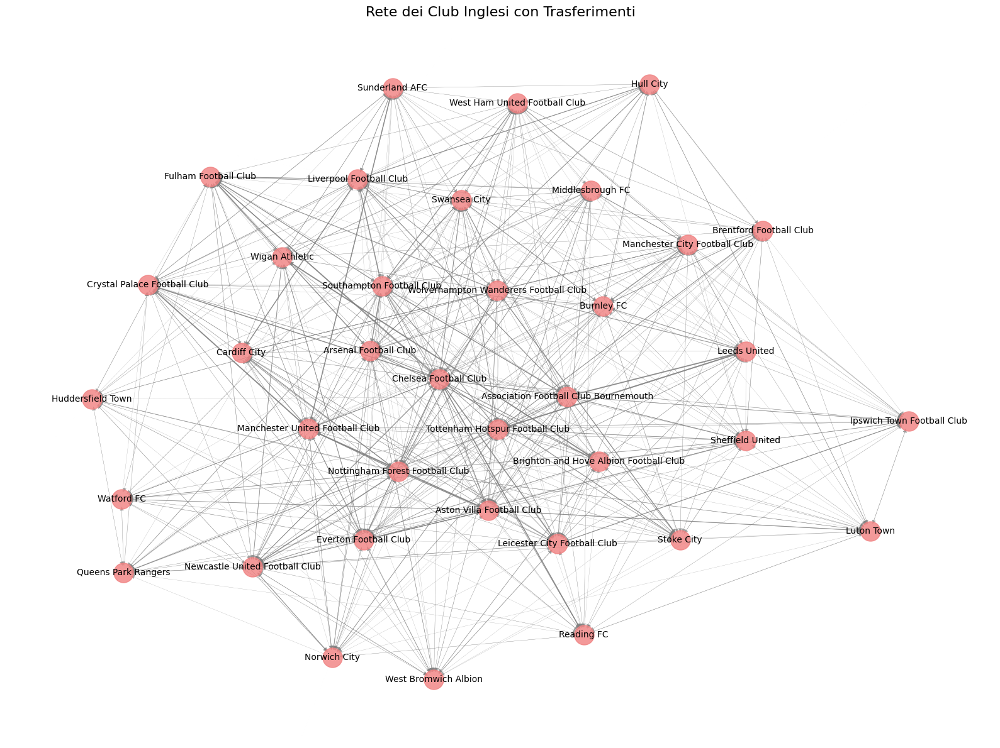


=== Fine della visualizzazione del grafo dei trasferimenti inglesi ===

=== Metriche del grafo ===
Numero di nodi: 37
Numero di archi: 701
Densità del grafo: 0.526
Clustering medio: 0.651
Raggio del grafo: 2
Diametro del grafo: 2
Grado dei nodi: {'Arsenal Football Club': 50, 'Association Football Club Bournemouth': 42, 'Nottingham Forest Football Club': 41, 'West Ham United Football Club': 43, 'Southampton Football Club': 41, 'Fulham Football Club': 39, 'Leicester City Football Club': 49, 'Crystal Palace Football Club': 37, 'Ipswich Town Football Club': 29, 'Manchester City Football Club': 38, 'Chelsea Football Club': 54, 'Manchester United Football Club': 46, 'Everton Football Club': 47, 'Leeds United': 32, 'Brighton and Hove Albion Football Club': 39, 'Aston Villa Football Club': 49, 'Wigan Athletic': 34, 'Liverpool Football Club': 42, 'Wolverhampton Wanderers Football Club': 46, 'Newcastle United Football Club': 43, 'Luton Town': 29, 'Burnley FC': 33, 'Sunderland AFC': 30, 'Queens 

In [20]:
# ------------------------------------------------------
# 10. VISUALIZZAZIONE DEL GRAFO DEI TRASFERIMENTI INGLESI
# ------------------------------------------------------
print("\n=== 10. Visualizzazione del grafo dei trasferimenti inglesi ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G_english, seed=42, k=0.5, iterations=200)

# Disegnare i nodi
nx.draw_networkx_nodes(G_english, pos, node_size=500, node_color='lightcoral', alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G_english, 'weight').items())
nx.draw_networkx_edges(G_english, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare le etichette dei nodi (nomi dei club inglesi)
nx.draw_networkx_labels(G_english, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei Club Inglesi con Trasferimenti", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo dei trasferimenti inglesi ===")

calculate_and_print_graph_metrics(G_english)


=== 7 Filtraggio dei trasferimenti tra club inglesi e Svincolati ===

Numero di club inglesi: 37
ID dei club inglesi: [ 148  603  989 3008   31]

Numero di trasferimenti che coinvolgono club inglesi e svincolati: 1336
     player_id transfer_date transfer_season  from_club_id  to_club_id  \
33      111819    2025-06-30           24/25            11         989   
50      181579    2025-06-30           24/25           703         379   
65      234781    2025-06-30           24/25           180         379   
119     340325    2025-06-30           24/25           931          11   
124     344152    2025-06-30           24/25          1003         873   

    from_club_name    to_club_name  transfer_fee  market_value_in_eur  \
33         Arsenal     Bournemouth           0.0            2000000.0   
50    Nottm Forest        West Ham           0.0           16000000.0   
65     Southampton        West Ham           0.0            8000000.0   
119         Fulham         Arsenal          

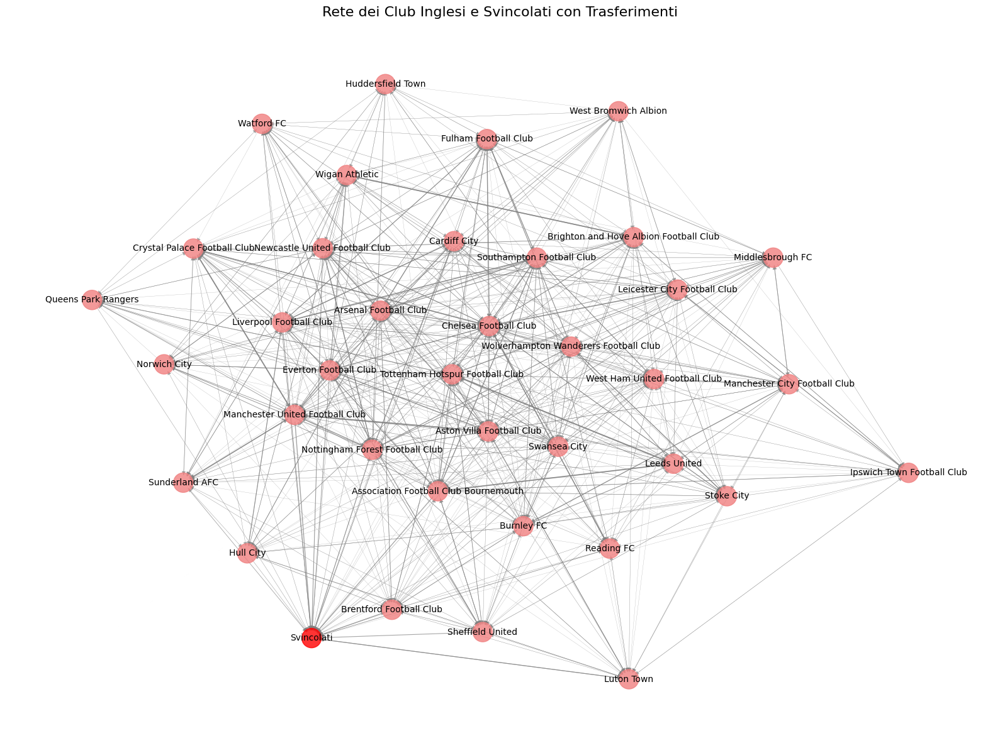


=== Fine della visualizzazione del grafo dei trasferimenti inglesi e svincolati ===

=== Metriche del grafo ===
Numero di nodi: 38
Numero di archi: 746
Densità del grafo: 0.531
Clustering medio: 0.672
Raggio del grafo: 2
Diametro del grafo: 2
Grado dei nodi: {'Svincolati': 45, 'Arsenal Football Club': 51, 'Association Football Club Bournemouth': 43, 'Nottingham Forest Football Club': 43, 'West Ham United Football Club': 44, 'Southampton Football Club': 42, 'Fulham Football Club': 40, 'Leicester City Football Club': 50, 'Crystal Palace Football Club': 38, 'Ipswich Town Football Club': 30, 'Manchester City Football Club': 38, 'Chelsea Football Club': 55, 'Manchester United Football Club': 47, 'Everton Football Club': 48, 'Leeds United': 33, 'Brighton and Hove Albion Football Club': 40, 'Aston Villa Football Club': 50, 'Wigan Athletic': 36, 'Liverpool Football Club': 43, 'Wolverhampton Wanderers Football Club': 47, 'Newcastle United Football Club': 45, 'Luton Town': 31, 'Burnley FC': 34,

In [21]:
# ------------------------------------------------------
# 7 FILTRARE I TRASFERIMENTI TRA CLUB INGLESI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 7 Filtraggio dei trasferimenti tra club inglesi e Svincolati ===")

# Filtriamo i club inglesi (domestic_competition_id == 'GB1')
english_clubs = clubs[clubs["domestic_competition_id"] == "GB1"]
english_club_ids = english_clubs["club_id"].unique()

print(f"\nNumero di club inglesi: {len(english_clubs)}")
print(f"ID dei club inglesi: {english_club_ids[:5]}")  # Mostriamo i primi 5 club

# Filtriamo i trasferimenti che coinvolgono:
# - trasferimenti tra club inglesi
# - trasferimenti tra un club inglese e "Svincolati" (515)
english_svincolati_transfers = transfers[
    ((transfers["from_club_id"].isin(english_club_ids)) & (transfers["to_club_id"] == 515)) | 
    ((transfers["to_club_id"].isin(english_club_ids)) & (transfers["from_club_id"] == 515)) |
    ((transfers["from_club_id"].isin(english_club_ids)) & (transfers["to_club_id"].isin(english_club_ids)))
]

print(f"\nNumero di trasferimenti che coinvolgono club inglesi e svincolati: {len(english_svincolati_transfers)}")
print(english_svincolati_transfers.head())

# ------------------------------------------------------
# 8. CREAZIONE DEL GRAFO CON I TRASFERIMENTI INGLESI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 8. Creazione del grafo per i trasferimenti inglesi e svincolati ===")

# Creiamo un grafo per i trasferimenti inglesi e svincolati
G_english_svincolati = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti inglesi e svincolati
for idx, row in english_svincolati_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    # Se il club di origine o destinazione è 515 (svincolati), lo sostituiamo con "Svincolati"
    if from_club == 515:
        from_club = "Svincolati"
    if to_club == 515:
        to_club = "Svincolati"

    if G_english_svincolati.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti)
        G_english_svincolati[from_club][to_club]["weight"] += 1
        G_english_svincolati[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
    else:
        # Aggiungi l'arco con peso 1
        G_english_svincolati.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))

print(f"\nNumero di nodi (club inglesi e svincolati) nel grafo: {G_english_svincolati.number_of_nodes()}")
print(f"Numero di archi (trasferimenti inglesi e svincolati) nel grafo: {G_english_svincolati.number_of_edges()}")

# ------------------------------------------------------
# 9. RILABEL DEI NODI CON I NOMI DEI CLUB INGLESI
# ------------------------------------------------------

print("\n=== 9. Rilabel dei nodi con i nomi dei club inglesi e svincolati ===")

# Rilabel dei nodi nel grafo con i nomi dei club inglesi (compreso "Svincolati")
nx.relabel_nodes(G_english_svincolati, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_english_svincolati.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")

# ------------------------------------------------------
# 10. VISUALIZZAZIONE DEL GRAFO DEI TRASFERIMENTI INGLESI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 10. Visualizzazione del grafo dei trasferimenti inglesi e svincolati ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G_english_svincolati, seed=42, k=0.5, iterations=200)

# Disegnare i nodi, evidenziando il nodo "Svincolati"
# Nodo "Svincolati" in un colore specifico
node_colors = ['lightcoral' if node != "Svincolati" else 'red' for node in G_english_svincolati.nodes()]

# Disegnare i nodi
nx.draw_networkx_nodes(G_english_svincolati, pos, node_size=500, node_color=node_colors, alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G_english_svincolati, 'weight').items())
nx.draw_networkx_edges(G_english_svincolati, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare le etichette dei nodi (nomi dei club inglesi e svincolati)
nx.draw_networkx_labels(G_english_svincolati, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei Club Inglesi e Svincolati con Trasferimenti", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo dei trasferimenti inglesi e svincolati ===")

calculate_and_print_graph_metrics(G_english_svincolati)

In [22]:
# ------------------------------------------------------
# 7. FILTRARE I CLUB SPAGNOLI E I TRASFERIMENTI SPAGNOLI
# ------------------------------------------------------

print("\n=== 7. Filtraggio dei trasferimenti nel campionato spagnolo ===")

# Filtriamo i club spagnoli (domestic_competition_id == 'ES1')
spanish_clubs = clubs[clubs["domestic_competition_id"] == "ES1"]
spanish_club_ids = spanish_clubs["club_id"].unique()

print(f"\nNumero di club spagnoli: {len(spanish_clubs)}")
print(f"ID dei club spagnoli: {spanish_club_ids[:5]}")  # Mostriamo i primi 5 club

# Filtriamo i trasferimenti che coinvolgono solo club spagnoli
spanish_transfers = transfers[
    (transfers["from_club_id"].isin(spanish_club_ids)) &
    (transfers["to_club_id"].isin(spanish_club_ids))
]

print(f"\nNumero di trasferimenti avvenuti tra club spagnoli: {len(spanish_transfers)}")
print(spanish_transfers.head())


=== 7. Filtraggio dei trasferimenti nel campionato spagnolo ===

Numero di club spagnoli: 32
ID dei club spagnoli: [5358  993 1108   13  131]

Numero di trasferimenti avvenuti tra club spagnoli: 1070
    player_id transfer_date transfer_season  from_club_id  to_club_id  \
28      66100    2025-06-30           24/25         12321         131   
39     148928    2025-06-30           24/25           368          13   
47     177847    2025-06-30           24/25           472         368   
51     182904    2025-06-30           24/25            13         131   
79     263727    2025-06-30           24/25          1108         368   

     from_club_name     to_club_name  transfer_fee  market_value_in_eur  \
28           Girona        Barcelona           0.0            2000000.0   
39       Sevilla FC  Atlético Madrid           0.0            5000000.0   
47    UD Las Palmas       Sevilla FC           0.0            2000000.0   
51  Atlético Madrid        Barcelona           0.0          

In [23]:
# ------------------------------------------------------
# 8. CREAZIONE DEL GRAFO CON I TRASFERIMENTI SPAGNOLI
# ------------------------------------------------------
print("\n=== 8. Creazione del grafo per i trasferimenti spagnoli ===")

# Creiamo un grafo per i trasferimenti spagnoli
G_spanish = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti spagnoli
for idx, row in spanish_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    if G_spanish.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti)
        G_spanish[from_club][to_club]["weight"] += 1
        G_spanish[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
    else:
        # Aggiungi l'arco con peso 1
        G_spanish.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))

print(f"\nNumero di nodi (club spagnoli) nel grafo: {G_spanish.number_of_nodes()}")
print(f"Numero di archi (trasferimenti spagnoli) nel grafo: {G_spanish.number_of_edges()}")



=== 8. Creazione del grafo per i trasferimenti spagnoli ===

Numero di nodi (club spagnoli) nel grafo: 32
Numero di archi (trasferimenti spagnoli) nel grafo: 519



=== 9. Rilabel dei nodi con i nomi dei club spagnoli ===

Esempio di nodi con nome (primi 5):
Girona Fútbol Club S. A. D. -> {}
Futbol Club Barcelona -> {}
Sevilla Fútbol Club S.A.D. -> {}
Club Atlético de Madrid S.A.D. -> {}
Unión Deportiva Las Palmas S.A.D. -> {}

=== 10. Visualizzazione del grafo dei trasferimenti spagnoli ===


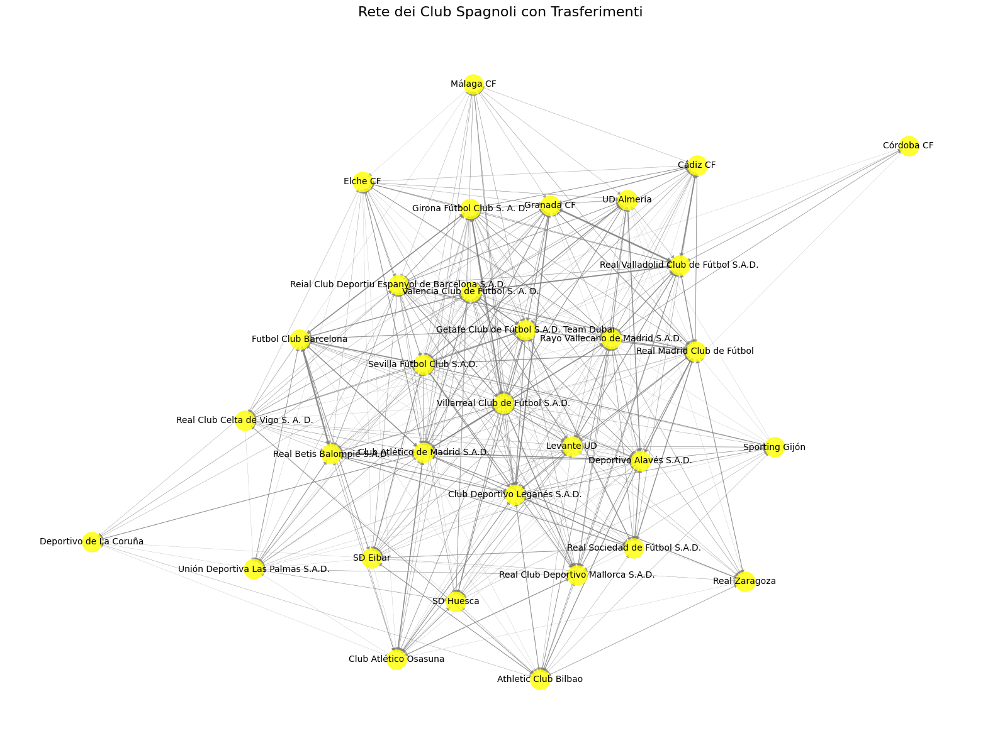


=== Fine della visualizzazione del grafo dei trasferimenti spagnoli ===

=== Metriche del grafo ===
Numero di nodi: 32
Numero di archi: 519
Densità del grafo: 0.523
Clustering medio: 0.668
Raggio del grafo: 2
Diametro del grafo: 3
Grado dei nodi: {'Girona Fútbol Club S. A. D.': 40, 'Futbol Club Barcelona': 31, 'Sevilla Fútbol Club S.A.D.': 42, 'Club Atlético de Madrid S.A.D.': 46, 'Unión Deportiva Las Palmas S.A.D.': 27, 'Deportivo Alavés S.A.D.': 41, 'Rayo Vallecano de Madrid S.A.D.': 41, 'Granada CF': 35, 'Real Club Celta de Vigo S. A. D.': 30, 'Real Betis Balompié S.A.D.': 30, 'Getafe Club de Fútbol S.A.D. Team Dubai': 42, 'UD Almería': 31, 'Real Valladolid Club de Fútbol S.A.D.': 30, 'Valencia Club de Fútbol S. A. D.': 37, 'Real Club Deportivo Mallorca S.A.D.': 34, 'Athletic Club Bilbao': 28, 'Villarreal Club de Fútbol S.A.D.': 44, 'Levante UD': 39, 'Club Deportivo Leganés S.A.D.': 41, 'SD Eibar': 32, 'Reial Club Deportiu Espanyol de Barcelona S.A.D.': 44, 'Real Madrid Club de Fút

In [24]:
# ------------------------------------------------------
# 9. RILABEL DEI NODI CON I NOMI DEI CLUB SPAGNOLI
# ------------------------------------------------------
print("\n=== 9. Rilabel dei nodi con i nomi dei club spagnoli ===")

# Rilabel dei nodi nel grafo con i nomi dei club spagnoli
nx.relabel_nodes(G_spanish, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_spanish.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")

# ------------------------------------------------------
# 10. VISUALIZZAZIONE DEL GRAFO DEI TRASFERIMENTI SPAGNOLI
# ------------------------------------------------------
print("\n=== 10. Visualizzazione del grafo dei trasferimenti spagnoli ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G_spanish, seed=42, k=0.5, iterations=200)

# Disegnare i nodi
nx.draw_networkx_nodes(G_spanish, pos, node_size=500, node_color='yellow', alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G_spanish, 'weight').items())
nx.draw_networkx_edges(G_spanish, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare le etichette dei nodi (nomi dei club spagnoli)
nx.draw_networkx_labels(G_spanish, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei Club Spagnoli con Trasferimenti", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo dei trasferimenti spagnoli ===")

calculate_and_print_graph_metrics(G_spanish)


=== 7 Filtraggio dei trasferimenti tra club spagnoli e Svincolati ===

Numero di club spagnoli: 32
ID dei club spagnoli: [5358  993 1108   13  131]

Numero di trasferimenti che coinvolgono club spagnoli e svincolati: 1123
    player_id transfer_date transfer_season  from_club_id  to_club_id  \
28      66100    2025-06-30           24/25         12321         131   
39     148928    2025-06-30           24/25           368          13   
47     177847    2025-06-30           24/25           472         368   
51     182904    2025-06-30           24/25            13         131   
79     263727    2025-06-30           24/25          1108         368   

     from_club_name     to_club_name  transfer_fee  market_value_in_eur  \
28           Girona        Barcelona           0.0            2000000.0   
39       Sevilla FC  Atlético Madrid           0.0            5000000.0   
47    UD Las Palmas       Sevilla FC           0.0            2000000.0   
51  Atlético Madrid        Barcelona  

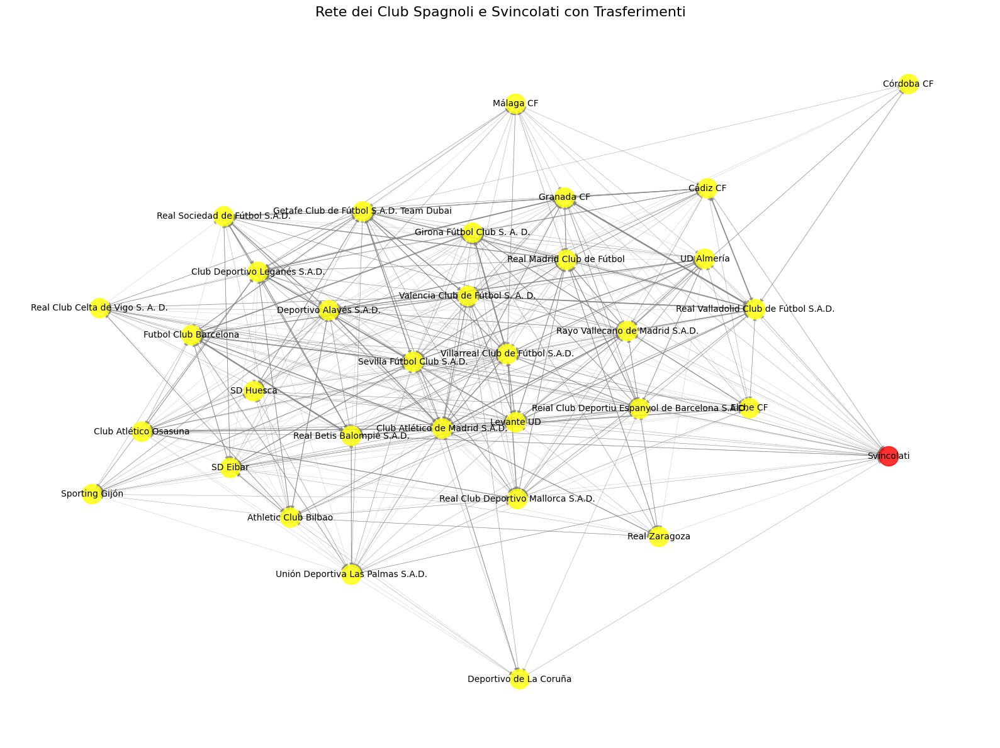


=== Fine della visualizzazione del grafo dei trasferimenti spagnoli e svincolati ===

=== Metriche del grafo ===
Numero di nodi: 33
Numero di archi: 552
Densità del grafo: 0.523
Clustering medio: 0.675
Raggio del grafo: 2
Diametro del grafo: 3
Grado dei nodi: {'Svincolati': 33, 'Girona Fútbol Club S. A. D.': 42, 'Futbol Club Barcelona': 31, 'Sevilla Fútbol Club S.A.D.': 43, 'Club Atlético de Madrid S.A.D.': 47, 'Unión Deportiva Las Palmas S.A.D.': 29, 'Deportivo Alavés S.A.D.': 41, 'Rayo Vallecano de Madrid S.A.D.': 43, 'Granada CF': 36, 'Real Club Celta de Vigo S. A. D.': 30, 'Real Betis Balompié S.A.D.': 32, 'Getafe Club de Fútbol S.A.D. Team Dubai': 43, 'UD Almería': 33, 'Real Valladolid Club de Fútbol S.A.D.': 32, 'Valencia Club de Fútbol S. A. D.': 38, 'Real Club Deportivo Mallorca S.A.D.': 35, 'Athletic Club Bilbao': 29, 'Villarreal Club de Fútbol S.A.D.': 46, 'Levante UD': 40, 'Club Deportivo Leganés S.A.D.': 42, 'SD Eibar': 32, 'Reial Club Deportiu Espanyol de Barcelona S.A.D.

In [25]:
# ------------------------------------------------------
# 7 FILTRARE I TRASFERIMENTI TRA CLUB SPAGNOLI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 7 Filtraggio dei trasferimenti tra club spagnoli e Svincolati ===")

# Filtriamo i club spagnoli (domestic_competition_id == 'ES1')
spanish_clubs = clubs[clubs["domestic_competition_id"] == "ES1"]
spanish_club_ids = spanish_clubs["club_id"].unique()

print(f"\nNumero di club spagnoli: {len(spanish_clubs)}")
print(f"ID dei club spagnoli: {spanish_club_ids[:5]}")  # Mostriamo i primi 5 club

# Filtriamo i trasferimenti che coinvolgono:
# - trasferimenti tra club spagnoli
# - trasferimenti tra un club spagnolo e "Svincolati" (515)
spanish_svincolati_transfers = transfers[
    ((transfers["from_club_id"].isin(spanish_club_ids)) & (transfers["to_club_id"] == 515)) | 
    ((transfers["to_club_id"].isin(spanish_club_ids)) & (transfers["from_club_id"] == 515)) |
    ((transfers["from_club_id"].isin(spanish_club_ids)) & (transfers["to_club_id"].isin(spanish_club_ids)))
]

print(f"\nNumero di trasferimenti che coinvolgono club spagnoli e svincolati: {len(spanish_svincolati_transfers)}")
print(spanish_svincolati_transfers.head())

# ------------------------------------------------------
# 8. CREAZIONE DEL GRAFO CON I TRASFERIMENTI SPAGNOLI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 8. Creazione del grafo per i trasferimenti spagnoli e svincolati ===")

# Creiamo un grafo per i trasferimenti spagnoli e svincolati
G_spanish_svincolati = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti spagnoli e svincolati
for idx, row in spanish_svincolati_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    # Se il club di origine o destinazione è 515 (svincolati), lo sostituiamo con "Svincolati"
    if from_club == 515:
        from_club = "Svincolati"
    if to_club == 515:
        to_club = "Svincolati"

    if G_spanish_svincolati.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti)
        G_spanish_svincolati[from_club][to_club]["weight"] += 1
        G_spanish_svincolati[from_club][to_club]["cost"] += row.get("transfer_fee", 0)
    else:
        # Aggiungi l'arco con peso 1
        G_spanish_svincolati.add_edge(from_club, to_club, weight=1, cost=row.get("transfer_fee", 0))

print(f"\nNumero di nodi (club spagnoli e svincolati) nel grafo: {G_spanish_svincolati.number_of_nodes()}")
print(f"Numero di archi (trasferimenti spagnoli e svincolati) nel grafo: {G_spanish_svincolati.number_of_edges()}")

# ------------------------------------------------------
# 9. RILABEL DEI NODI CON I NOMI DEI CLUB SPAGNOLI
# ------------------------------------------------------

print("\n=== 9. Rilabel dei nodi con i nomi dei club spagnoli e svincolati ===")

# Rilabel dei nodi nel grafo con i nomi dei club spagnoli (compreso "Svincolati")
nx.relabel_nodes(G_spanish_svincolati, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_spanish_svincolati.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")

# ------------------------------------------------------
# 10. VISUALIZZAZIONE DEL GRAFO DEI TRASFERIMENTI SPAGNOLI E SVINCOLATI
# ------------------------------------------------------

print("\n=== 10. Visualizzazione del grafo dei trasferimenti spagnoli e svincolati ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G_spanish_svincolati, seed=42, k=0.5, iterations=200)

# Disegnare i nodi, evidenziando il nodo "Svincolati"
# Nodo "Svincolati" in un colore specifico
node_colors = ['yellow' if node != "Svincolati" else 'red' for node in G_spanish_svincolati.nodes()]

# Disegnare i nodi
nx.draw_networkx_nodes(G_spanish_svincolati, pos, node_size=500, node_color=node_colors, alpha=0.8)

# Disegnare gli archi (pesati in base al numero di trasferimenti)
edges, weights = zip(*nx.get_edge_attributes(G_spanish_svincolati, 'weight').items())
nx.draw_networkx_edges(G_spanish_svincolati, pos, edgelist=edges, width=[w / 5 for w in weights], edge_color='gray', alpha=0.7)

# Disegnare le etichette dei nodi (nomi dei club spagnoli e svincolati)
nx.draw_networkx_labels(G_spanish_svincolati, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei Club Spagnoli e Svincolati con Trasferimenti", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione del grafo dei trasferimenti spagnoli e svincolati ===")

calculate_and_print_graph_metrics(G_spanish_svincolati)

In [26]:
# ------------------------------------------------------
# 11. VISUALIZZARE I TRASFERIMENTI PIÙ COSTOSI
# ------------------------------------------------------

print("\n=== 11. Visualizzazione dei trasferimenti più costosi ===")

# Definiamo una soglia per i trasferimenti più costosi (ad esempio, top 1% dei trasferimenti più costosi)
cost_threshold = transfers["transfer_fee"].quantile(0.99)  # Prendiamo l'1% dei trasferimenti più costosi

# Filtriamo i trasferimenti con costo maggiore della soglia
expensive_transfers = transfers[transfers["transfer_fee"] >= cost_threshold]

print(f"\nNumero di trasferimenti più costosi (oltre il {cost_threshold} di valore): {len(expensive_transfers)}")
print(expensive_transfers.head())

# Creiamo il grafo per i trasferimenti più costosi
G_expensive = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti più costosi
for idx, row in expensive_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    if G_expensive.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti) e aggiungi il costo
        G_expensive[from_club][to_club]["weight"] += 1
        G_expensive[from_club][to_club]["cost"] += row["transfer_fee"]
    else:
        # Aggiungi l'arco con peso 1
        G_expensive.add_edge(from_club, to_club, weight=1, cost=row["transfer_fee"])

print(f"\nNumero di nodi (club) nel grafo dei trasferimenti costosi: {G_expensive.number_of_nodes()}")
print(f"Numero di archi (trasferimenti costosi) nel grafo: {G_expensive.number_of_edges()}")


=== 11. Visualizzazione dei trasferimenti più costosi ===

Numero di trasferimenti più costosi (oltre il 24198999.999999434 di valore): 509
      player_id transfer_date transfer_season  from_club_id  to_club_id  \
21       486031    2025-07-01           25/26           430         506   
1132     315969    2024-08-30           24/25           985        6195   
1140     340324    2024-08-30           24/25            11         873   
1174     476701    2024-08-30           24/25           583         985   
1236      96341    2024-08-29           24/25           631        6195   

     from_club_name    to_club_name  transfer_fee  market_value_in_eur  \
21       Fiorentina        Juventus    28100000.0           35000000.0   
1132        Man Utd          Napoli    30500000.0           32000000.0   
1140        Arsenal  Crystal Palace    29700000.0           30000000.0   
1174       Paris SG         Man Utd    50000000.0           45000000.0   
1236        Chelsea          Napoli   

In [27]:
# ------------------------------------------------------
# 12. FILTRARE E RILABEL DEI NODI CON I NOMI DEI CLUB PER I TRASFERIMENTI COSTOSI
# ------------------------------------------------------

print("\n=== 12. Filtraggio e rilabel dei nodi con i nomi dei club per i trasferimenti costosi ===")

# Verifica che tutti i club_id nei trasferimenti esistano nel dizionario
valid_transfers = expensive_transfers[
    expensive_transfers["from_club_id"].isin(club_id_to_name.keys()) &
    expensive_transfers["to_club_id"].isin(club_id_to_name.keys())
]

print(f"\nNumero di trasferimenti validi (con club esistenti nel dizionario): {len(valid_transfers)}")

# Creiamo il grafo per i trasferimenti validi (solo club validi)
G_expensive_valid = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti validi
for idx, row in valid_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    
    if G_expensive_valid.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti) e aggiungi il costo
        G_expensive_valid[from_club][to_club]["weight"] += 1
        G_expensive_valid[from_club][to_club]["cost"] += row["transfer_fee"]
    else:
        # Aggiungi l'arco con peso 1
        G_expensive_valid.add_edge(from_club, to_club, weight=1, cost=row["transfer_fee"])

print(f"\nNumero di nodi (club validi) nel grafo dei trasferimenti costosi: {G_expensive_valid.number_of_nodes()}")
print(f"Numero di archi (trasferimenti costosi) nel grafo: {G_expensive_valid.number_of_edges()}")



=== 12. Filtraggio e rilabel dei nodi con i nomi dei club per i trasferimenti costosi ===

Numero di trasferimenti validi (con club esistenti nel dizionario): 473

Numero di nodi (club validi) nel grafo dei trasferimenti costosi: 109
Numero di archi (trasferimenti costosi) nel grafo: 412


In [28]:
# ------------------------------------------------------
# 13. RILABEL DEI NODI CON I NOMI DEI CLUB
# ------------------------------------------------------
print("\n=== 13. Rilabel dei nodi con i nomi dei club per i trasferimenti costosi validi ===")

# Rilabel dei nodi nel grafo con i nomi dei club validi
nx.relabel_nodes(G_expensive_valid, club_id_to_name, copy=False)

# Verifica dei primi 5 nodi (ora dovrebbero esserci i nomi)
print("\nEsempio di nodi con nome (primi 5):")
for i, (key, value) in enumerate(G_expensive_valid.nodes(data=True)):
    if i >= 5:
        break
    print(f"{key} -> {value}")


=== 13. Rilabel dei nodi con i nomi dei club per i trasferimenti costosi validi ===

Esempio di nodi con nome (primi 5):
Associazione Calcio Fiorentina -> {}
Juventus Football Club -> {}
Manchester United Football Club -> {}
Società Sportiva Calcio Napoli -> {}
Arsenal Football Club -> {}



=== 14. Visualizzazione dei trasferimenti più costosi (solo club validi) ===


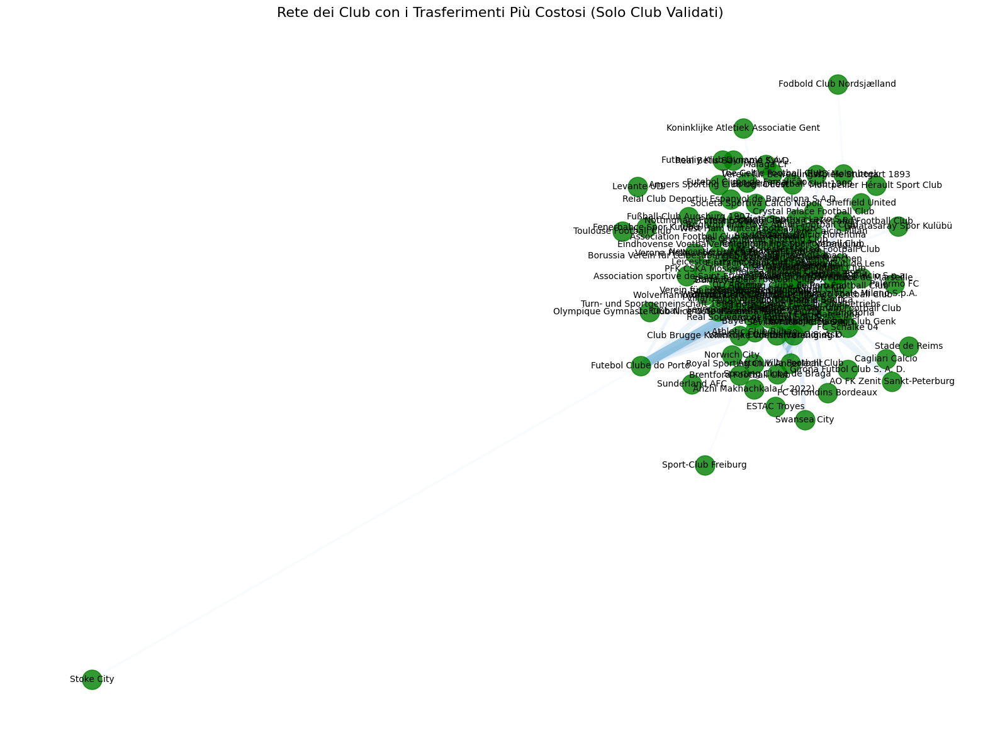


=== Fine della visualizzazione dei trasferimenti più costosi (solo club validi) ===

=== Metriche del grafo ===
Numero di nodi: 109
Numero di archi: 412
Densità del grafo: 0.035
Clustering medio: 0.22
Raggio del grafo: None
Diametro del grafo: None
Grado dei nodi: {'Associazione Calcio Fiorentina': 4, 'Juventus Football Club': 25, 'Manchester United Football Club': 29, 'Società Sportiva Calcio Napoli': 15, 'Arsenal Football Club': 29, 'Crystal Palace Football Club': 5, 'Paris Saint-Germain Football Club': 20, 'Chelsea Football Club': 40, 'Atalanta Bergamasca Calcio S.p.a.': 6, 'Real Sociedad de Fútbol S.A.D.': 5, 'Valencia Club de Fútbol S. A. D.': 8, 'Liverpool Football Club': 15, 'The Celtic Football Club': 2, 'Brighton and Hove Albion Football Club': 13, 'Fenerbahçe Spor Kulübü': 1, 'Fulham Football Club': 8, 'Club Atlético de Madrid S.A.D.': 20, 'Sport Lisboa e Benfica': 14, 'Leeds United': 8, 'Stade Rennais Football Club': 11, 'Futebol Clube do Porto': 12, 'Association Football C

In [29]:
# ------------------------------------------------------
# 14. VISUALIZZAZIONE DEI TRASFERIMENTI COSTOSI VALIDATI
# ------------------------------------------------------
print("\n=== 14. Visualizzazione dei trasferimenti più costosi (solo club validi) ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.spring_layout(G_expensive_valid, seed=42, k=0.5, iterations=200)

# Disegnare i nodi con colore giallo
nx.draw_networkx_nodes(G_expensive_valid, pos, node_size=500, node_color='green', alpha=0.8)

# Disegnare gli archi (pesati in base al costo del trasferimento)
edges, costs = zip(*nx.get_edge_attributes(G_expensive_valid, 'cost').items())
nx.draw_networkx_edges(
    G_expensive_valid,
    pos,
    edgelist=edges,
    width=[c / 1e7 for c in costs],  # Archi più larghi per i trasferimenti costosi
    edge_color=costs,  # Colore degli archi in base al costo
    edge_cmap=plt.cm.Blues,  # Cambiamo il colore a una mappa di colori (Blu per i trasferimenti più costosi)
    alpha=0.7
)

# Disegnare le etichette dei nodi (nomi dei club)
nx.draw_networkx_labels(G_expensive_valid, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei Club con i Trasferimenti Più Costosi (Solo Club Validati)", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione dei trasferimenti più costosi (solo club validi) ===")

calculate_and_print_graph_metrics(G_expensive_valid)

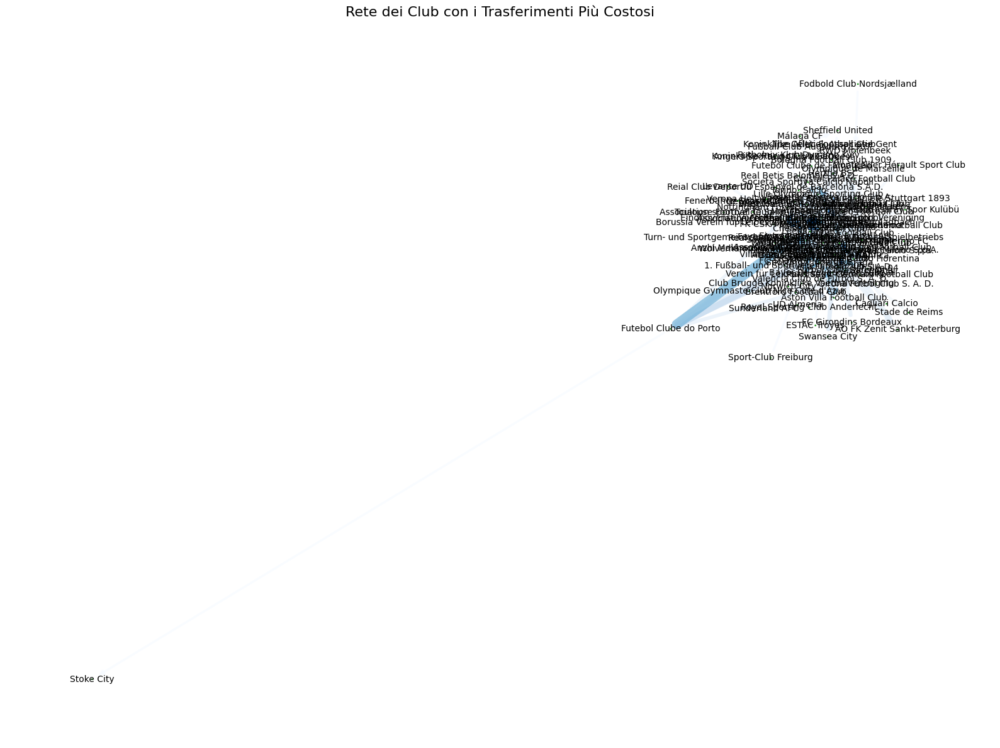

In [30]:
import networkx as nx
import matplotlib.pyplot as plt

# 1. Modifica del Layout
# Proviamo il layout Kamada-Kawai, che solitamente offre una disposizione più naturale
pos = nx.kamada_kawai_layout(G_expensive_valid)

# 2. Aumento delle iterazioni (per una disposizione migliore)
# Questo aiuterà a separare meglio i nodi e fare in modo che il grafo si stabilizzi
pos = nx.spring_layout(G_expensive_valid, seed=42, k=0.5, iterations=300)

# 3. Disegnare il grafo
plt.figure(figsize=(16, 12))

# Disegnare i nodi (dimensioni e colore)
node_sizes = [G_expensive_valid.nodes[node].get("market_value", 1000000) / 1000000 for node in G_expensive_valid.nodes()]
nx.draw_networkx_nodes(G_expensive_valid, pos, node_size=node_sizes, node_color='green', alpha=0.8)

# Disegnare gli archi (larghezza in base al costo dei trasferimenti)
edges, costs = zip(*nx.get_edge_attributes(G_expensive_valid, 'cost').items())
nx.draw_networkx_edges(
    G_expensive_valid,
    pos,
    edgelist=edges,
    width=[c / 1e7 for c in costs],
    edge_color=costs,
    edge_cmap=plt.cm.Blues,
    alpha=0.7
)

# Disegnare le etichette (nomi dei club)
nx.draw_networkx_labels(G_expensive_valid, pos, font_size=10, font_color='black')

# Titolo
plt.title("Rete dei Club con i Trasferimenti Più Costosi", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

In [31]:
# ------------------------------------------------------
# 11. VISUALIZZARE I TRASFERIMENTI PIÙ COSTOSI CON NOME DEL GIOCATORE
# ------------------------------------------------------

print("\n=== 11. Visualizzazione dei trasferimenti più costosi con il nome del giocatore ===")

# Definiamo una soglia per i trasferimenti più costosi (ad esempio, top 0.1% dei trasferimenti più costosi)
cost_threshold = transfers["transfer_fee"].quantile(0.999)  # Prendiamo lo 0.1% dei trasferimenti più costosi

# Filtriamo i trasferimenti con costo maggiore della soglia
expensive_transfers = transfers[transfers["transfer_fee"] >= cost_threshold]

print(f"\nNumero di trasferimenti più costosi (oltre il {cost_threshold} di valore): {len(expensive_transfers)}")
print(expensive_transfers.head(500))

# Creiamo il grafo per i trasferimenti più costosi
G_expensive = nx.DiGraph()

# Aggiungiamo gli archi per i trasferimenti più costosi, includendo il nome del giocatore
for idx, row in expensive_transfers.iterrows():
    from_club = row["from_club_id"]
    to_club = row["to_club_id"]
    player_name = row["player_name"]  # Nome del giocatore
    
    if G_expensive.has_edge(from_club, to_club):
        # Incrementa il peso (numero di trasferimenti) e aggiungi il costo
        G_expensive[from_club][to_club]["weight"] += 1
        G_expensive[from_club][to_club]["cost"] += row["transfer_fee"]
        G_expensive[from_club][to_club]["player_name"] = player_name  # Aggiungi nome del giocatore all'arco
    else:
        # Aggiungi l'arco con peso 1
        G_expensive.add_edge(from_club, to_club, weight=1, cost=row["transfer_fee"], player_name=player_name)

print(f"\nNumero di nodi (club) nel grafo dei trasferimenti costosi: {G_expensive.number_of_nodes()}")
print(f"Numero di archi (trasferimenti costosi) nel grafo: {G_expensive.number_of_edges()}")



=== 11. Visualizzazione dei trasferimenti più costosi con il nome del giocatore ===

Numero di trasferimenti più costosi (oltre il 65000000.0 di valore): 54
       player_id transfer_date transfer_season  from_club_id  to_club_id  \
1621      576024    2024-08-12           24/25           281          13   
8453      550550    2024-01-01           23/24           294         583   
9254      487969    2023-09-01           23/24            24         583   
10084     687626    2023-08-14           23/24          1237         631   
10097     132098    2023-08-12           23/24           148          27   
10335     475959    2023-08-05           23/24         23826         281   
10340     610442    2023-08-05           23/24           800         985   
11087     357662    2023-07-15           23/24           379          11   
11613     451276    2023-07-02           23/24         23826          31   
11902     309400    2023-07-01           23/24           631          11   
12240 


=== 13. Visualizzazione dei trasferimenti più costosi con nome del giocatore sugli archi (senza sfondo) ===


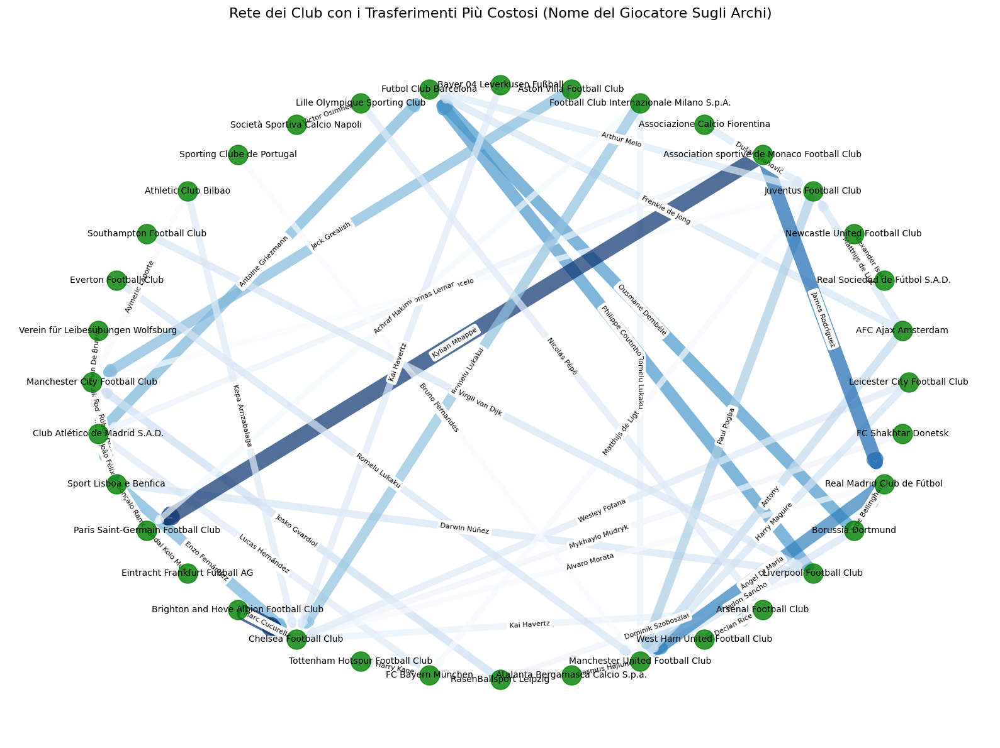


=== Fine della visualizzazione dei trasferimenti più costosi con nome del giocatore sugli archi (senza sfondo) ===

=== Metriche del grafo ===
Numero di nodi: 36
Numero di archi: 51
Densità del grafo: 0.04
Clustering medio: 0.047
Raggio del grafo: None
Diametro del grafo: None
Grado dei nodi: {'Manchester City Football Club': 8, 'Club Atlético de Madrid S.A.D.': 6, 'Sport Lisboa e Benfica': 5, 'Paris Saint-Germain Football Club': 4, 'Eintracht Frankfurt Fußball AG': 1, 'Brighton and Hove Albion Football Club': 1, 'Chelsea Football Club': 9, 'Tottenham Hotspur Football Club': 1, 'FC Bayern München': 3, 'RasenBallsport Leipzig': 2, 'Atalanta Bergamasca Calcio S.p.a.': 1, 'Manchester United Football Club': 9, 'West Ham United Football Club': 1, 'Arsenal Football Club': 3, 'Liverpool Football Club': 4, 'Borussia Dortmund': 3, 'Real Madrid Club de Fútbol': 4, 'FC Shakhtar Donetsk': 1, 'Leicester City Football Club': 2, 'AFC Ajax Amsterdam': 3, 'Real Sociedad de Fútbol S.A.D.': 1, 'Newcastl

In [32]:
# ------------------------------------------------------
# 12. RILABEL DEI NODI CON I NOMI DEI CLUB
# ------------------------------------------------------

# Rilabel dei nodi nel grafo con i nomi dei club
nx.relabel_nodes(G_expensive, club_id_to_name, copy=False)

# ------------------------------------------------------
# 13. VISUALIZZAZIONE DEI TRASFERIMENTI COSTOSI CON NOME DEL GIOCATORE SENZA SFONDO
# ------------------------------------------------------

print("\n=== 13. Visualizzazione dei trasferimenti più costosi con nome del giocatore sugli archi (senza sfondo) ===")

# Aumento la dimensione della figura per migliorare la leggibilità
plt.figure(figsize=(16, 12))

# Layout per la disposizione dei nodi
pos = nx.shell_layout(G_expensive)

# Disegnare i nodi con colore giallo
nx.draw_networkx_nodes(G_expensive, pos, node_size=500, node_color='green', alpha=0.8)

# Disegnare gli archi (larghezza in base al costo del trasferimento)
edges, costs = zip(*nx.get_edge_attributes(G_expensive, 'cost').items())
nx.draw_networkx_edges(
    G_expensive,
    pos,
    edgelist=edges,
    width=[c / 1e7 for c in costs],
    edge_color=costs,
    edge_cmap=plt.cm.Blues,
    alpha=0.7
)

# Disegnare le etichette dei nodi (nomi dei club)
nx.draw_networkx_labels(G_expensive, pos, font_size=10, font_color='black')

# Disegnare le etichette degli archi (nome del giocatore)
edge_labels = nx.get_edge_attributes(G_expensive, 'player_name')

# Visualizzare le etichette degli archi senza sfondo
nx.draw_networkx_edge_labels(
    G_expensive, 
    pos, 
    edge_labels=edge_labels, 
    font_size=8, 
    font_color='black',  # Colore del testo
    font_weight='normal',  # Nessun bold
    verticalalignment='center',  # Allineamento verticale
    horizontalalignment='center',  # Allineamento orizzontale
    label_pos=0.5,  # Posizione dell'etichetta sugli archi
    ax=plt.gca()  # Usa l'asse corrente per disegnare
)

# Titolo
plt.title("Rete dei Club con i Trasferimenti Più Costosi (Nome del Giocatore Sugli Archi)", fontsize=16)
plt.axis('off')  # Nascondi gli assi
plt.tight_layout()  # Ottimizzare la disposizione
plt.show()

print("\n=== Fine della visualizzazione dei trasferimenti più costosi con nome del giocatore sugli archi (senza sfondo) ===")

calculate_and_print_graph_metrics(G_expensive)

# ANALISI DELLE COMUNITÀ

Numero di nodi: 439
Numero di archi: 13183

Numero di comunità trovate: 8
Comunità 1: 66 nodi
Comunità 8: 79 nodi
Comunità 3: 38 nodi
Comunità 5: 52 nodi
Comunità 6: 67 nodi
Comunità 7: 42 nodi
Comunità 2: 34 nodi
Comunità 4: 61 nodi


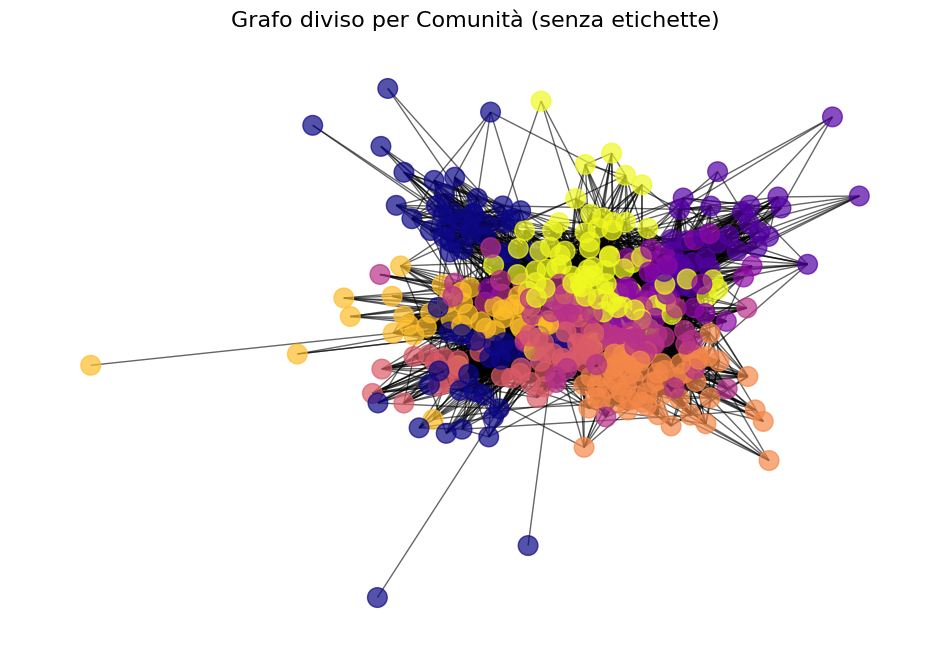

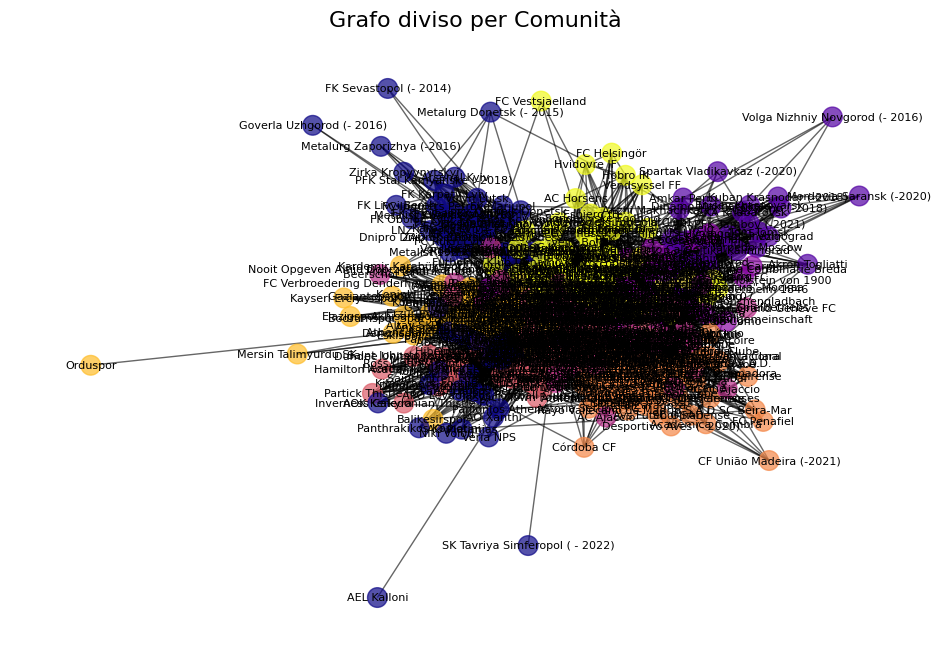

/Users/andreavisi/Library/Python/3.9/lib/python/site-packages/networkx/drawing/nx_pylab.py:437: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


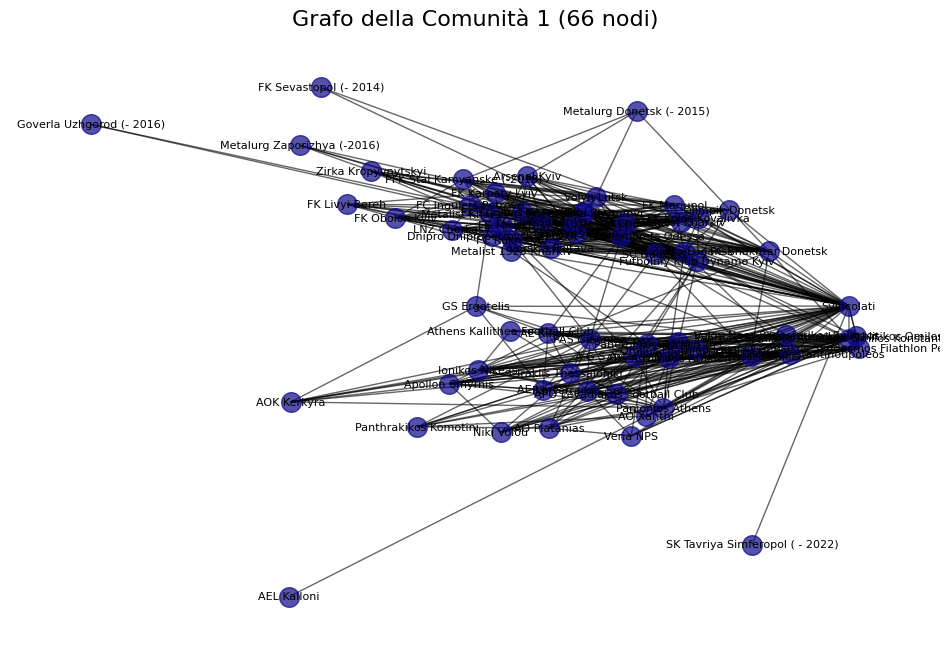

Comunità 1: ['Svincolati', 'APO Levadiakos Football Club', 'Panathinaikos Athlitikos Omilos', 'Olympiakos Syndesmos Filathlon Peiraios', 'Panserraikos Serres', 'FK Obolon Kyiv', 'LNZ Cherkasy', 'Panthessalonikios Athlitikos Omilos Konstantinoupoliton', 'Futbolniy Klub Dynamo Kyiv', 'FC Shakhtar Donetsk', 'Panetolikos Agrinio', 'FK Zarya Lugansk', 'Aris Thessalonikis', 'Omilos Filathlon Irakliou FC', 'PAS Lamia 1964', 'Athlitiki Enosi Konstantinoupoleos', 'Vorskla Poltava', 'FC Rukh Lviv', 'FK Kryvbas Kryvyi Rig', 'Volou Neos Podosferikos Syllogos', 'FK Kolos Kovalivka', 'FK Karpaty Lviv', 'ZAO FK Chornomorets Odessa', 'FK Polissya Zhytomyr', 'FK Livyi Bereh', 'NK Veres Rivne', 'FC Ingulets Petrove', 'A.G.S Asteras Tripolis', 'Athens Kallithea Football Club', 'FC Minaj', 'FC Oleksandriya', 'APS Atromitos Athinon', 'PAS Giannina', 'SC Dnipro-1', 'Metalist 1925 Kharkiv', 'AE Larisa', 'Iraklis Thessaloniki', 'AE Kifisias', 'Panionios Athens', 'Ionikos Nikeas', 'Niki Volou', 'Metalist Khark

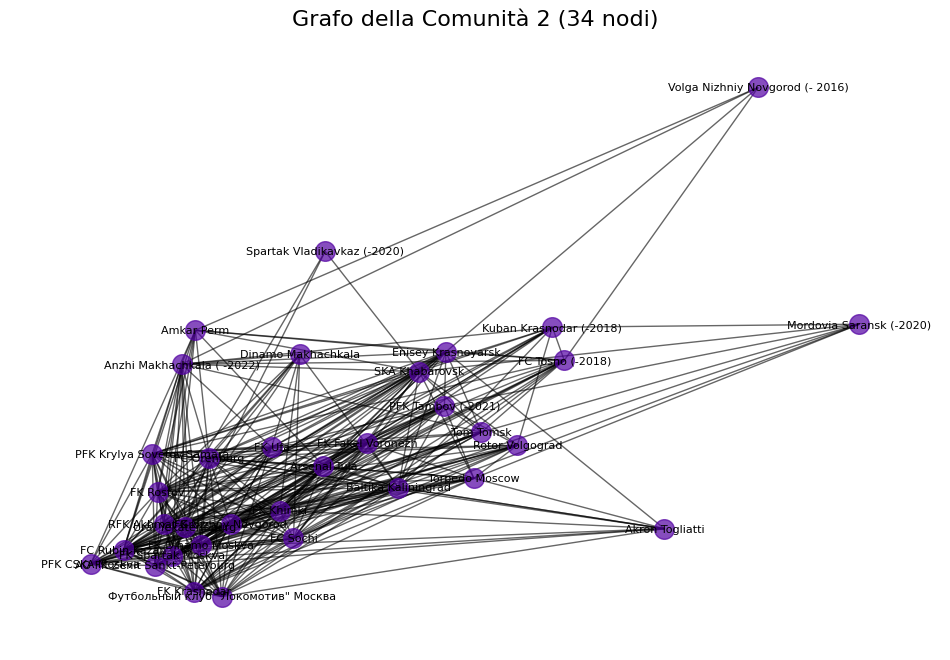

Comunità 2: ['FK Rostov', 'Dinamo Makhachkala', 'FC Sochi', 'AO FK Zenit Sankt-Peterburg', 'FK Fakel Voronezh', 'FK Khimki', 'RFK Akhmat Grozny', 'FK Nizhny Novgorod', 'FK Krasnodar', 'Akron Togliatti', 'Torpedo Moscow', 'PFK Krylya Sovetov Samara', 'SKA Khabarovsk', 'FC Orenburg', 'Baltika Kaliningrad', 'Футбольный клуб "Локомотив" Москва', 'PFK CSKA Moskva', 'Enisey Krasnoyarsk', 'FK Spartak Moskva', 'Ural Yekaterinburg', 'FK Dinamo Moskva', 'Amkar Perm', 'FC Rubin Kazan', 'Arsenal Tula', 'FK Ufa', 'Anzhi Makhachkala ( -2022)', 'Rotor Volgograd', 'Tom Tomsk', 'PFK Tambov (-2021)', 'Spartak Vladikavkaz (-2020)', 'Mordovia Saransk (-2020)', 'FC Tosno (-2018)', 'Kuban Krasnodar (-2018)', 'Volga Nizhniy Novgorod (- 2016)']


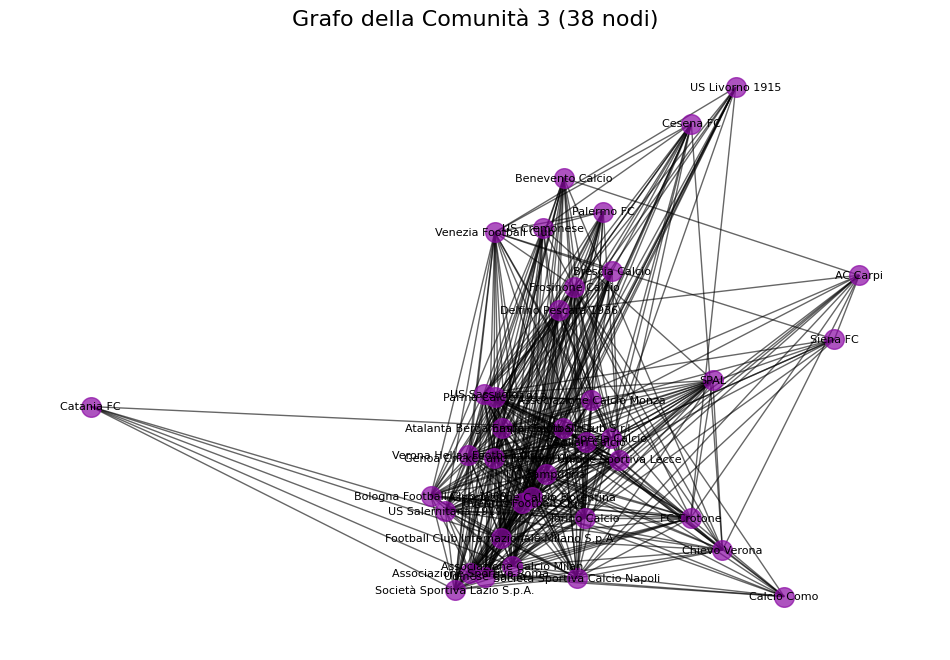

Comunità 3: ['Società Sportiva Lazio S.p.A.', 'US Salernitana 1919', 'Associazione Calcio Fiorentina', 'Associazione Calcio Monza', 'Juventus Football Club', 'Associazione Sportiva Roma', 'Empoli Football Club S.r.l.', 'UC Sampdoria', 'Frosinone Calcio', 'Verona Hellas Football Club', 'Cagliari Calcio', 'Calcio Como', 'Atalanta Bergamasca Calcio S.p.a.', 'Genoa Cricket and Football Club', 'Unione Sportiva Lecce', 'Bologna Football Club 1909', 'Torino Calcio', 'US Sassuolo', 'Associazione Calcio Milan', 'Football Club Internazionale Milano S.p.A.', 'Società Sportiva Calcio Napoli', 'Spezia Calcio', 'Palermo FC', 'US Cremonese', 'Venezia Football Club', 'Udinese Calcio', 'Parma Calcio 1913', 'Cesena FC', 'FC Crotone', 'Benevento Calcio', 'Catania FC', 'Brescia Calcio', 'Delfino Pescara 1936', 'SPAL', 'Siena FC', 'US Livorno 1915', 'Chievo Verona', 'AC Carpi']


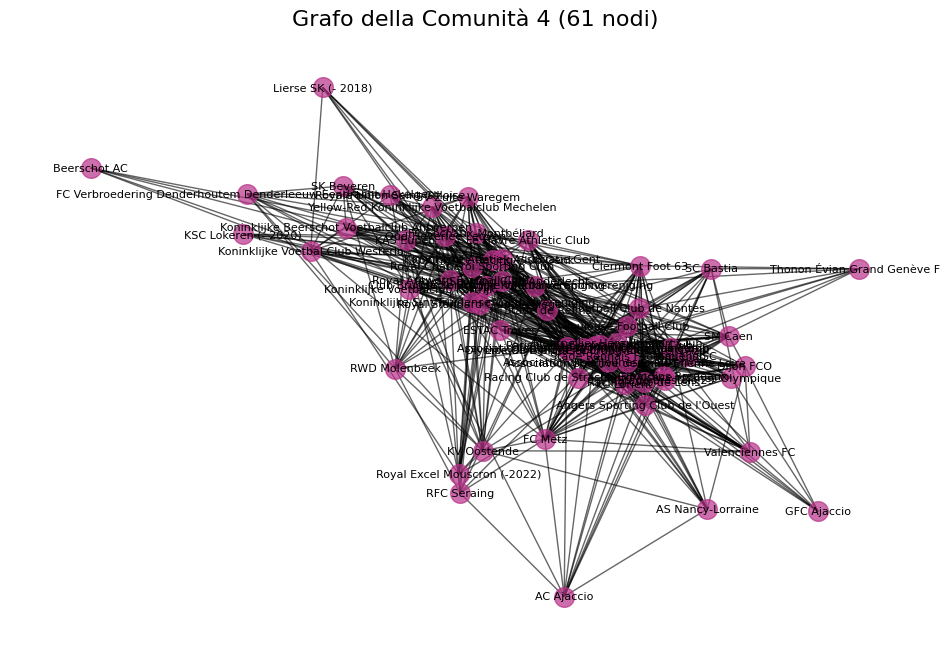

Comunità 4: ['Stade brestois 29', 'Association sportive de Monaco Football Club', 'Paris Saint-Germain Football Club', 'Olympique Lyonnais', 'Toulouse Football Club', 'Olympique de Marseille', 'Royal Sporting Club Anderlecht', 'Royal Standard Club de Liège', 'Royale Union Saint-Gilloise', 'Stade de Reims', 'Royal Charleroi Sporting Club', 'Yellow-Red Koninklijke Voetbalclub Mechelen', 'Koninklijke Racing Club Genk', 'ESTAC Troyes', 'Racing Club de Lens', 'Lille Olympique Sporting Club', 'Stade Rennais Football Club', 'Clermont Foot 63', 'Association de la Jeunesse auxerroise', 'Racing Club de Strasbourg Alsace', "Olympique Gymnaste Club Nice Côte d'Azur", 'Cercle Brugge Koninklijke Sportvereniging', 'Football Club de Nantes', 'Koninklijke Sint-Truidense Voetbalvereniging', 'Koninklijke Voetbalclub Kortrijk', 'Oud-Heverlee Leuven', 'RWD Molenbeek', 'Association sportive de Saint-Étienne Loire', 'Le Havre Athletic Club', 'FC Metz', 'Club Brugge Koninklijke Voetbalvereniging', 'Koninklijk

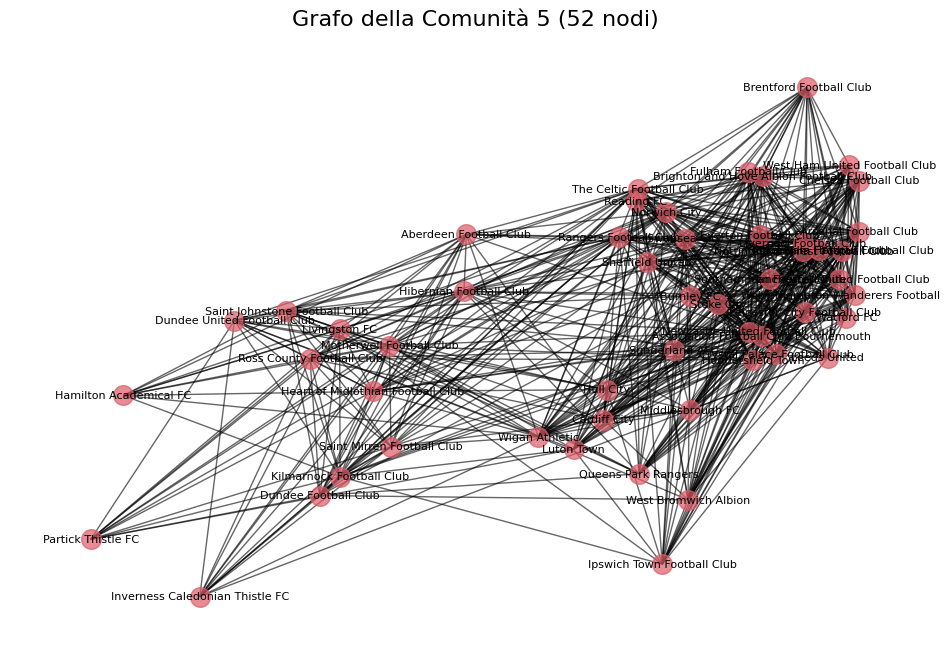

Comunità 5: ['Inverness Caledonian Thistle FC', 'Dundee United Football Club', 'Arsenal Football Club', 'Association Football Club Bournemouth', 'Tottenham Hotspur Football Club', 'Aston Villa Football Club', 'Nottingham Forest Football Club', 'West Ham United Football Club', 'Aberdeen Football Club', 'Everton Football Club', 'Sheffield United', 'Southampton Football Club', 'Rangers Football Club', 'Fulham Football Club', 'Leicester City Football Club', 'Crystal Palace Football Club', 'Ipswich Town Football Club', 'Hibernian Football Club', 'Leeds United', 'Chelsea Football Club', 'Manchester United Football Club', 'Brentford Football Club', 'Wolverhampton Wanderers Football Club', 'Huddersfield Town', 'Watford FC', 'The Celtic Football Club', 'Liverpool Football Club', 'Sunderland AFC', 'Burnley FC', 'Cardiff City', 'Norwich City', 'Brighton and Hove Albion Football Club', 'Motherwell Football Club', 'Luton Town', 'Saint Mirren Football Club', 'Dundee Football Club', 'Queens Park Rang

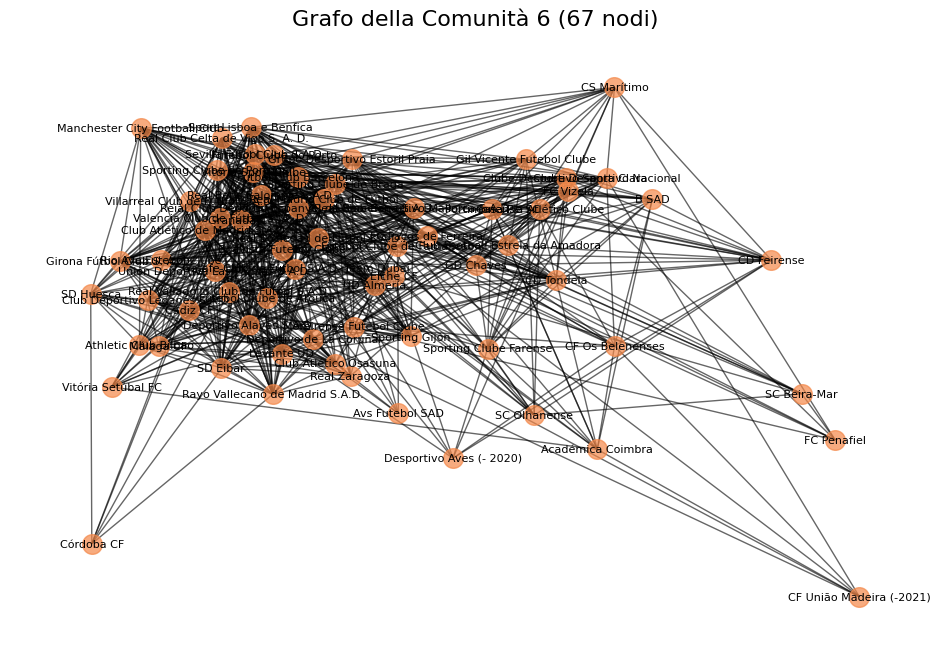

Comunità 6: ['Sport Lisboa e Benfica', 'Girona Fútbol Club S. A. D.', 'Futbol Club Barcelona', 'Villarreal Club de Fútbol S.A.D.', 'Sevilla Fútbol Club S.A.D.', 'Club Atlético de Madrid S.A.D.', 'Unión Deportiva Las Palmas S.A.D.', 'Club Deportivo Leganés S.A.D.', 'Deportivo Alavés S.A.D.', 'Rayo Vallecano de Madrid S.A.D.', 'Granada CF', 'Real Club Celta de Vigo S. A. D.', 'Real Betis Balompié S.A.D.', 'Getafe Club de Fútbol S.A.D. Team Dubai', 'UD Almería', 'Real Valladolid Club de Fútbol S.A.D.', 'Valencia Club de Fútbol S. A. D.', 'Real Club Deportivo Mallorca S.A.D.', 'Reial Club Deportiu Espanyol de Barcelona S.A.D.', 'Athletic Club Bilbao', 'Clube Desportivo Santa Clara', 'Futebol Clube de Arouca', 'Sporting Clube de Braga', 'Manchester City Football Club', 'Sporting Clube Farense', 'Real Sociedad de Fútbol S.A.D.', 'Málaga CF', 'Gil Vicente Futebol Clube', 'Rio Ave Futebol Clube', 'Grupo Desportivo Estoril Praia', 'CD Tondela', 'Clube Desportivo Nacional', 'Futebol Clube do Por

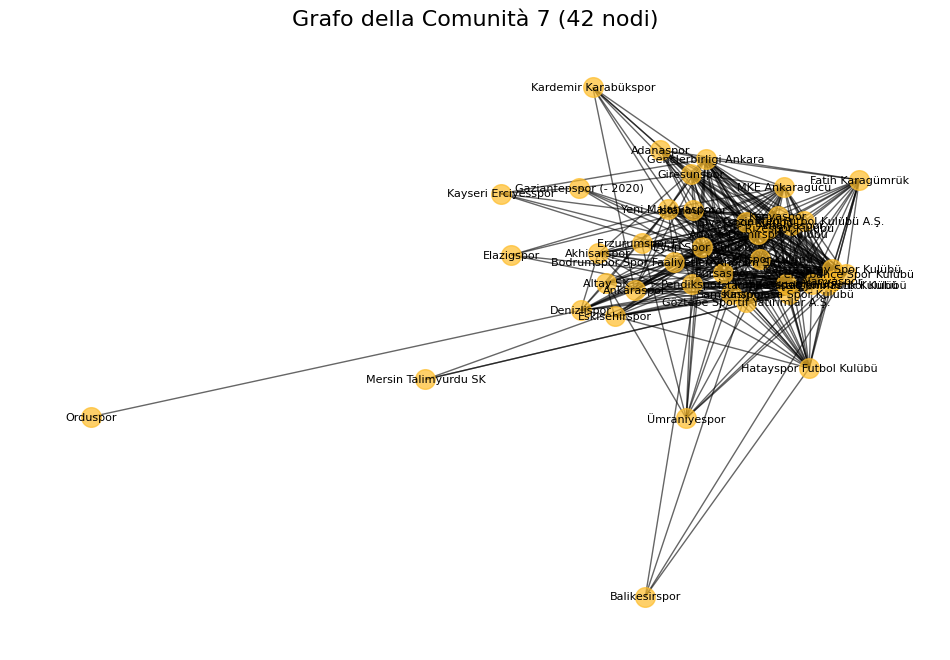

Comunità 7: ['Beşiktaş Jimnastik Kulübü', 'Fenerbahçe Spor Kulübü', 'Galatasaray Spor Kulübü', 'Göztepe Sportif Yatırımlar A.Ş.', 'Eyüp Spor Kulübü', 'Bodrumspor Spor Faaliyetleri Anonim Şirketi', 'Çaykur Rizespor Kulübü', 'Kasımpaşa Spor Kulübü', 'İstanbul Başakşehir Futbol Kulübü', 'Trabzonspor Kulübü', 'Gaziantep Futbol Kulübü A.Ş.', 'Kayserispor Kulübü', 'Antalyaspor', 'Hatayspor Futbol Kulübü', 'Adanaspor', 'Fatih Karagümrük', 'Ümraniyespor', 'Alanyaspor', 'MKE Ankaragücü', 'Sivasspor Kulübü', 'Balikesirspor', 'Konyaspor', 'Pendikspor', 'Samsunspor', 'Adana Demirspor Kulübü', 'Yeni Malatyaspor', 'Istanbulspor', 'Erzurumspor FK', 'Genclerbirligi Ankara', 'Bursaspor', 'Altay SK', 'Ankaraspor', 'Denizlispor', 'Giresunspor', 'Elazigspor', 'Eskisehirspor', 'Akhisarspor', 'Kardemir Karabükspor', 'Gaziantepspor (- 2020)', 'Mersin Talimyurdu SK', 'Kayseri Erciyesspor', 'Orduspor']


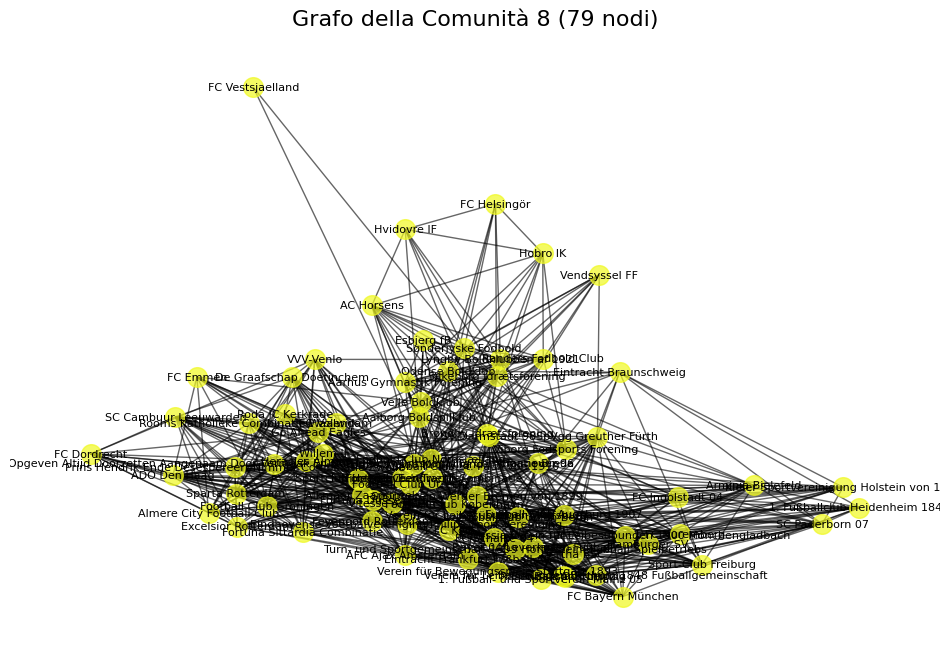

Comunità 8: ['Verein für Bewegungsspiele Stuttgart 1893', 'FC Bayern München', '1. Fußball- und Sportverein Mainz 05', 'Brøndby Idrætsforening', 'Fußball-Club Augsburg 1907', 'Aalborg Boldspilklub', 'Borussia Verein für Leibesübungen 1900 Mönchengladbach', 'Football Club København', 'AFC Ajax Amsterdam', 'RasenBallsport Leipzig', 'Borussia Dortmund', 'Fortuna Sittardia Combinatie', 'Football Club Utrecht', 'Vejle Boldklub', 'Verein für Leibesübungen Wolfsburg', 'Eintracht Frankfurt Fußball AG', '1. Fußballclub Union Berlin', 'Nijmegen Eendracht Combinatie', '1.FC Nuremberg', 'Hamburger SV', 'Bayer 04 Leverkusen Fußball', 'Viborg Fodsports Forening', 'Prins Hendrik Ende Desespereert Nimmer Combinatie Zwolle', 'Sportverein Werder Bremen von 1899', 'Verein für Leibesübungen Bochum 1848 Fußballgemeinschaft', 'Feyenoord Rotterdam', 'Hannover 96', 'Football Club Twente', 'Turn- und Sportgemeinschaft 1899 Hoffenheim Fußball-Spielbetriebs', 'Heracles Almelo', 'SpVgg Greuther Fürth', 'Almere Ci

In [64]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import community as community_louvain
import os

# Step 1: Caricare i dati
transfers_df = pd.read_csv('../Datasets/SNA/transfers.csv')
clubs_df = pd.read_csv('../Datasets/SNA/clubs.csv')

# Sostituire i valori NaN in transfer_fee con 0
transfers_df['transfer_fee'] = transfers_df['transfer_fee'].fillna(0)

print(f"Numero di nodi: {G.number_of_nodes()}")
print(f"Numero di archi: {G.number_of_edges()}")

# Step 3: Creazione del grafo non diretto e rilevazione delle comunità
G_undirected = G.to_undirected()
partition = community_louvain.best_partition(G_undirected)

# Rinumerare le comunità da 1
renumbered_partition = {node: comm + 1 for node, comm in partition.items()}
num_communities = len(set(renumbered_partition.values()))

# Mostrare il numero di comunità e la loro cardinalità
print(f"\nNumero di comunità trovate: {num_communities}")
community_sizes = {}
for node, comm in renumbered_partition.items():
    community_sizes[comm] = community_sizes.get(comm, 0) + 1

for comm, size in community_sizes.items():
    print(f"Comunità {comm}: {size} nodi")

# Calcolare le posizioni dei nodi una volta per il grafo totale
colors = plt.cm.plasma(np.linspace(0, 1, num_communities))
node_colors = [colors[renumbered_partition[node] - 1] for node in G_undirected.nodes()]
pos = nx.spring_layout(G_undirected, seed=42)  # Calcolo unico del layout

# Creare una directory per salvare le immagini
output_dir = 'community_graphs'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Step 4: Visualizzare e salvare il grafo totale con e senza etichette
# Grafo senza etichette
plt.figure(figsize=(12, 8))
nx.draw_networkx_nodes(G_undirected, pos, node_color=node_colors, node_size=200, alpha=0.7)
nx.draw_networkx_edges(G_undirected, pos, alpha=0.6)
plt.title("Grafo diviso per Comunità (senza etichette)", fontsize=16)
plt.axis('off')
plt.savefig(os.path.join(output_dir, 'graph_no_labels.png'))  # Salva l'immagine
plt.show()
plt.close()

# Grafo con etichette
plt.figure(figsize=(12, 8))
nx.draw_networkx_nodes(G_undirected, pos, node_color=node_colors, node_size=200, alpha=0.7)
nx.draw_networkx_edges(G_undirected, pos, alpha=0.6)
nx.draw_networkx_labels(G_undirected, pos, font_size=8, font_color="black")
plt.title("Grafo diviso per Comunità", fontsize=16)
plt.axis('off')
plt.savefig(os.path.join(output_dir, 'graph_with_labels.png'))  # Salva l'immagine
plt.show()
plt.close()

# Step 5: Visualizzare i grafi per ogni comunità usando le stesse posizioni
for comm in range(1, num_communities + 1):
    # Filtrare i nodi della comunità corrente
    community_nodes = [node for node, com in renumbered_partition.items() if com == comm]
    community_subgraph = G_undirected.subgraph(community_nodes)
    
    # Disegnare il sottografo usando le posizioni del grafo totale
    plt.figure(figsize=(12, 8))
    nx.draw_networkx_nodes(community_subgraph, pos, node_size=200, node_color=colors[comm - 1], alpha=0.7)
    nx.draw_networkx_edges(community_subgraph, pos, alpha=0.6)
    nx.draw_networkx_labels(community_subgraph, pos, font_size=8, font_color="black")
    plt.title(f"Grafo della Comunità {comm} ({len(community_nodes)} nodi)", fontsize=16)
    plt.axis('off')
    
    # Salva l'immagine per la comunità corrente
    plt.savefig(os.path.join(output_dir, f'community_{comm}_graph.png'))
    plt.show()
    plt.close()

    print(f"Comunità {comm}: {community_nodes}")

In [62]:
clubs_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 439 entries, 0 to 438
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   club_id                  439 non-null    int64  
 1   club_code                439 non-null    object 
 2   name                     439 non-null    object 
 3   domestic_competition_id  439 non-null    object 
 4   total_market_value       0 non-null      float64
 5   squad_size               439 non-null    int64  
 6   average_age              401 non-null    float64
 7   foreigners_number        439 non-null    int64  
 8   foreigners_percentage    390 non-null    float64
 9   national_team_players    439 non-null    int64  
 10  stadium_name             439 non-null    object 
 11  stadium_seats            439 non-null    int64  
 12  net_transfer_record      439 non-null    object 
 13  coach_name               0 non-null      float64
 14  last_season              4

## Analisi dei campionati

/var/folders/zt/9ggmn83106zfjymwl_r2kkdh0000gn/T/ipykernel_58668/3663860374.py:21: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("tab20")


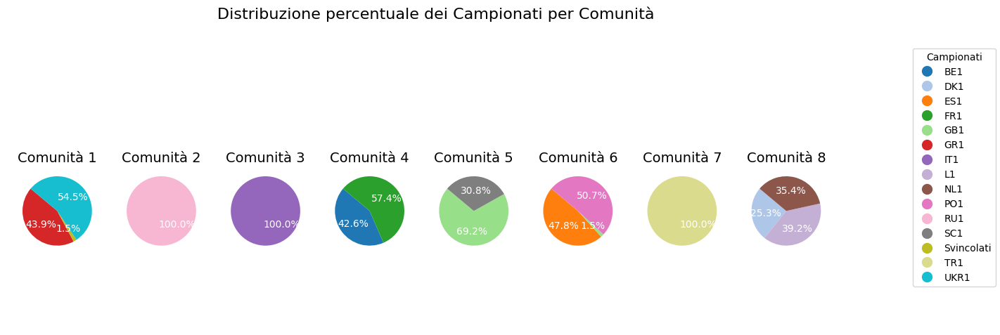

In [66]:
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap

# Creare una directory per salvare le immagini
output_dir = 'community_graphs'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Assumendo che 'clubs_df' contenga le colonne 'club_id' e 'domestic_competition_id' che mappano ogni club al suo campionato
club_to_competition = dict(zip(clubs_df['name'], clubs_df['domestic_competition_id']))

# Sostituire "Unknown" e "Without Club" con "Svincolati" nei dati
node_to_competition = {
    node: club_to_competition.get(node, 'Svincolati') for node in G.nodes()
}

# Trova tutti i campionati presenti, includendo "Svincolati"
all_competitions = set(node_to_competition.values())

# Generare una mappatura di colori unica per ogni campionato
cmap = get_cmap("tab20")
competition_colors = {
    competition: cmap(i / len(all_competitions)) for i, competition in enumerate(sorted(all_competitions))
}

# Creiamo una distribuzione dei campionati per ogni comunità
community_competition_distribution = {}

# Supponiamo che `renumbered_partition` contenga la mappatura delle squadre alle comunità
for comm in range(1, num_communities + 1):
    # Filtriamo i nodi appartenenti alla comunità corrente
    community_teams = [node for node, community in renumbered_partition.items() if community == comm]
    
    # Calcoliamo la distribuzione dei campionati per le squadre di questa comunità
    competition_counts = {}
    for team in community_teams:
        competition = node_to_competition.get(team, 'Svincolati')  # Assegna il campionato della squadra
        competition_counts[competition] = competition_counts.get(competition, 0) + 1
    
    # Aggiungiamo la distribuzione al dizionario per la comunità
    community_competition_distribution[comm] = competition_counts

# Ora puoi eseguire l'aggiornamento dei dati come prima
community_competition_distribution_updated = {}
for comm, distribution in community_competition_distribution.items():
    updated_distribution = {}
    for competition, value in distribution.items():
        competition = "Svincolati" if competition == "Unknown" else competition
        updated_distribution[competition] = updated_distribution.get(competition, 0) + value
    community_competition_distribution_updated[comm] = updated_distribution

# Ora puoi continuare con la parte del grafico
fig, axes = plt.subplots(1, num_communities, figsize=(16, 6), subplot_kw=dict(aspect="equal"))

for idx, (comm, distribution) in enumerate(community_competition_distribution_updated.items()):
    # Ordinare i dati per una rappresentazione coerente
    sorted_distribution = dict(sorted(distribution.items()))
    
    # Dati per il grafico
    labels = list(sorted_distribution.keys())
    sizes = list(sorted_distribution.values())
    colors = [competition_colors[label] for label in labels]
    
    # Disegnare il grafico
    wedges, texts, autotexts = axes[idx].pie(
        sizes, labels=labels, colors=colors, autopct="%.1f%%", startangle=140, textprops=dict(color="w")
    )
    axes[idx].set_title(f"Comunità {comm}", fontsize=14)

# Legenda comune per i grafici
fig.legend(
    handles=[plt.Line2D([0], [0], marker='o', color=color, markersize=10, linestyle='') for color in competition_colors.values()],
    labels=competition_colors.keys(),
    loc="center right",
    title="Campionati"
)

# Aggiungere uno spazio tra i grafici e la legenda
plt.subplots_adjust(right=0.85)
plt.suptitle("Distribuzione percentuale dei Campionati per Comunità", fontsize=16)
plt.savefig(os.path.join(output_dir, 'distribuzione_campionati.png'))  # Salva l'immagine
plt.show()

/var/folders/zt/9ggmn83106zfjymwl_r2kkdh0000gn/T/ipykernel_58668/1179918820.py:14: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("tab20")


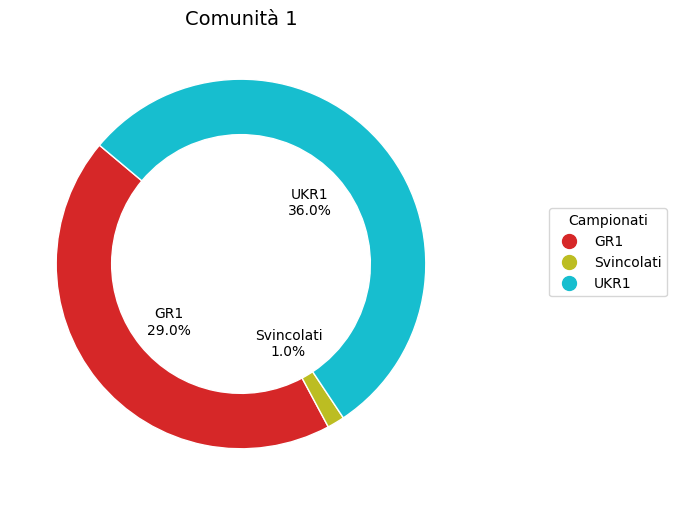

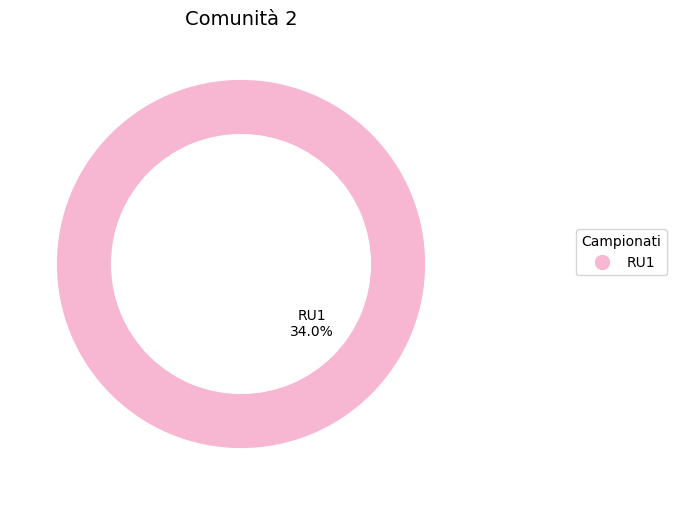

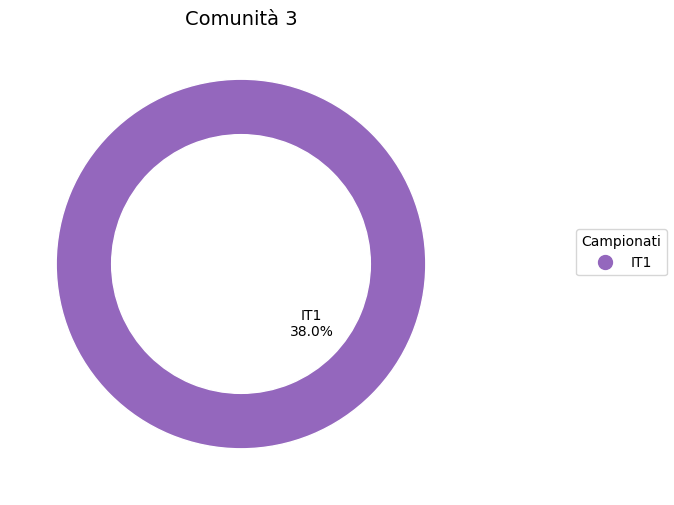

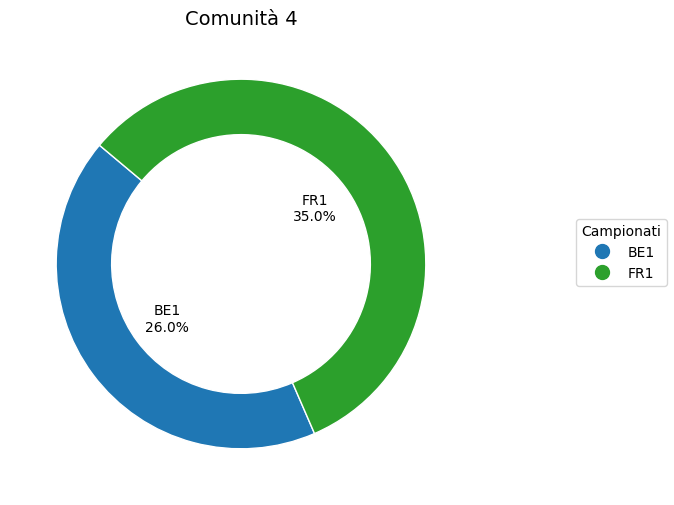

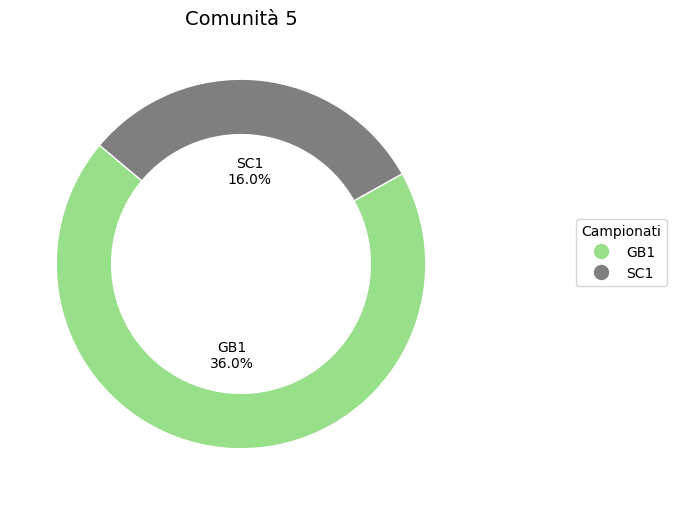

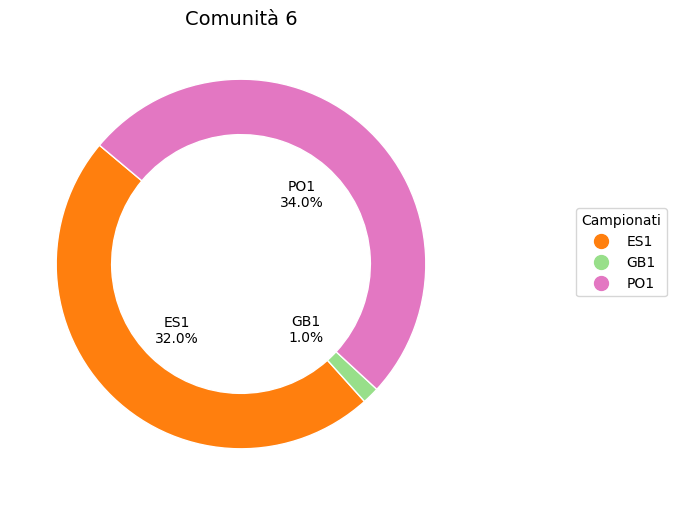

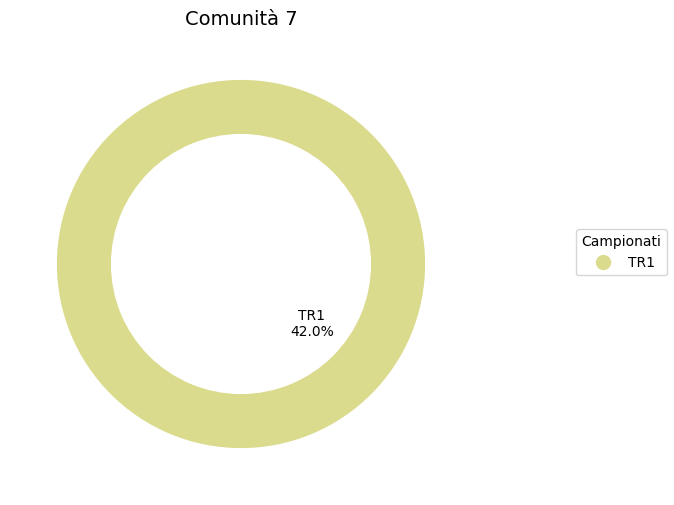

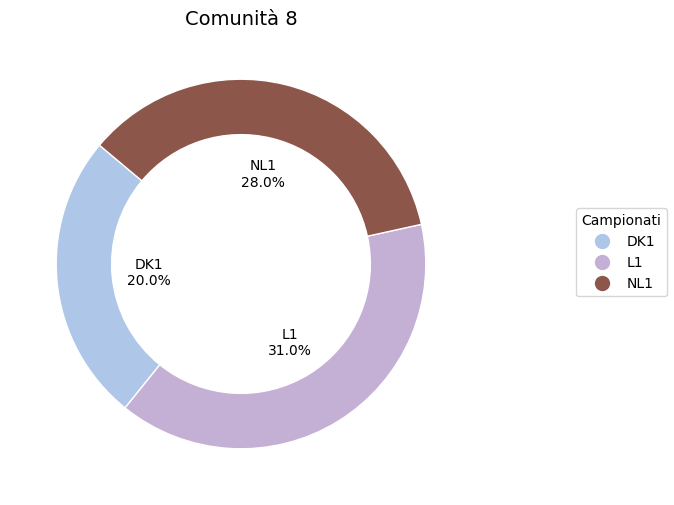

In [67]:
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap
import numpy as np

# Sostituire "Unknown" e "Without Club" con "Svincolati" nei dati
node_to_competition = {
    node: club_to_competition.get(node, 'Svincolati') for node in G.nodes()
}

# Trova tutti i campionati presenti, includendo "Svincolati"
all_competitions = set(node_to_competition.values())

# Generare una mappatura di colori unica per ogni campionato
cmap = get_cmap("tab20")
competition_colors = {
    competition: cmap(i / len(all_competitions)) for i, competition in enumerate(sorted(all_competitions))
}

# Aggiornare i dati per sostituire "Unknown" con "Svincolati" nelle distribuzioni
community_competition_distribution_updated = {}
for comm, distribution in community_competition_distribution.items():
    updated_distribution = {}
    for competition, value in distribution.items():
        competition = "Svincolati" if competition == "Unknown" else competition
        updated_distribution[competition] = updated_distribution.get(competition, 0) + value
    community_competition_distribution_updated[comm] = updated_distribution

# Creare un grafico ad anello per ogni comunità con la sua legenda
for comm, distribution in community_competition_distribution_updated.items():
    # Ordinare i dati per una rappresentazione coerente
    sorted_distribution = dict(sorted(distribution.items()))
    
    # Dati per il grafico
    labels = list(sorted_distribution.keys())
    sizes = list(sorted_distribution.values())
    colors = [competition_colors[label] for label in labels]
    
    # Disegnare il grafico ad anello
    fig, ax = plt.subplots(figsize=(8, 6), subplot_kw=dict(aspect="equal"))
    wedges, texts = ax.pie(
        sizes, labels=None, colors=colors, startangle=140, radius=1.0, wedgeprops=dict(width=0.3, edgecolor='w')
    )
    
    # Aggiungere i nomi dei campionati e le percentuali al centro dei segmenti
    for i, p in enumerate(wedges):
        ang = (p.theta2 - p.theta1) / 2.0 + p.theta1
        x = 0.5 * np.cos(np.radians(ang))  # Ridurre il raggio per spostare il testo verso il centro
        y = 0.5 * np.sin(np.radians(ang))
        ax.text(x, y, f"{labels[i]}\n{sizes[i]:.1f}%", ha='center', va='center', fontsize=10, color='black')

    ax.set_title(f"Comunità {comm}", fontsize=14)

    # Legenda specifica per questa comunità
    fig.legend(
        handles=[plt.Line2D([0], [0], marker='o', color=competition_colors[label], markersize=10, linestyle='') for label in labels],
        labels=labels,
        loc="center right",
        title="Campionati"
    )

    # Aggiungere spaziatura tra grafico e legenda
    plt.subplots_adjust(right=0.8)
    plt.show()

## Analisi dei bilanci

In [68]:
def calculate_global_team_balance(transfers_df, clubs_df):
    """
    Calcola il bilancio globale di ogni squadra per tutte le stagioni,
    utilizzando i nomi dei club mappati dagli ID.

    Args:
        transfers_df (pd.DataFrame): Dati dei trasferimenti.
        clubs_df (pd.DataFrame): Dati dei club.

    Returns:
        dict: Bilancio globale per ogni squadra (nome del club come chiave).
    """
    # Creare una mappatura da club_id a club_name
    club_id_to_name = dict(zip(clubs_df['club_id'], clubs_df['name']))

    team_balances = {}

    for _, transfer in transfers_df.iterrows():
        from_club_id = transfer["from_club_id"]
        to_club_id = transfer["to_club_id"]
        fee = transfer["transfer_fee"]

        # Trovare i nomi dei club utilizzando la mappatura
        from_club = club_id_to_name.get(from_club_id, None)
        to_club = club_id_to_name.get(to_club_id, None)

        # Aggiornare i bilanci solo se il club ha un nome valido
        if from_club:
            team_balances[from_club] = team_balances.get(from_club, 0) + fee
        if to_club:
            team_balances[to_club] = team_balances.get(to_club, 0) - fee

    return team_balances


def calculate_global_community_balance(transfers_df, partition, communities):
    """
    Calcola la media dei bilanci globali delle squadre per ogni comunità.

    Args:
        transfers_df (pd.DataFrame): Dati dei trasferimenti.
        partition (dict): Dizionario che mappa i nodi alle loro comunità.
        communities (list): Elenco delle comunità.

    Returns:
        dict: Media dei bilanci globali per ogni comunità.
    """
    team_balances = calculate_global_team_balance(transfers_df, clubs_df)
    community_balances = {comm: [] for comm in communities}

    for team, balance in team_balances.items():
        community = partition.get(team, None)
        if community:
            community_balances[community].append(balance)

    community_average_balances = {
        comm: sum(balances) / len(balances) if balances else 0
        for comm, balances in community_balances.items()
    }

    return community_average_balances


def calculate_season_team_balance(transfers_df, season):
    """
    Calcola il bilancio delle squadre per una stagione specifica.

    Args:
        transfers_df (pd.DataFrame): Dati dei trasferimenti.
        season (str): Stagione specifica (es. "23/24").

    Returns:
        dict: Bilancio della stagione per ogni squadra.
    """
    season_transfers = transfers_df[transfers_df["transfer_season"] == season]
   
    # Creare una mappatura da club_id a club_name
    club_id_to_name = dict(zip(clubs_df['club_id'], clubs_df['name']))

    team_balances = {}

    for _, transfer in season_transfers.iterrows():
        from_club_id = transfer["from_club_id"]
        to_club_id = transfer["to_club_id"]
        fee = transfer["transfer_fee"]

        # Trovare i nomi dei club utilizzando la mappatura
        from_club = club_id_to_name.get(from_club_id, None)
        to_club = club_id_to_name.get(to_club_id, None)

        # Aggiornare i bilanci solo se il club ha un nome valido
        if from_club:
            team_balances[from_club] = team_balances.get(from_club, 0) + fee
        if to_club:
            team_balances[to_club] = team_balances.get(to_club, 0) - fee


    return team_balances


def calculate_season_community_balance(transfers_df, partition, communities, season):
    """
    Calcola la media dei bilanci delle squadre per ogni comunità nella stagione specifica.

    Args:
        transfers_df (pd.DataFrame): Dati dei trasferimenti.
        partition (dict): Dizionario che mappa i nodi alle loro comunità.
        communities (list): Elenco delle comunità.
        season (str): Stagione specifica (es. "23/24").

    Returns:
        dict: Media dei bilanci per ogni comunità nella stagione specifica.
    """
    team_balances = calculate_season_team_balance(transfers_df, season)
    community_balances = {comm: [] for comm in communities}

    for team, balance in team_balances.items():
        community = partition.get(team, None)
        if community:
            community_balances[community].append(balance)

    community_average_balances = {
        comm: sum(balances) / len(balances) if balances else 0
        for comm, balances in community_balances.items()
    }

    return community_average_balances

# Esempio di utilizzo:
transfers_df['transfer_fee'] = transfers_df['transfer_fee'].fillna(0)  # Sostituire NaN con 0 nei fee

# Esempio di utilizzo:
# Bilancio globale di ogni squadra
transfers_df['transfer_fee'] = transfers_df['transfer_fee'].fillna(0)  # Sostituire NaN con 0 nei fee
global_team_balances = calculate_global_team_balance(transfers_df, clubs_df)

# Stampare i bilanci calcolati
print("\nBilancio globale di ogni squadra:")
for team, balance in sorted(global_team_balances.items(), key=lambda x: x[1], reverse=True):
    print(f"  {team}: {balance:.2f}")

# Media dei bilanci globali delle squadre per comunità
global_community_balances = calculate_global_community_balance(transfers_df, renumbered_partition, range(1, num_communities + 1))
print("\nMedia dei bilanci globali delle comunità:")
for community, balance in global_community_balances.items():
    print(f"  Comunità {community}: {balance:.2f}")

# Bilancio delle squadre nella stagione 23/24
season_team_balances = calculate_season_team_balance(transfers_df, "23/24")
print("\nBilancio delle squadre nella stagione 23/24:")
for team, balance in sorted(season_team_balances.items(), key=lambda x: x[1], reverse=True):
    print(f"  {team}: {balance:.2f}")

# Media dei bilanci delle squadre per comunità nella stagione 23/24
season_community_balances = calculate_season_community_balance(transfers_df, renumbered_partition, range(1, num_communities + 1), "23/24")
print("\nMedia dei bilanci delle comunità nella stagione 23/24:")
for community, balance in season_community_balances.items():
    print(f"  Comunità {community}: {balance:.2f}")


Bilancio globale di ogni squadra:
  Sport Lisboa e Benfica: 658350000.00
  AFC Ajax Amsterdam: 519030000.00
  Futebol Clube do Porto: 413590000.00
  Sporting Clube de Portugal: 353132000.00
  Lille Olympique Sporting Club: 350880000.00
  Olympique Lyonnais: 257630000.00
  Eindhovense Voetbalvereniging Philips Sport Vereniging: 214980000.00
  Sporting Clube de Braga: 195633000.00
  Alkmaar Zaanstreek: 193010000.00
  Koninklijke Racing Club Genk: 184532000.00
  Genoa Cricket and Football Club: 166200000.00
  Royal Sporting Club Anderlecht: 164660000.00
  Fodbold Club Nordsjælland: 160320000.00
  Empoli Football Club S.r.l.: 154600000.00
  FC Girondins Bordeaux: 151830000.00
  UC Sampdoria: 149950000.00
  Association sportive de Monaco Football Club: 142850000.00
  Montpellier Hérault Sport Club: 141400000.00
  Verein für Bewegungsspiele Stuttgart 1893: 128380000.00
  Norwich City: 125960000.00
  Villarreal Club de Fútbol S.A.D.: 123025000.00
  Angers Sporting Club de l'Ouest: 122080000.

Bilancio Globale della Comunità 1 - Deviazione Standard: 12.88M, Varianza: 165.94M²


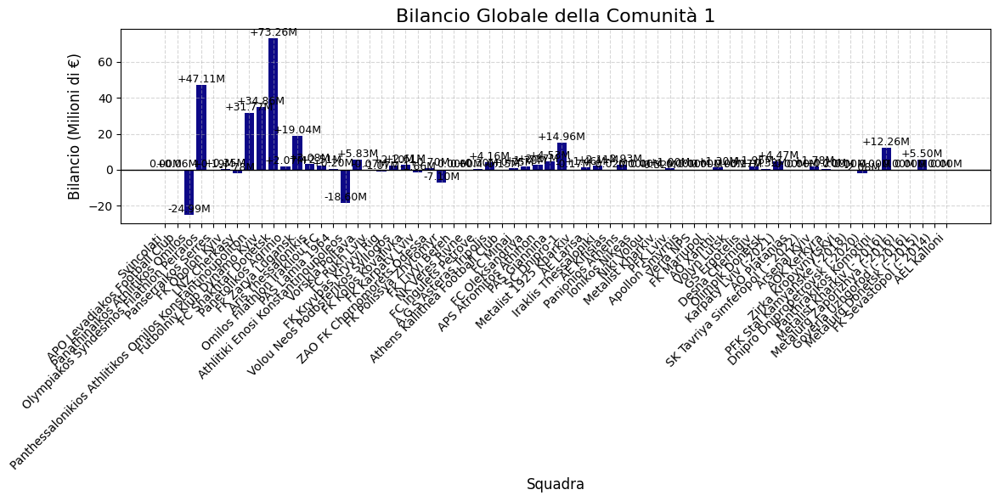

Bilancio della Comunità 1 nella Stagione 23/24 - Deviazione Standard: 3.95M, Varianza: 15.57M²


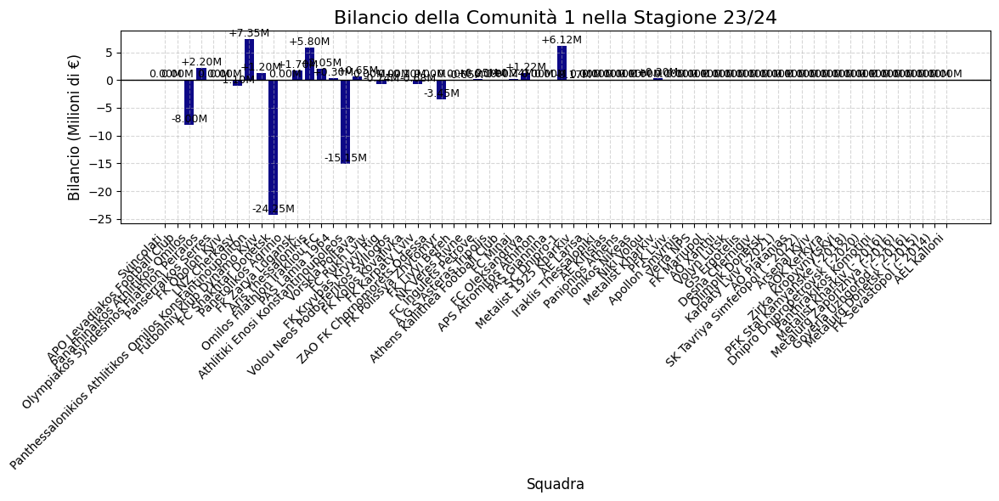

Bilancio Globale della Comunità 2 - Deviazione Standard: 45.20M, Varianza: 2043.37M²


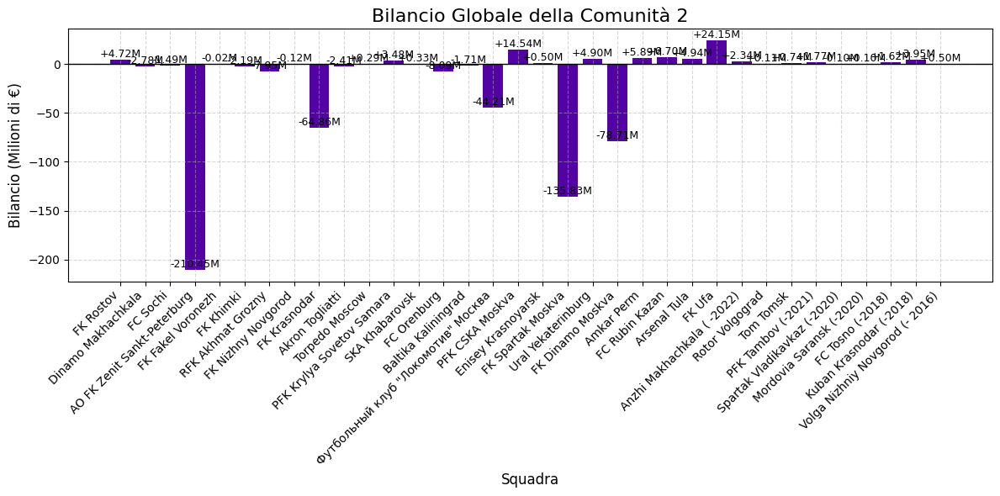

Bilancio della Comunità 2 nella Stagione 23/24 - Deviazione Standard: 6.91M, Varianza: 47.79M²


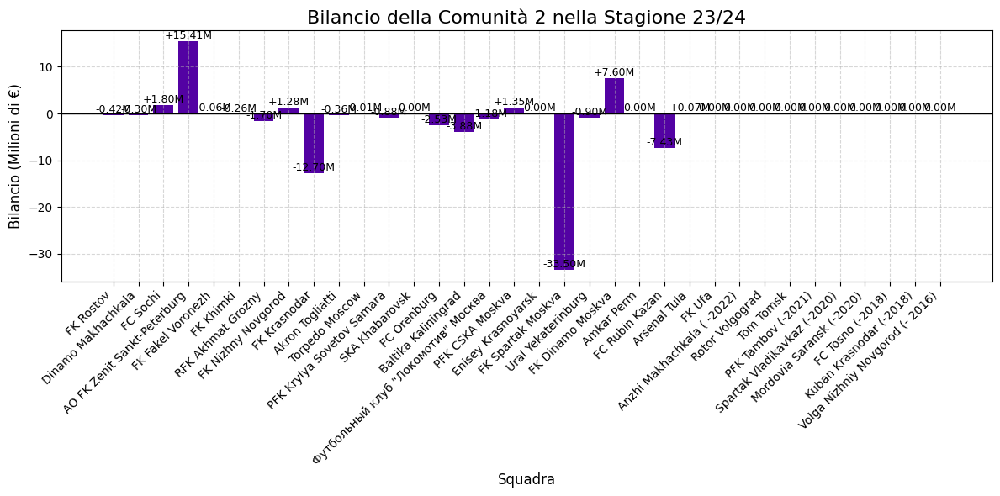

Bilancio Globale della Comunità 3 - Deviazione Standard: 155.76M, Varianza: 24259.81M²


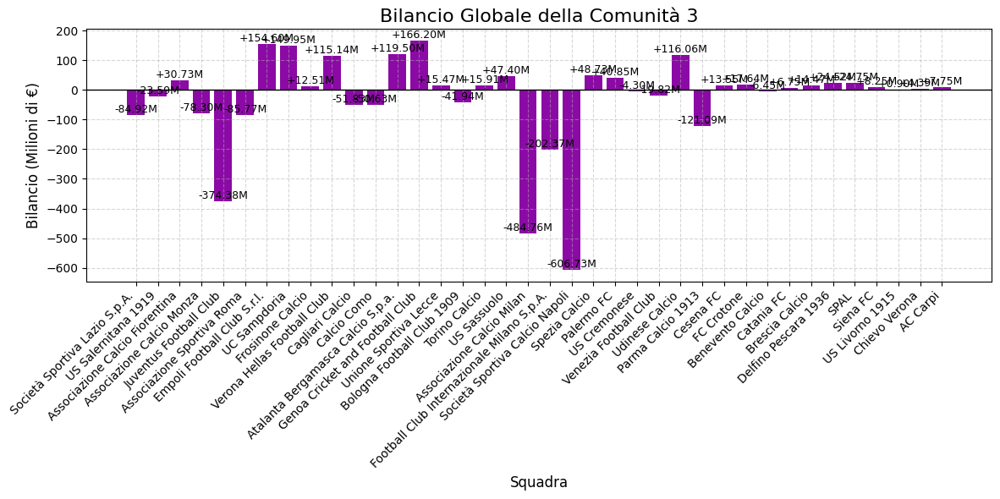

Bilancio della Comunità 3 nella Stagione 23/24 - Deviazione Standard: 29.11M, Varianza: 847.27M²


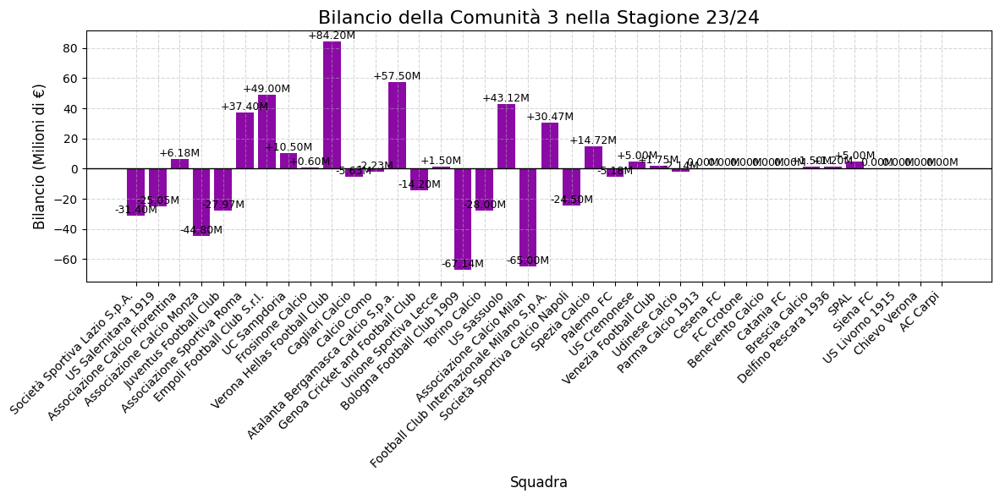

Bilancio Globale della Comunità 4 - Deviazione Standard: 162.51M, Varianza: 26407.99M²


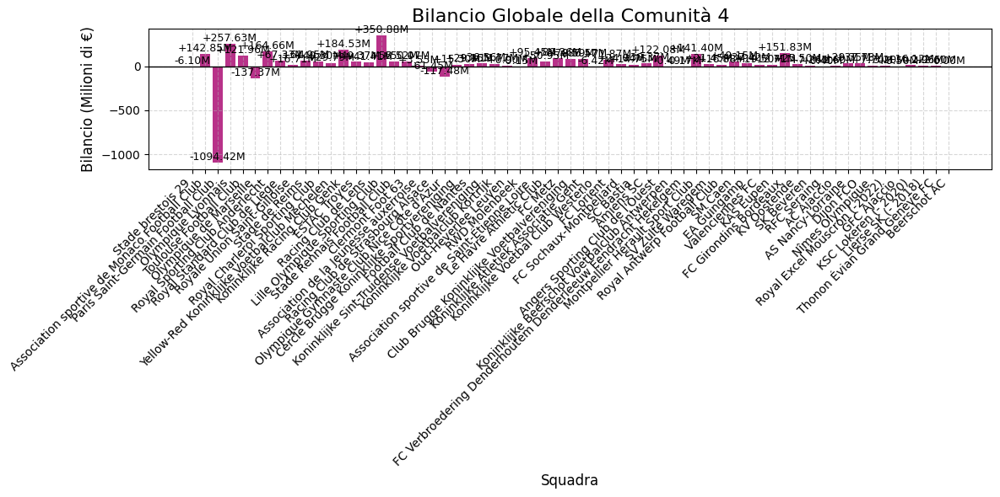

Bilancio della Comunità 4 nella Stagione 23/24 - Deviazione Standard: 56.61M, Varianza: 3204.40M²


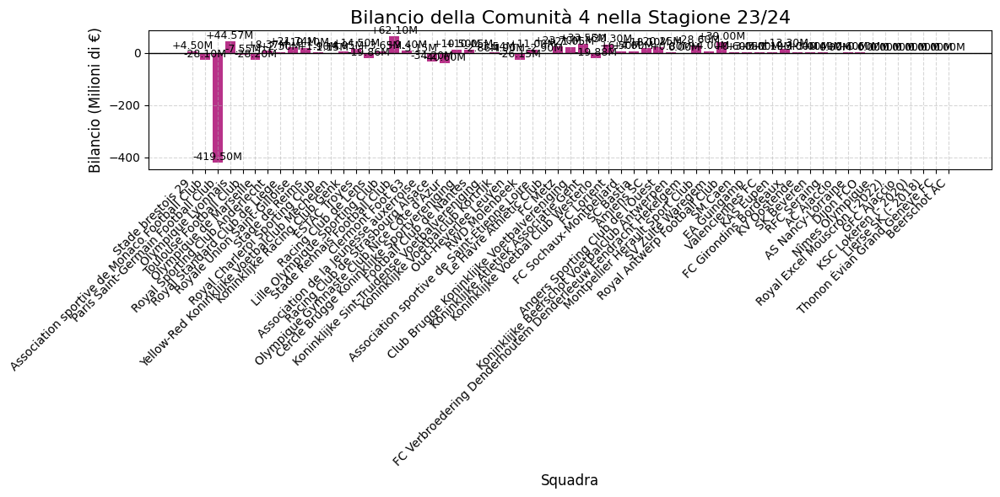

Bilancio Globale della Comunità 5 - Deviazione Standard: 346.05M, Varianza: 119753.20M²


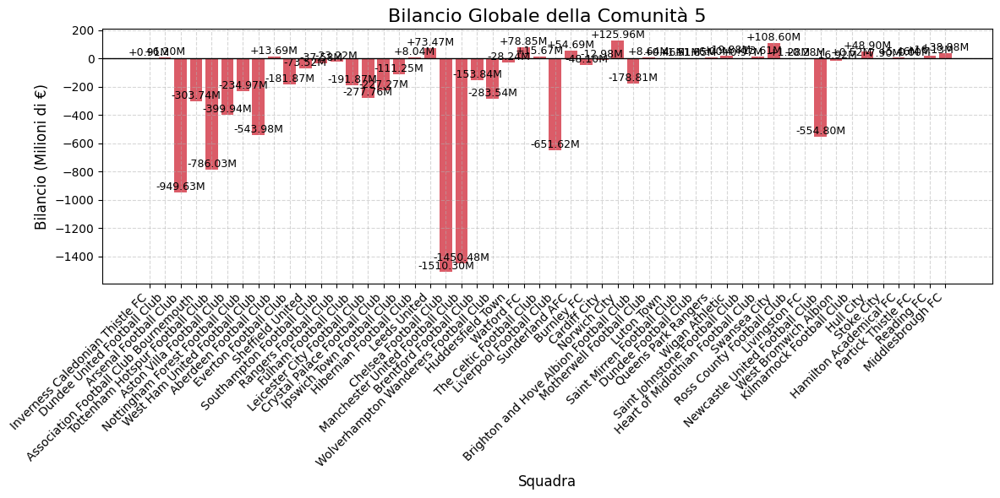

Bilancio della Comunità 5 nella Stagione 23/24 - Deviazione Standard: 68.74M, Varianza: 4724.81M²


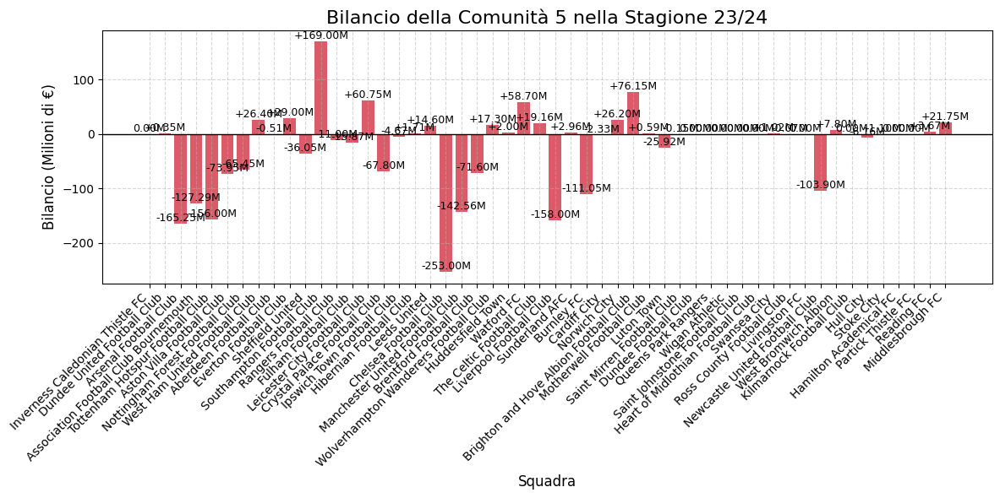

Bilancio Globale della Comunità 6 - Deviazione Standard: 200.83M, Varianza: 40331.56M²


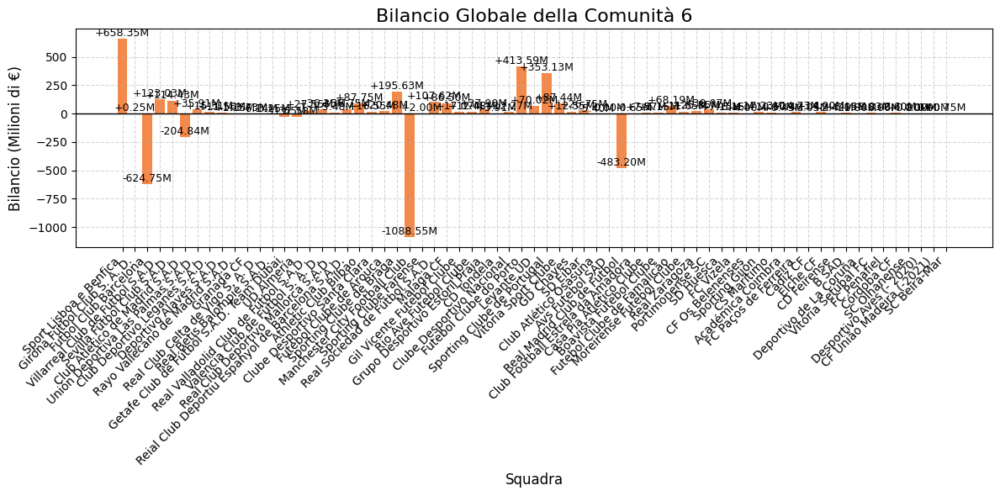

Bilancio della Comunità 6 nella Stagione 23/24 - Deviazione Standard: 31.49M, Varianza: 991.61M²


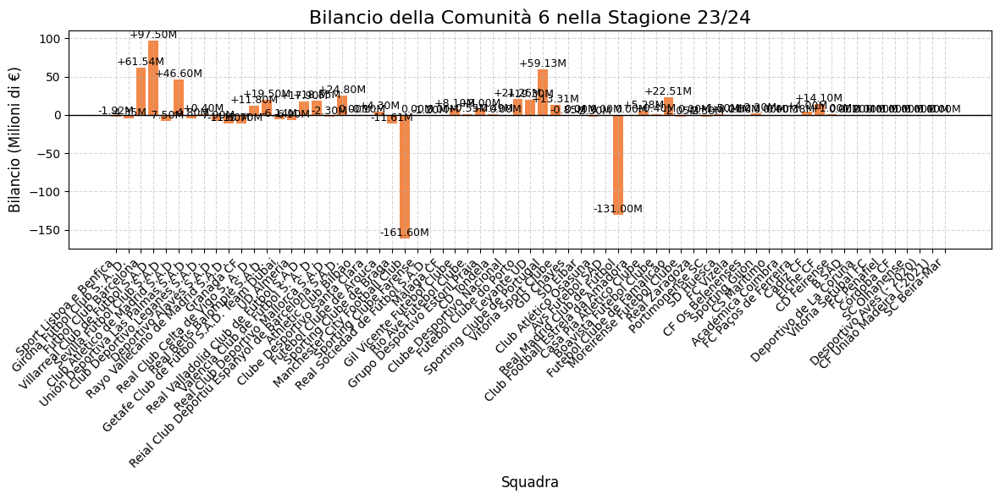

Bilancio Globale della Comunità 7 - Deviazione Standard: 22.03M, Varianza: 485.17M²


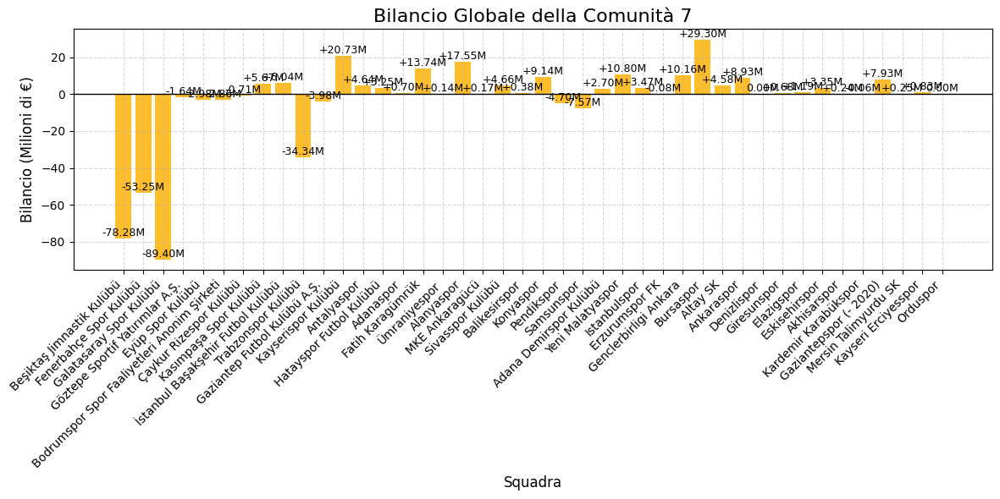

Bilancio della Comunità 7 nella Stagione 23/24 - Deviazione Standard: 5.17M, Varianza: 26.69M²


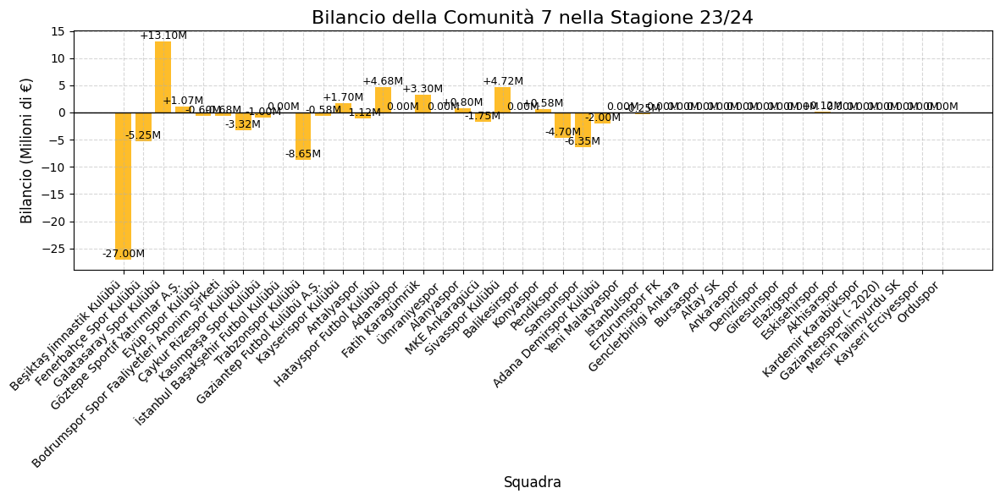

Bilancio Globale della Comunità 8 - Deviazione Standard: 95.95M, Varianza: 9205.90M²


/var/folders/zt/9ggmn83106zfjymwl_r2kkdh0000gn/T/ipykernel_58668/3335948976.py:94: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


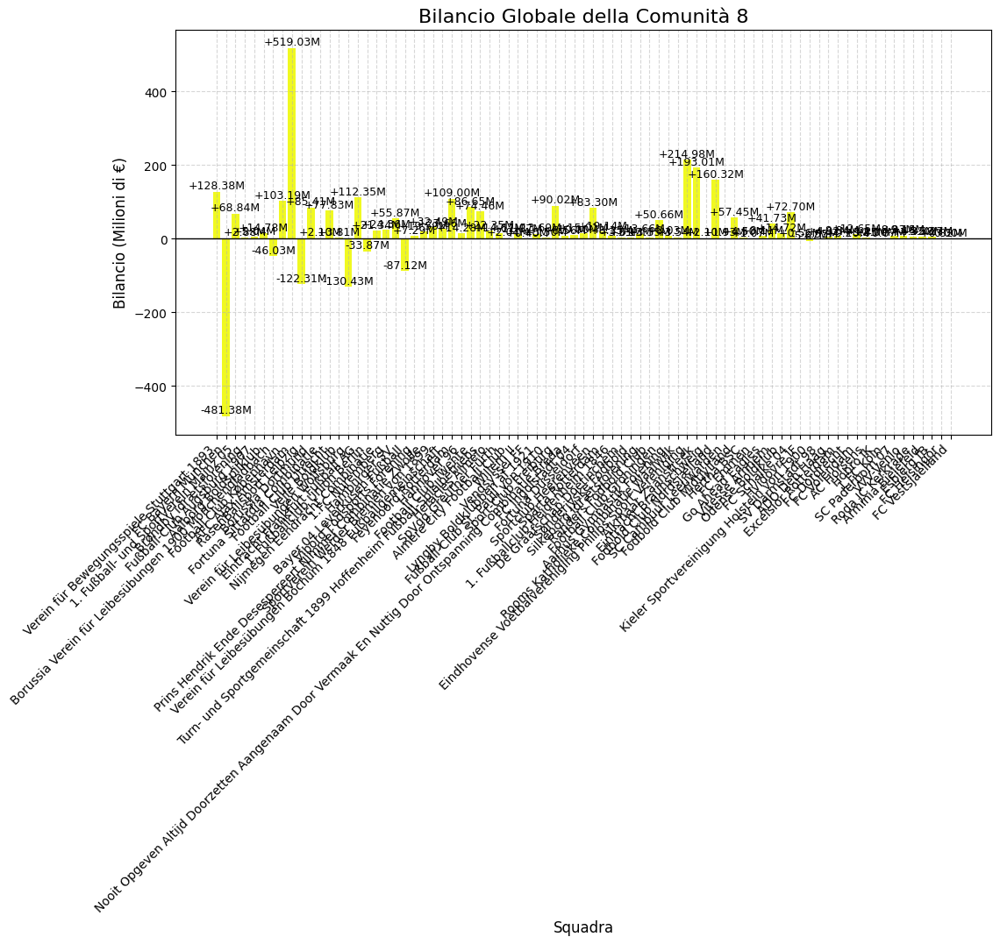

Bilancio della Comunità 8 nella Stagione 23/24 - Deviazione Standard: 16.37M, Varianza: 268.05M²


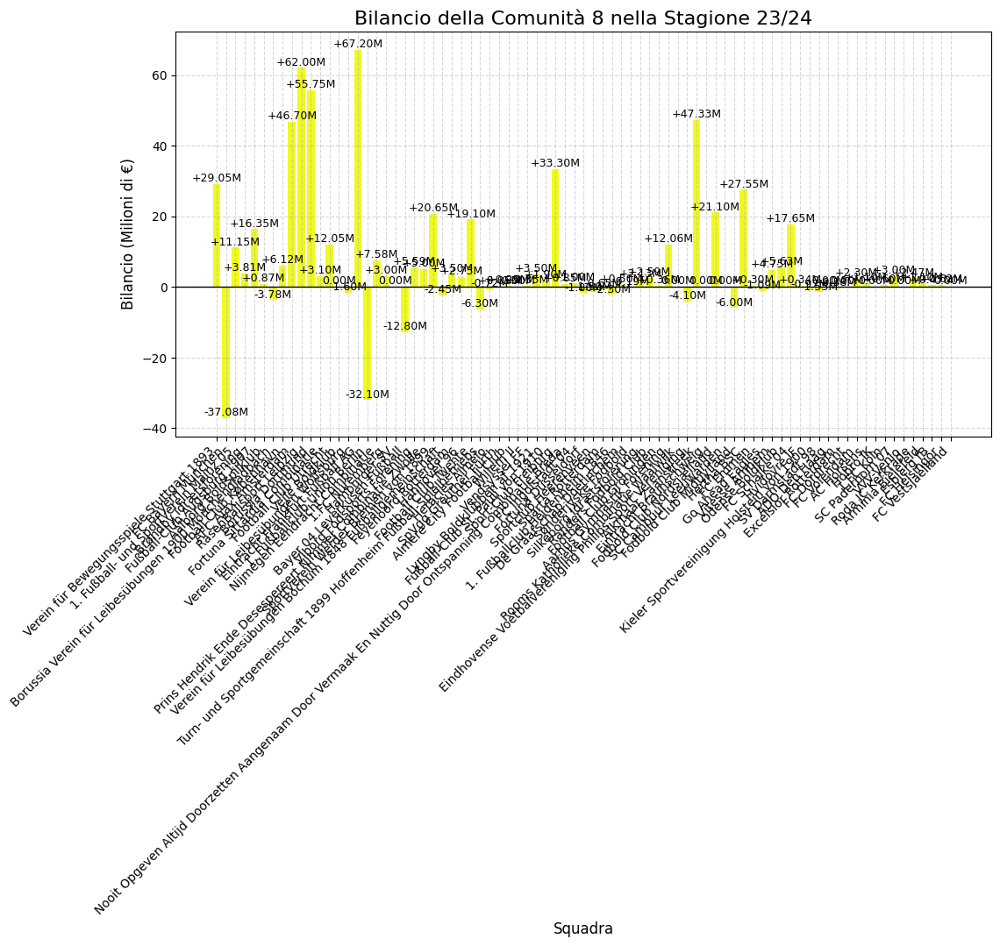

Bilancio Globale di Ogni Squadra - Deviazione Standard: 141.69M, Varianza: 20076.34M²


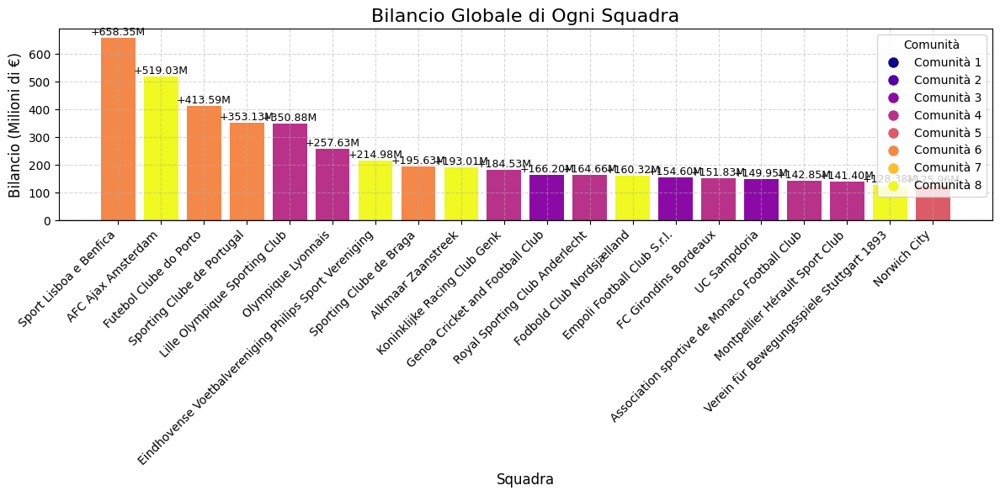

20 Squadre con il Bilancio Peggiore Globale - Deviazione Standard: 366.55M, Varianza: 134358.57M²


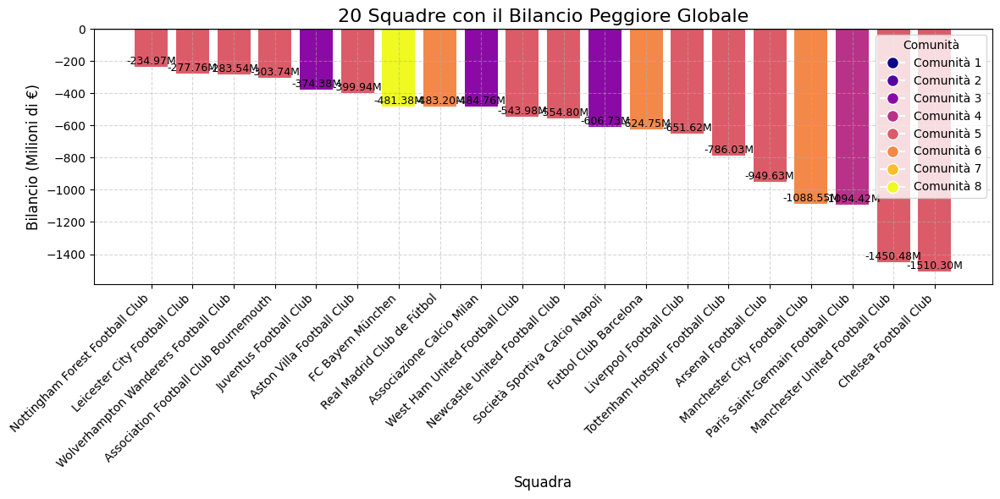

Media dei Bilanci Globali delle Comunità - Deviazione Standard: 57.86M, Varianza: 3348.35M²


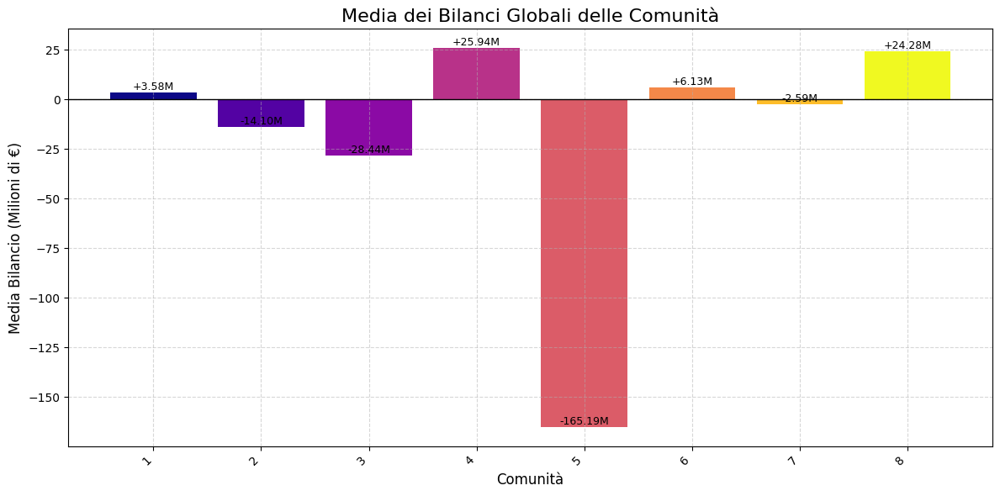

Bilancio delle Squadre nella Stagione 23/24 - Deviazione Standard: 27.78M, Varianza: 771.99M²


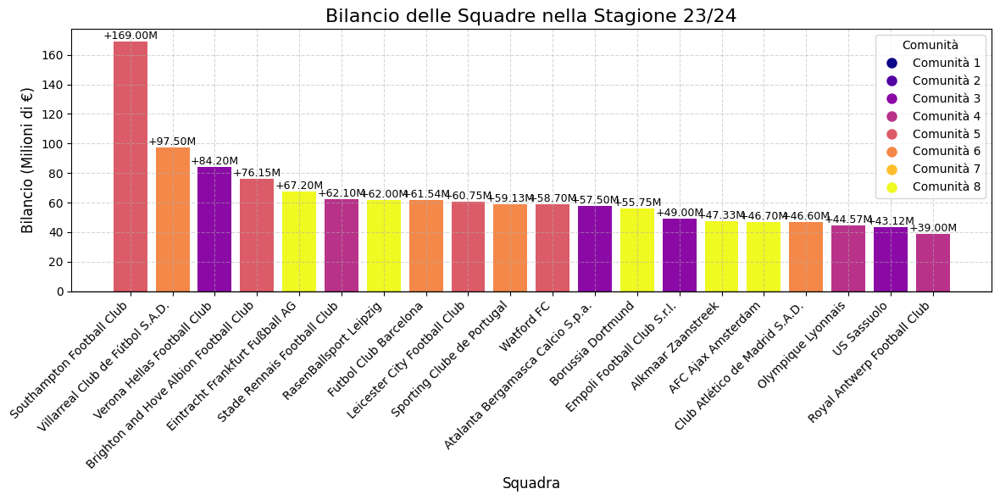

20 Squadre con il Bilancio Peggiore nella Stagione 23/24 - Deviazione Standard: 86.47M, Varianza: 7477.60M²


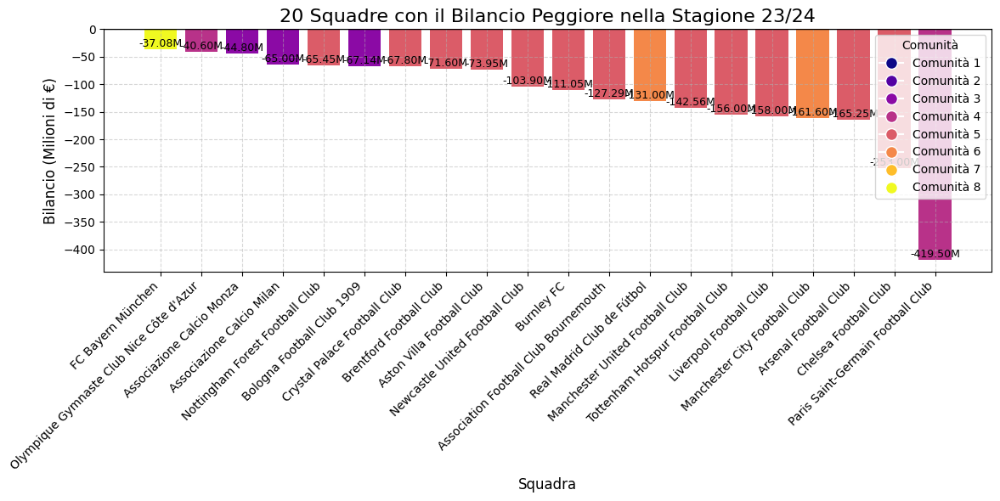

Media dei Bilanci delle Comunità nella Stagione 23/24 - Deviazione Standard: 7.27M, Varianza: 52.83M²


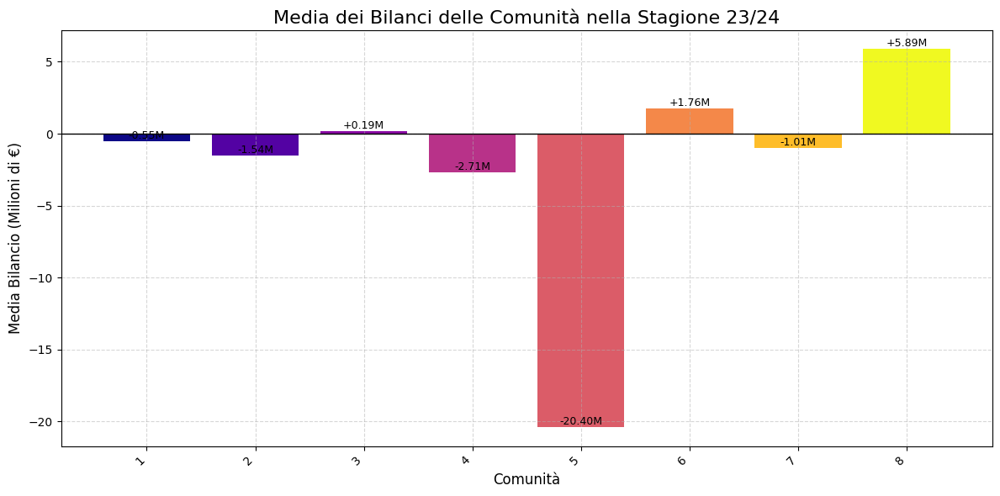

In [70]:
import numpy as np
import matplotlib.pyplot as plt

def plot_bar_chart(data, title, xlabel, ylabel, sort=False, top_n=None, community_mapping=None, community_colors=None, bar_colors=None):
    """
    Funzione per creare un istogramma a partire dai dati, con valori in milioni di euro.
    I migliori team possono essere colorati in base alla comunità cui appartengono.
    Calcola la deviazione standard e la varianza e le stampa a schermo, colorando di rosso scuro solo i valori negativi sopra l'istogramma.

    Args:
        data (dict): Dizionario con chiavi e valori da plottare.
        title (str): Titolo del grafico.
        xlabel (str): Etichetta asse X.
        ylabel (str): Etichetta asse Y.
        sort (bool): Ordinare i dati in ordine decrescente.
        top_n (int): Numero massimo di elementi da mostrare (se specificato).
        community_mapping (dict): Mappatura di ogni squadra alla sua comunità.
        community_colors (list): Colori delle comunità.
        bar_colors (list): Colori specifici per le barre.
    """
    # Ordinare i dati se richiesto
    if sort:
        data = dict(sorted(data.items(), key=lambda x: x[1], reverse=True))
    if top_n:
        data = dict(list(data.items())[:top_n])

    # Convertire i valori in milioni di euro
    data_in_millions = {key: value / 1e6 for key, value in data.items()}

    # Calcolare la deviazione standard e la varianza
    values = list(data_in_millions.values())
    std_dev = np.std(values)
    variance = np.var(values)

    # Stampare la deviazione standard e la varianza a schermo
    print(f"{title} - Deviazione Standard: {std_dev:.2f}M, Varianza: {variance:.2f}M²")
    
    # Determinare i colori basati sulla comunità, se forniti
    if community_mapping and community_colors:
        colors = [
            community_colors[community_mapping.get(team, 0) - 1] if team in community_mapping else 'gray'
            for team in data.keys()
        ]
    elif bar_colors:
        colors = bar_colors
    else:
        colors = 'skyblue'

    # Creare il grafico
    plt.figure(figsize=(12, 6))
    bars = plt.bar(
        data_in_millions.keys(),
        data_in_millions.values(),
        color=colors
    )

    # Aggiungere i valori sopra ogni colonna, colorando di rosso scuro i valori negativi
    for bar, team in zip(bars, data_in_millions.keys()):
        height = bar.get_height()
        sign = "+" if height > 0 else ""
        color = 'black' 

        plt.text(
            bar.get_x() + bar.get_width() / 2,
            height,
            f"{sign}{height:.2f}M",
            ha='center',
            va='bottom',
            fontsize=9,
            color=color
        )

    # Aggiungere la riga nera per il valore 0
    plt.axhline(0, color='black', linewidth=1)

    # Aggiungere griglia
    plt.grid(True, linestyle='--', alpha=0.5)

    # Titoli e etichette
    plt.title(title, fontsize=16)
    plt.xlabel(xlabel, fontsize=12)
    plt.ylabel(ylabel, fontsize=12)
    plt.xticks(rotation=45, ha='right', fontsize=10)

    # Aggiungere la legenda per i colori delle comunità (solo nel bilancio globale delle squadre)
    if community_mapping and community_colors:
        from matplotlib.lines import Line2D
        legend_elements = [
            Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10, label=f"Comunità {i+1}")
            for i, color in enumerate(community_colors)
        ]
        plt.legend(handles=legend_elements, title="Comunità", loc="upper right", fontsize=10)

    plt.tight_layout()
    plt.show()


# Creare la mappatura dei colori delle comunità in base al grafo
colors = plt.cm.plasma(np.linspace(0, 1, num_communities))  # Colori in base al numero di comunità

# Istogrammi separati per ogni comunità (bilanci globali)
for comm in range(1, num_communities + 1):
    # Selezioniamo i nodi della comunità
    community_nodes = [node for node, community in renumbered_partition.items() if community == comm]
    
    # Bilancio globale per i team di quella comunità
    community_team_balances = {team: global_team_balances.get(team, 0) for team in community_nodes}
    
    # Plot dei bilanci globali della comunità
    plot_bar_chart(
        community_team_balances,
        title=f"Bilancio Globale della Comunità {comm}",
        xlabel="Squadra",
        ylabel="Bilancio (Milioni di €)",
        bar_colors=[colors[comm - 1]] * len(community_team_balances)  # Colore unico per la comunità
    )

    # Bilancio delle squadre della comunità nella stagione 23/24
    community_season_balances = {team: season_team_balances.get(team, 0) for team in community_nodes}
    
    # Plot dei bilanci della stagione 23/24 della comunità
    plot_bar_chart(
        community_season_balances,
        title=f"Bilancio della Comunità {comm} nella Stagione 23/24",
        xlabel="Squadra",
        ylabel="Bilancio (Milioni di €)",
        bar_colors=[colors[comm - 1]] * len(community_season_balances)  # Colore unico per la comunità
    )


# Bilancio globale di ogni squadra con colori basati sulla comunità e legenda
plot_bar_chart(
    global_team_balances,
    title="Bilancio Globale di Ogni Squadra",
    xlabel="Squadra",
    ylabel="Bilancio (Milioni di €)",
    sort=True,
    top_n=20,  # Mostra le prime 20 squadre
    community_mapping=renumbered_partition,  # Mappa squadre -> comunità
    community_colors=list(colors)  # Colori delle comunità
)

# Bilancio globale delle 20 squadre con il bilancio peggiore (con colori per la comunità)
worst_20_global_team_balances = dict(sorted(global_team_balances.items(), key=lambda x: x[1])[:20])

plot_bar_chart(
    worst_20_global_team_balances,
    title="20 Squadre con il Bilancio Peggiore Globale",
    xlabel="Squadra",
    ylabel="Bilancio (Milioni di €)",
    sort=True,
    top_n=20,  # Mostra le 20 squadre con il bilancio peggiore
    community_mapping=renumbered_partition,  # Mappa squadre -> comunità
    community_colors=list(colors)  # Colori delle comunità
)

# Media dei bilanci globali delle comunità (con legenda)
plot_bar_chart(
    global_community_balances,
    title="Media dei Bilanci Globali delle Comunità",
    xlabel="Comunità",
    ylabel="Media Bilancio (Milioni di €)",
    bar_colors=list(colors[:len(global_community_balances)])
)

# Bilancio delle squadre nella stagione 23/24 (con colori per la comunità)
plot_bar_chart(
    season_team_balances,
    title="Bilancio delle Squadre nella Stagione 23/24",
    xlabel="Squadra",
    ylabel="Bilancio (Milioni di €)",
    sort=True,
    top_n=20,  # Mostra le prime 20 squadre
    community_mapping=renumbered_partition,  # Mappa squadre -> comunità
    community_colors=list(colors)  # Colori delle comunità
)

# Bilancio delle 20 squadre con il bilancio peggiore nella stagione 23/24 (con colori per la comunità)
worst_20_season_team_balances = dict(sorted(season_team_balances.items(), key=lambda x: x[1])[:20])

plot_bar_chart(
    worst_20_season_team_balances,
    title="20 Squadre con il Bilancio Peggiore nella Stagione 23/24",
    xlabel="Squadra",
    ylabel="Bilancio (Milioni di €)",
    sort=True,
    top_n=20,  # Mostra le 20 squadre con il bilancio peggiore
    community_mapping=renumbered_partition,  # Mappa squadre -> comunità
    community_colors=list(colors)  # Colori delle comunità
)

# Media dei bilanci delle comunità nella stagione 23/24 (con colori per la comunità)
plot_bar_chart(
    season_community_balances,
    title="Media dei Bilanci delle Comunità nella Stagione 23/24",
    xlabel="Comunità",
    ylabel="Media Bilancio (Milioni di €)",
    bar_colors=list(colors[:len(season_community_balances)])
)

/var/folders/zt/9ggmn83106zfjymwl_r2kkdh0000gn/T/ipykernel_58668/3553506142.py:79: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)


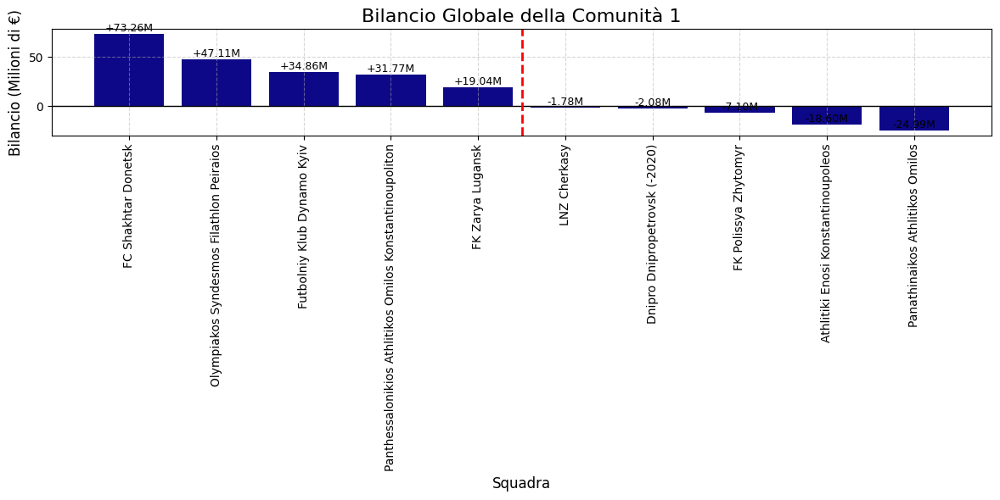

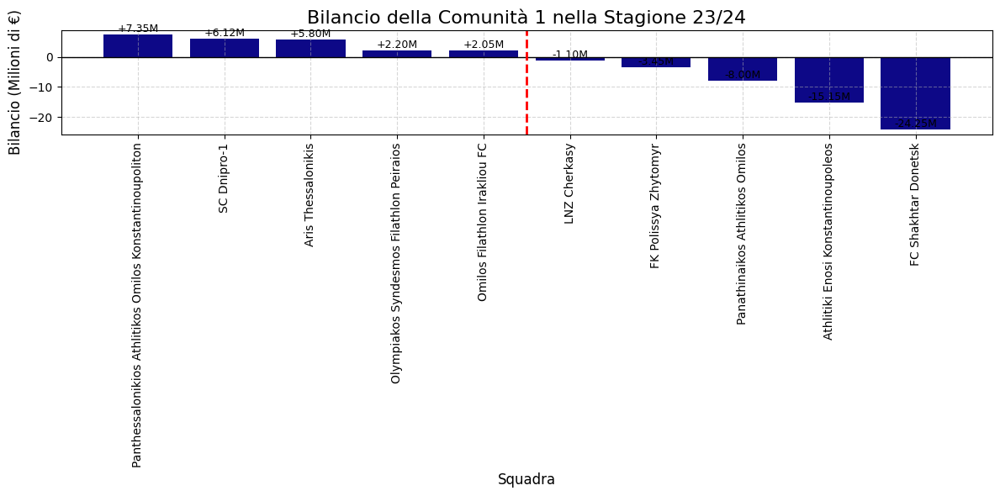

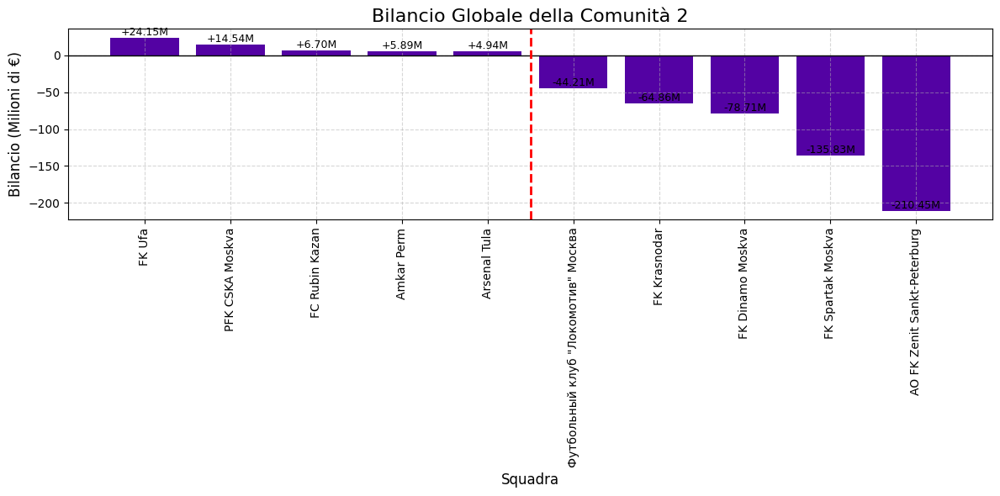

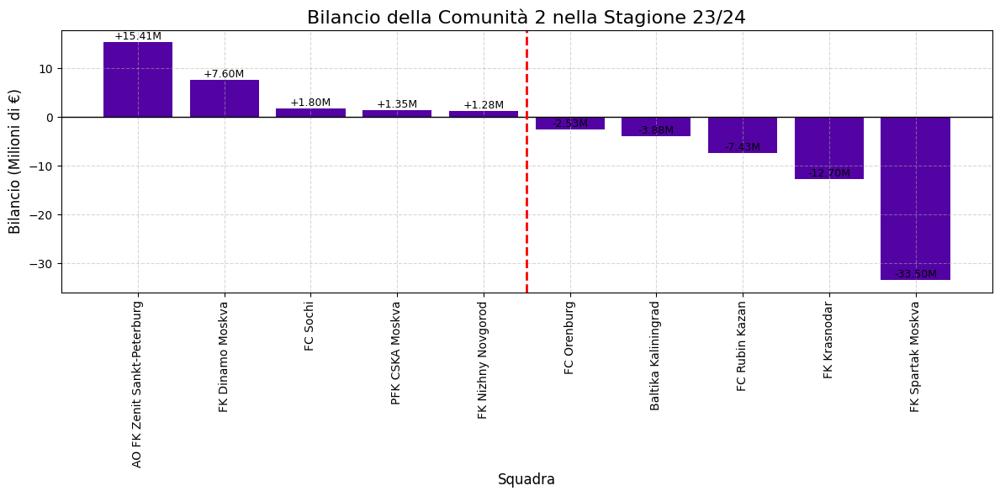

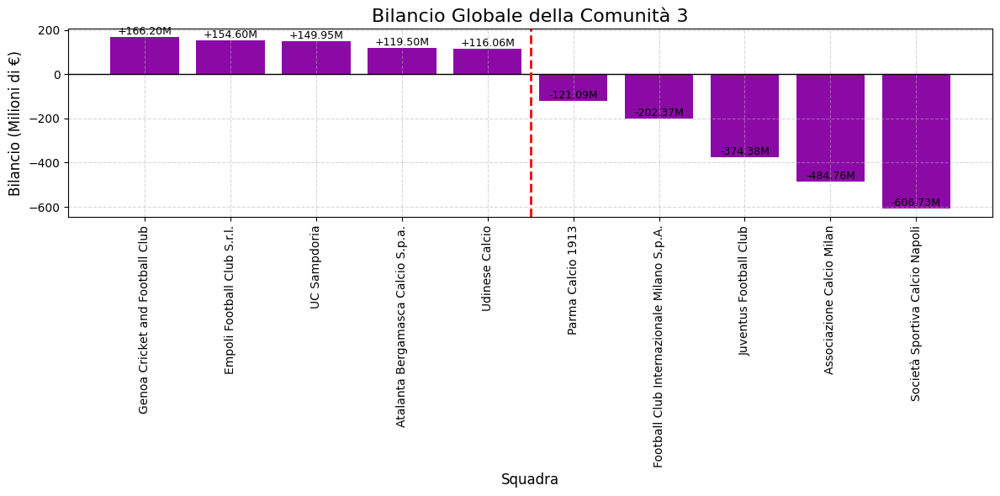

...

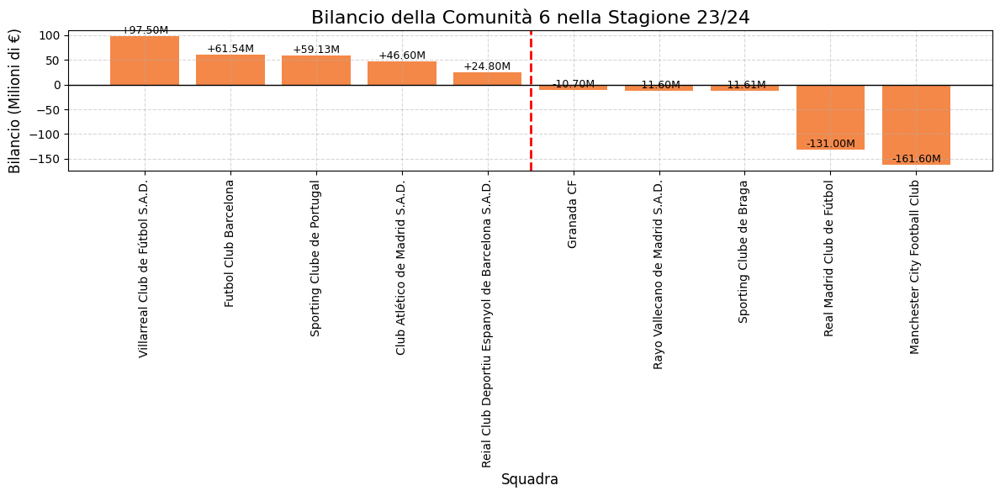

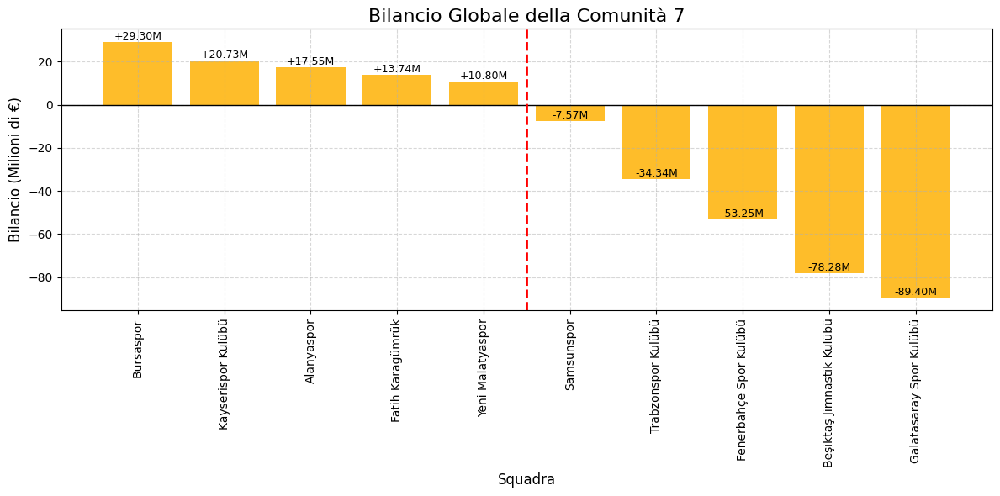

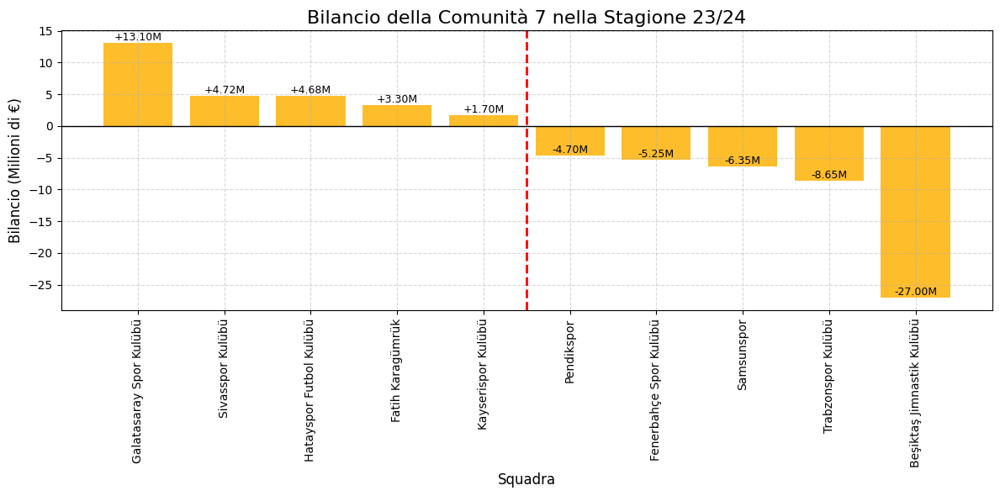

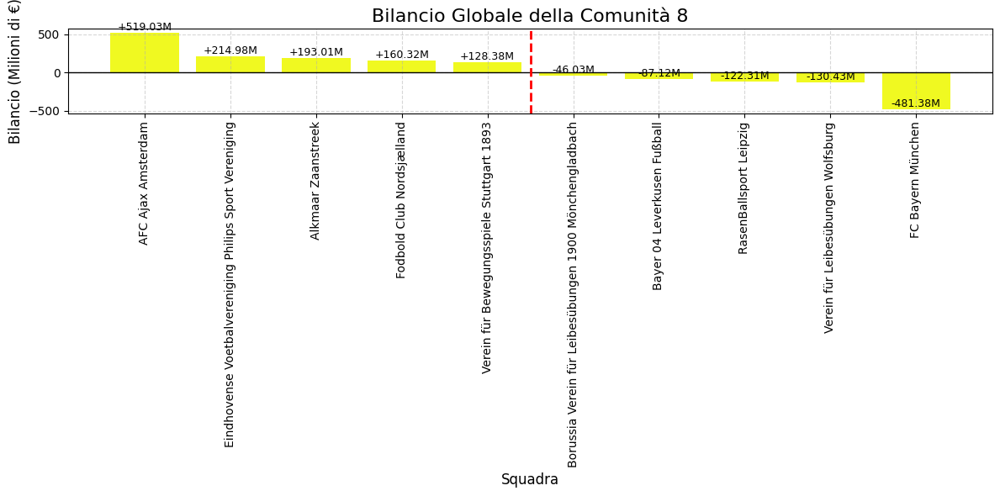

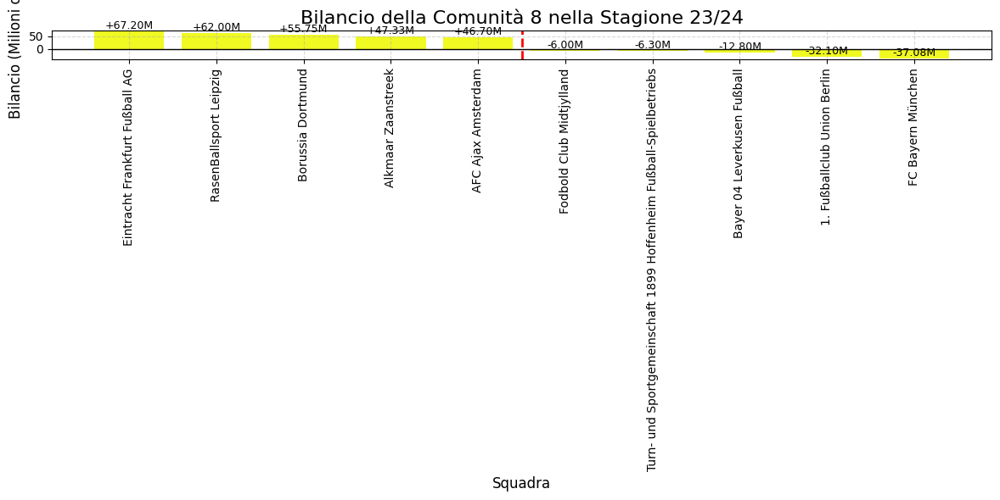

In [71]:
def plot_bar_chart(data, title, xlabel, ylabel, sort=False, top_n=None, community_mapping=None, community_colors=None, bar_colors=None, line_position=None):
    """
    Funzione per creare un istogramma a partire dai dati, con valori in milioni di euro.
    I migliori team possono essere colorati in base alla comunità cui appartengono.

    Args:
        data (dict): Dizionario con chiavi e valori da plottare.
        title (str): Titolo del grafico.
        xlabel (str): Etichetta asse X.
        ylabel (str): Etichetta asse Y.
        sort (bool): Ordinare i dati in ordine decrescente.
        top_n (int): Numero massimo di elementi da mostrare (se specificato).
        community_mapping (dict): Mappatura di ogni squadra alla sua comunità.
        community_colors (list): Colori delle comunità.
        bar_colors (list): Colori specifici per le barre.
        line_position (int): Posizione della linea rossa verticale per separare i migliori e peggiori club.
    """
    # Ordinare i dati se richiesto
    if sort:
        data = dict(sorted(data.items(), key=lambda x: x[1], reverse=True))
    if top_n:
        data = dict(list(data.items())[:top_n])

    # Convertire i valori in milioni di euro
    data_in_millions = {key: value / 1e6 for key, value in data.items()}

    # Determinare i colori basati sulla comunità, se forniti
    if community_mapping and community_colors:
        colors = [
            community_colors[community_mapping.get(team, 0) - 1] if team in community_mapping else 'gray'
            for team in data.keys()
        ]
    elif bar_colors:
        colors = bar_colors
    else:
        colors = 'skyblue'

    # Creare il grafico
    plt.figure(figsize=(12, 6))
    bars = plt.bar(
        data_in_millions.keys(),
        data_in_millions.values(),
        color=colors
    )

    # Aggiungere i valori sopra ogni colonna
    for bar in bars:
        height = bar.get_height()
        sign = "+" if height > 0 else ""
        plt.text(
            bar.get_x() + bar.get_width() / 2,
            height,
            f"{sign}{height:.2f}M",
            ha='center',
            va='bottom',
            fontsize=9,
            color='black'
        )

    # Aggiungere la riga nera per il valore 0
    plt.axhline(0, color='black', linewidth=1)

    # Aggiungere la linea rossa verticale per separare i migliori e peggiori club
    if line_position is not None:
        plt.axvline(x=line_position, color='red', linestyle='--', linewidth=2)

    # Aggiungere griglia
    plt.grid(True, linestyle='--', alpha=0.5)

    # Titoli e etichette
    plt.title(title, fontsize=16)
    plt.xlabel(xlabel, fontsize=12)
    plt.ylabel(ylabel, fontsize=12)
    
    # Ruotare i nomi delle squadre in verticale
    plt.xticks(rotation=90, ha='center', fontsize=10)

    # Rimuovere la legenda
    plt.legend().set_visible(False)

    plt.tight_layout()
    plt.show()

# Codice per generare i grafici
for comm in range(1, num_communities + 1):
    # Selezioniamo i nodi della comunità
    community_nodes = [node for node, community in renumbered_partition.items() if community == comm]
    
    # Bilancio globale per i team di quella comunità
    community_team_balances = {team: global_team_balances.get(team, 0) for team in community_nodes}
    
    # Ordinare i bilanci in ordine decrescente
    sorted_community_balances = dict(sorted(community_team_balances.items(), key=lambda x: x[1], reverse=True))

    # Prendere i 5 migliori e i 5 peggiori club
    best_5 = list(sorted_community_balances.items())[:5]
    worst_5 = list(sorted_community_balances.items())[-5:]

    # Unire i 5 migliori e peggiori in un solo dizionario
    combined_balances = dict(best_5 + worst_5)

    # Trova la posizione dove separare i migliori dai peggiori (la linea rossa verticale)
    line_position = len(best_5)

    # Plot dei bilanci globali della comunità con la separazione tra i migliori e peggiori
    plot_bar_chart(
        combined_balances,
        title=f"Bilancio Globale della Comunità {comm}",
        xlabel="Squadra",
        ylabel="Bilancio (Milioni di €)",
        line_position=4.5,  # Aggiungere la linea rossa verticale
        community_mapping=renumbered_partition,  # Mappa squadre -> comunità
        community_colors=[colors[comm - 1]] * len(combined_balances)  # Colore unico per la comunità
    )

    # Bilancio delle squadre della comunità nella stagione 23/24
    community_season_balances = {team: season_team_balances.get(team, 0) for team in community_nodes}
    
    # Ordinare i bilanci della stagione 23/24 in ordine decrescente
    sorted_community_season_balances = dict(sorted(community_season_balances.items(), key=lambda x: x[1], reverse=True))

    # Prendere i 5 migliori e i 5 peggiori club nella stagione 23/24
    best_5_season = list(sorted_community_season_balances.items())[:5]
    worst_5_season = list(sorted_community_season_balances.items())[-5:]

    # Unire i 5 migliori e peggiori nella stagione 23/24
    combined_balances_season = dict(best_5_season + worst_5_season)

    # Trova la posizione dove separare i migliori dai peggiori (la linea rossa verticale)
    line_position_season = len(best_5_season)

    # Plot dei bilanci della stagione 23/24 della comunità con la separazione tra i migliori e peggiori
    plot_bar_chart(
        combined_balances_season,
        title=f"Bilancio della Comunità {comm} nella Stagione 23/24",
        xlabel="Squadra",
        ylabel="Bilancio (Milioni di €)",
        line_position=4.5,  # Aggiungere la linea rossa verticale
        community_mapping=renumbered_partition,  # Mappa squadre -> comunità
        community_colors=[colors[comm - 1]] * len(combined_balances_season)  # Colore unico per la comunità
    )

Ora calcoliamo le matrici di correlazione delle comunità valutando quanto i club di ogni comunità siano uniformi tra loro

Errore: squadra con nome Svincolati non trovata in clubs_df.
Attenzione: le seguenti squadre non sono presenti nel DataFrame per la comunità 1: ['Svincolati']
Attenzione: la squadra Svincolati non è nel DataFrame delle caratteristiche.
Indice di Similarità Medio per la Comunità 1: 0.5653


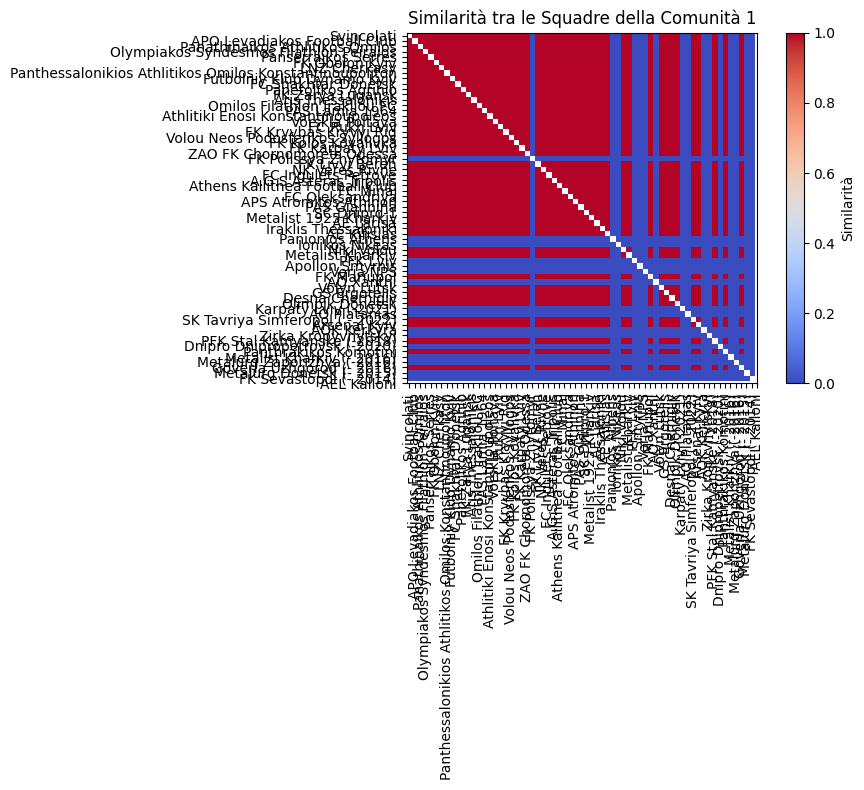

Indice di Similarità Medio per la Comunità 2: 0.9998


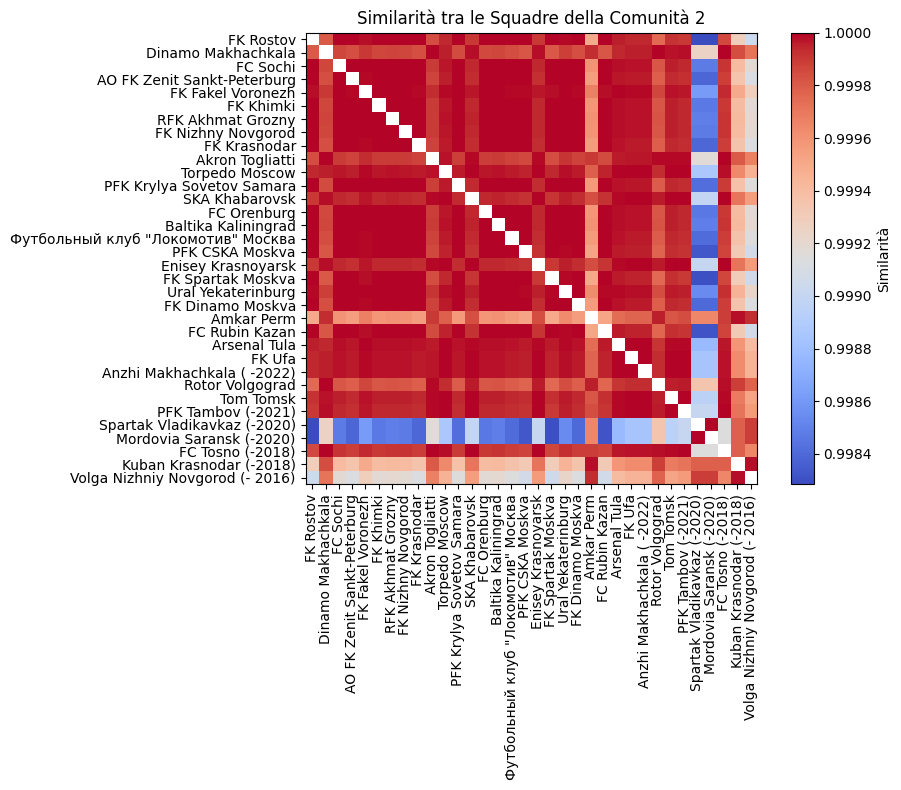

Indice di Similarità Medio per la Comunità 3: 0.9999


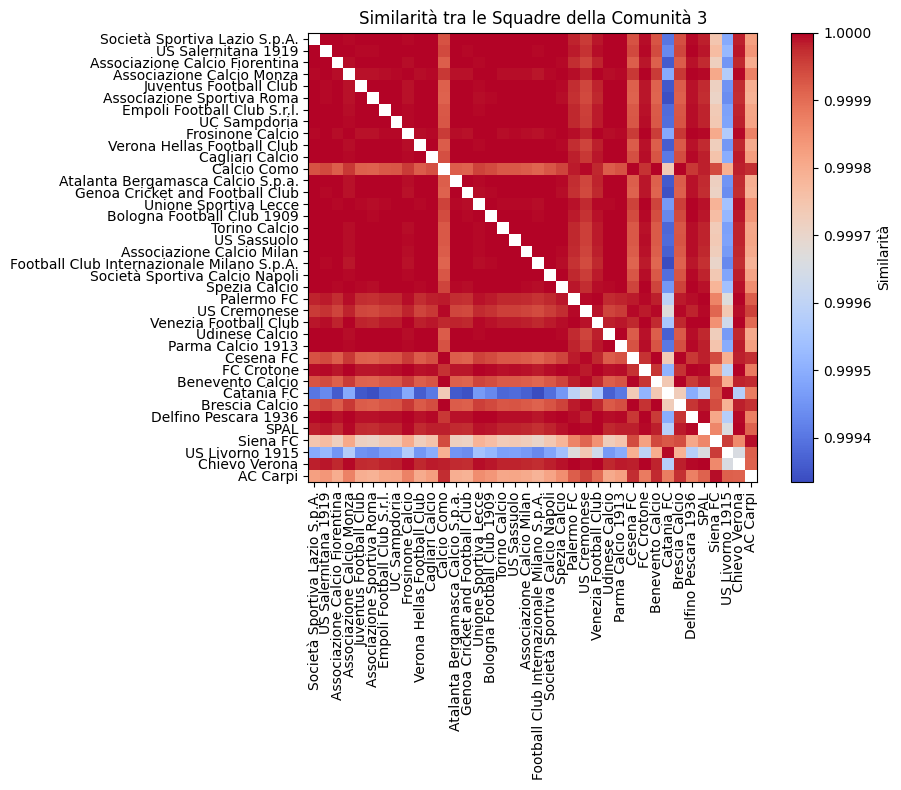

Indice di Similarità Medio per la Comunità 4: 0.9672


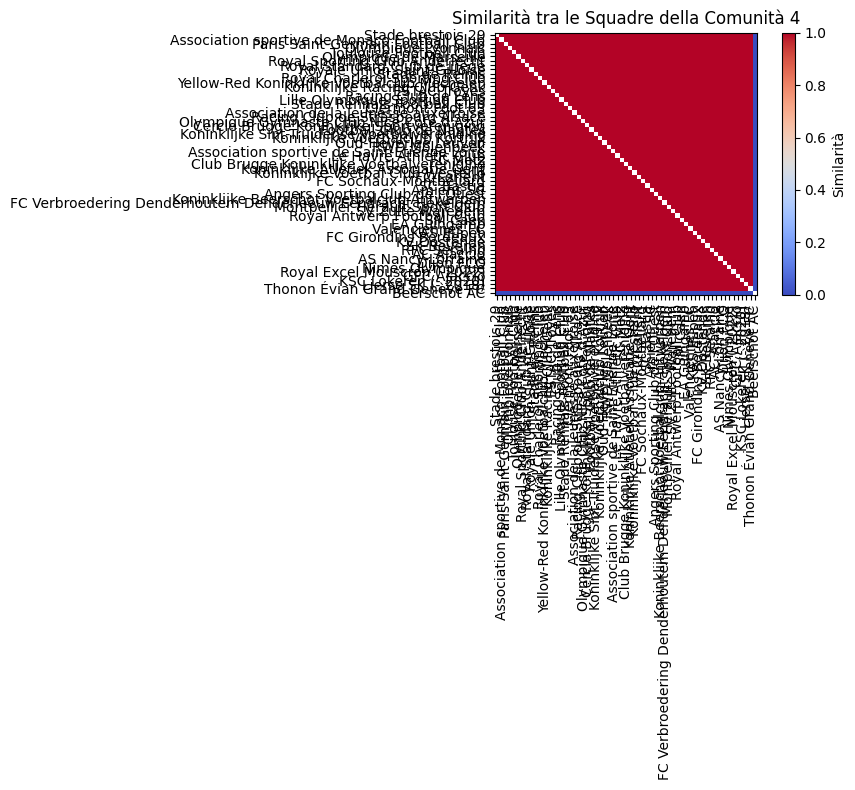

Indice di Similarità Medio per la Comunità 5: 0.9615


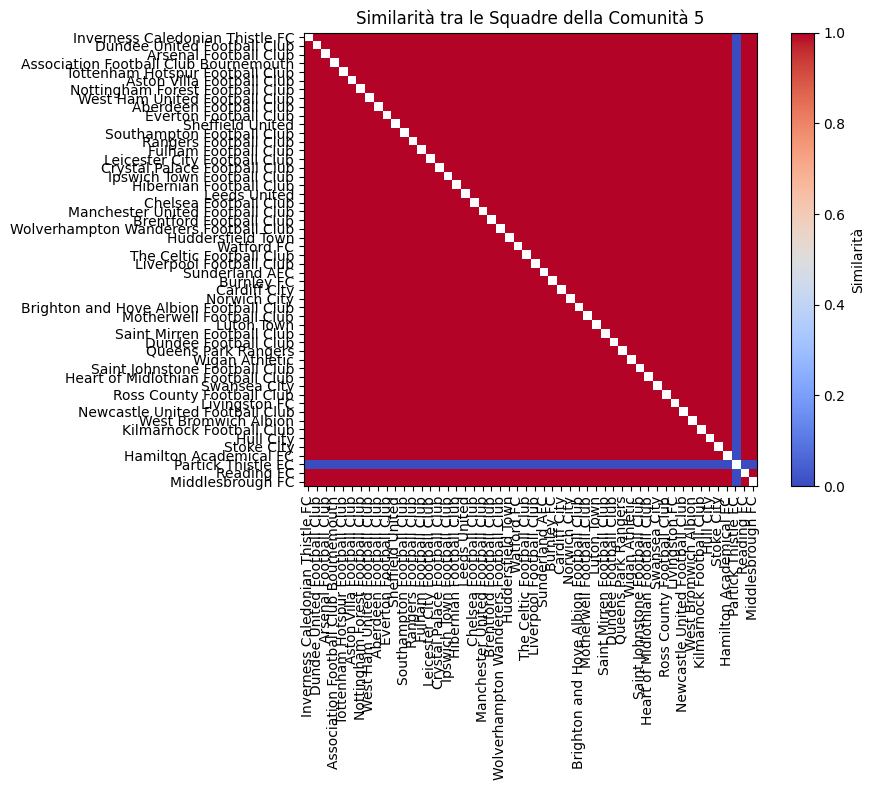

Indice di Similarità Medio per la Comunità 6: 0.8833


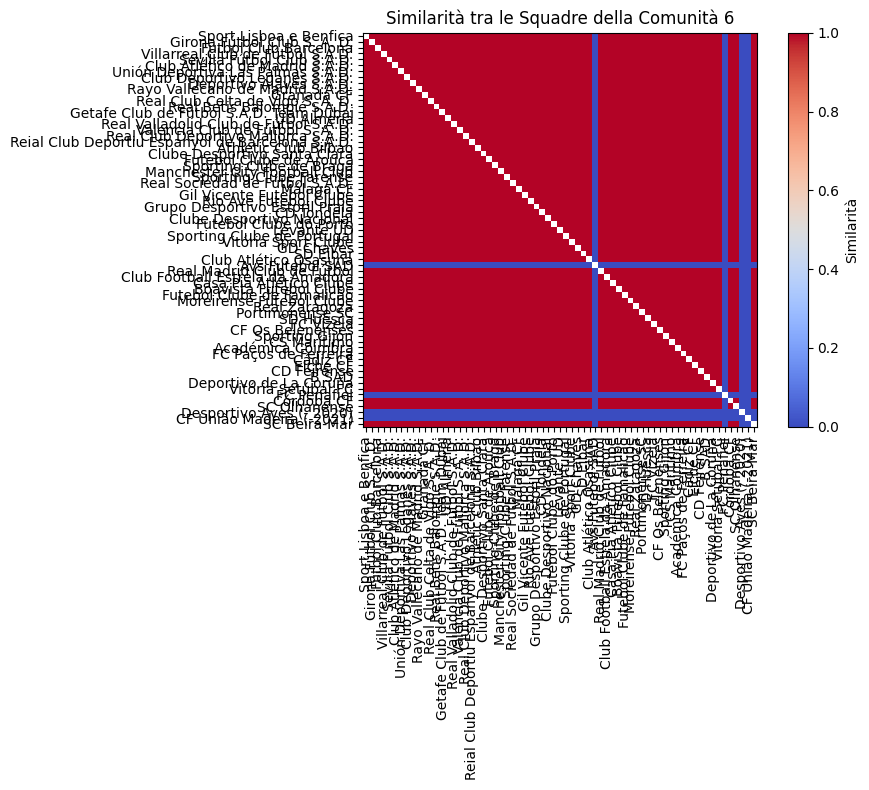

Indice di Similarità Medio per la Comunità 7: 0.9053


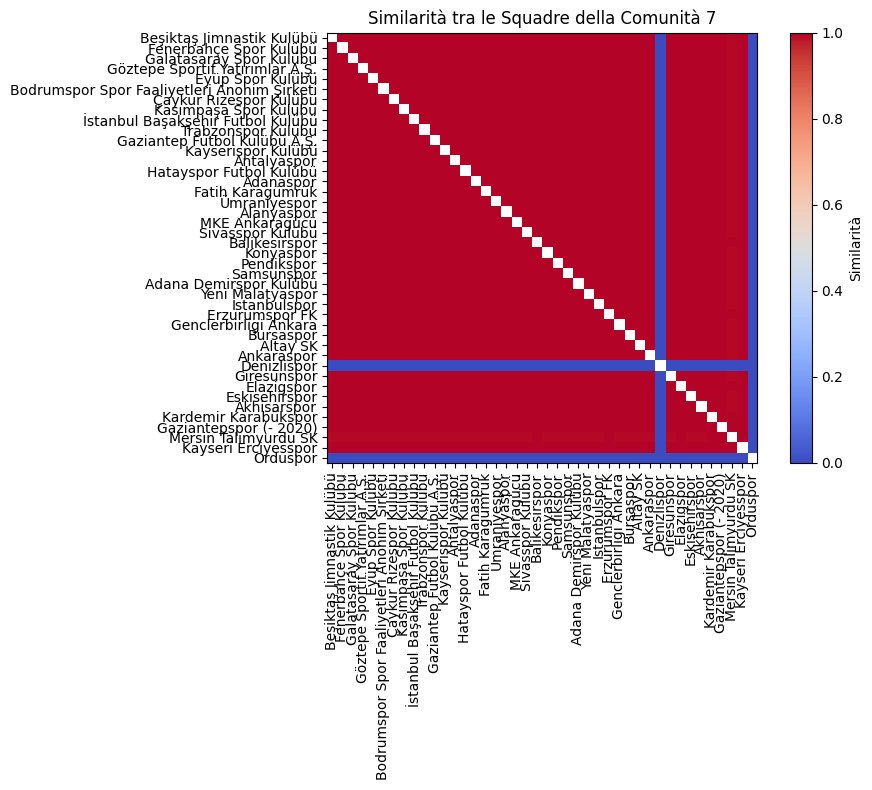

Indice di Similarità Medio per la Comunità 8: 0.9746


/var/folders/zt/9ggmn83106zfjymwl_r2kkdh0000gn/T/ipykernel_58668/533782618.py:129: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()  # Migliora l'adattamento


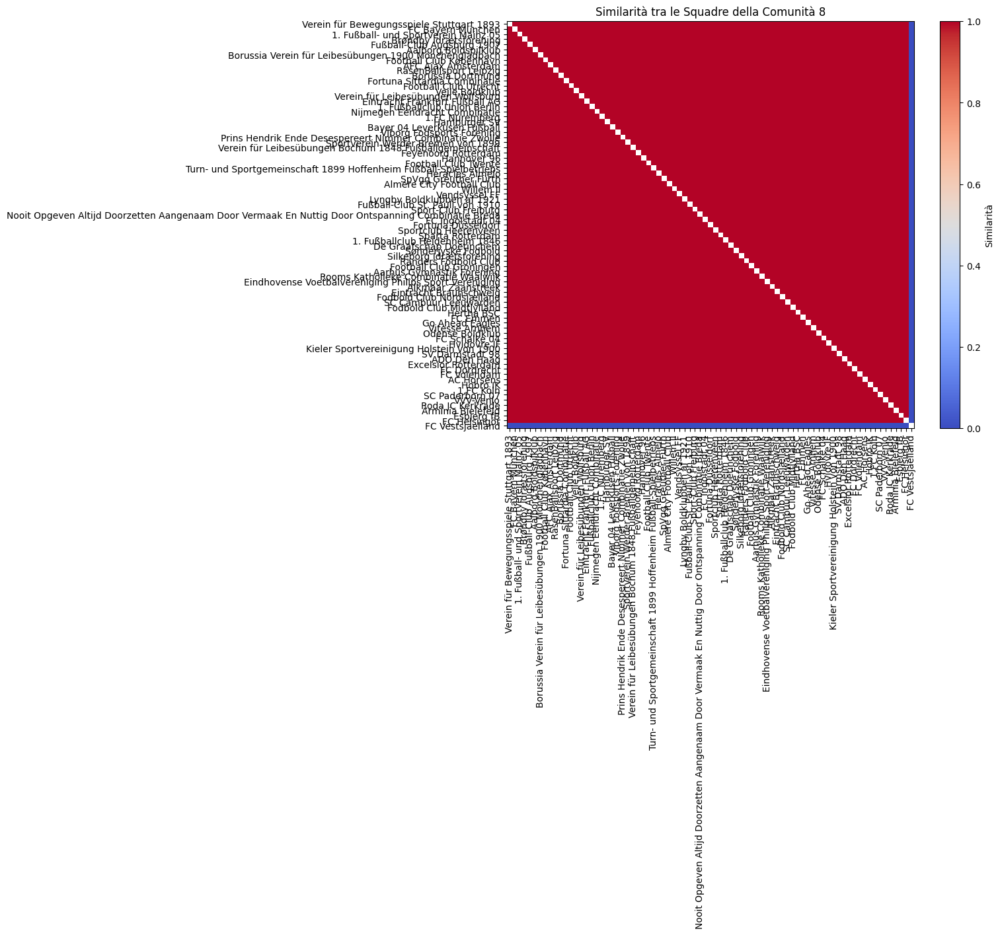

In [74]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity
import community as community_louvain
import os

def get_team_features(transfers_df, clubs_df, renumbered_partition):
    """
    Estrae le caratteristiche delle squadre da un DataFrame di trasferimenti e club.
    """
    club_id_to_name = dict(zip(clubs_df['club_id'], clubs_df['name']))
    team_features = []
    
    # Mappiamo i nomi alle squadre
    name_to_id = dict(zip(clubs_df['name'], clubs_df['club_id']))

    for team_name, community in renumbered_partition.items():
        # Ottieni l'ID della squadra tramite il nome
        team_id = name_to_id.get(team_name)
        if not team_id:
            print(f"Errore: squadra con nome {team_name} non trovata in clubs_df.")
            continue
        
        # Trova i trasferimenti per la squadra con l'ID corretto
        transfers = transfers_df[(transfers_df["from_club_id"] == team_id) | (transfers_df["to_club_id"] == team_id)]
        
        total_transfer_fee = transfers['transfer_fee'].sum()
        average_transfer_fee = transfers['transfer_fee'].mean() if not transfers.empty else 0

        # Aggiungere le caratteristiche della squadra
        team_features.append({
            'Team': team_name,
            'Total Transfer Fee': total_transfer_fee,
            'Average Transfer Fee': average_transfer_fee
        })
    
    return pd.DataFrame(team_features)

def calculate_similarity(df_features):
    """
    Calcola la matrice di similarità tra le squadre utilizzando la correlazione del coseno.
    
    Args:
        df_features (pd.DataFrame): DataFrame contenente le caratteristiche delle squadre.
        
    Returns:
        np.ndarray: Matrice di similarità tra le squadre.
    """
    feature_columns = ['Total Transfer Fee', 'Average Transfer Fee']
    features = df_features[feature_columns].values
    similarity_matrix = cosine_similarity(features)
    return similarity_matrix

def calculate_average_similarity(similarity_matrix):
    """
    Calcola l'indice di similarità medio per una matrice di similarità.
    
    Args:
        similarity_matrix (np.ndarray): Matrice di similarità tra le squadre.
        
    Returns:
        float: Indice di similarità medio.
    """
    np.fill_diagonal(similarity_matrix, np.nan)
    mean_similarity = np.nanmean(similarity_matrix)
    return mean_similarity

def plot_all_community_similarities(df_features, similarity_matrix, renumbered_partition, output_dir='community_similarities'):
    """
    Calcola e visualizza la similarità tra le squadre per ogni comunità, e salva le immagini.
    
    Args:
        df_features (pd.DataFrame): Caratteristiche delle squadre.
        similarity_matrix (np.ndarray): Matrice di similarità tra le squadre.
        renumbered_partition (dict): Mappatura dei nodi alle comunità.
        output_dir (str): Directory dove salvare le immagini.
    """
    num_communities = len(set(renumbered_partition.values()))
    
    # Creare la cartella per salvare le immagini, se non esiste
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    for comm in range(1, num_communities + 1):
        community_teams = [team for team, comm_id in renumbered_partition.items() if comm_id == comm]
        
        if not community_teams:
            print(f"Attenzione: la comunità {comm} non contiene squadre.")
            continue
        
        community_features = df_features[df_features["Team"].isin(community_teams)]
        
        if community_features.empty:
            print(f"Attenzione: nessuna caratteristica trovata per le squadre nella comunità {comm}.")
            continue
        
        missing_teams = [team for team in community_teams if team not in df_features["Team"].values]
        if missing_teams:
            print(f"Attenzione: le seguenti squadre non sono presenti nel DataFrame per la comunità {comm}: {missing_teams}")

        community_indices = []
        for team in community_teams:
            team_index = df_features[df_features["Team"] == team].index
            if not team_index.empty:
                community_indices.append(team_index[0])
            else:
                print(f"Attenzione: la squadra {team} non è nel DataFrame delle caratteristiche.")

        if not community_indices:
            print(f"Errore: nessuna squadra valida trovata per la comunità {comm}.")
            continue

        community_similarity_matrix = similarity_matrix[community_indices, :][:, community_indices]

        avg_similarity = calculate_average_similarity(community_similarity_matrix)
        print(f"Indice di Similarità Medio per la Comunità {comm}: {avg_similarity:.4f}")

        plt.figure(figsize=(10, 8))
        plt.imshow(community_similarity_matrix, cmap="coolwarm", interpolation="nearest")
        plt.colorbar(label="Similarità")

        plt.xticks(range(len(community_teams)), community_teams, rotation=90)
        plt.yticks(range(len(community_teams)), community_teams)

        plt.title(f"Similarità tra le Squadre della Comunità {comm}")

        # Salvare l'immagine
        plt.tight_layout()  # Migliora l'adattamento
        plt.savefig(os.path.join(output_dir, f"community_{comm}_similarity.png"))
        plt.show()
        plt.close()

# Esegui la funzione per tutte le comunità
df_features = get_team_features(transfers_df, clubs_df, renumbered_partition)
similarity_matrix = calculate_similarity(df_features)
plot_all_community_similarities(df_features, similarity_matrix, renumbered_partition)

In [75]:
print(df_features.head(1000))

                                          Team  Total Transfer Fee  \
0    Verein für Bewegungsspiele Stuttgart 1893        5.522000e+08   
1                            FC Bayern München        1.495620e+09   
2         1. Fußball- und Sportverein Mainz 05        3.339600e+08   
3                Società Sportiva Lazio S.p.A.        5.006050e+08   
4                          US Salernitana 1919        1.413900e+08   
..                                         ...                 ...   
433                               SC Beira-Mar        7.500000e+05   
434                     FK Sevastopol (- 2014)        0.000000e+00   
435                               Beerschot AC        0.000000e+00   
436                                   Orduspor        0.000000e+00   
437                                AEL Kalloni        0.000000e+00   

     Average Transfer Fee  
0            2.226613e+06  
1            7.156077e+06  
2            1.531927e+06  
3            1.910706e+06  
4            6.7328

In [76]:
print(clubs_df[['club_id', 'name']].head())  # Club IDs and their names
print(transfers_df[['from_club_id', 'to_club_id']].head())  # Transfer IDs

   club_id                             name
0      105                  SV Darmstadt 98
1    11127               Ural Yekaterinburg
2      114        Beşiktaş Jimnastik Kulübü
3       12       Associazione Sportiva Roma
4      148  Tottenham Hotspur Football Club
   from_club_id  to_club_id
0            79          27
1            39          27
2           398         380
3          2672         265
4           279          86


In [77]:
print(renumbered_partition)

{'Svincolati': 1, 'Verein für Bewegungsspiele Stuttgart 1893': 8, 'FC Bayern München': 8, '1. Fußball- und Sportverein Mainz 05': 8, 'Società Sportiva Lazio S.p.A.': 3, 'US Salernitana 1919': 3, 'APO Levadiakos Football Club': 1, 'Panathinaikos Athlitikos Omilos': 1, 'Inverness Caledonian Thistle FC': 5, 'Dundee United Football Club': 5, 'Sport Lisboa e Benfica': 6, 'Beşiktaş Jimnastik Kulübü': 7, 'Brøndby Idrætsforening': 8, 'FK Rostov': 2, 'Fußball-Club Augsburg 1907': 8, 'Stade brestois 29': 4, 'Associazione Calcio Fiorentina': 3, 'Fenerbahçe Spor Kulübü': 7, 'Associazione Calcio Monza': 3, 'Juventus Football Club': 3, 'Association sportive de Monaco Football Club': 4, 'Galatasaray Spor Kulübü': 7, 'Aalborg Boldspilklub': 8, 'Borussia Verein für Leibesübungen 1900 Mönchengladbach': 8, 'Associazione Sportiva Roma': 3, 'Girona Fútbol Club S. A. D.': 6, 'Futbol Club Barcelona': 6, 'Empoli Football Club S.r.l.': 3, 'UC Sampdoria': 3, 'Frosinone Calcio': 3, 'Arsenal Football Club': 5, 'A

In [78]:
# Stampa gli ID delle squadre presenti nel renumbered_partition
print(f"ID delle squadre in renumbered_partition: {list(renumbered_partition.keys())}")

# Verifica gli ID presenti in clubs_df
print(f"ID delle squadre in clubs_df: {clubs_df['club_id'].values}")

ID delle squadre in renumbered_partition: ['Svincolati', 'Verein für Bewegungsspiele Stuttgart 1893', 'FC Bayern München', '1. Fußball- und Sportverein Mainz 05', 'Società Sportiva Lazio S.p.A.', 'US Salernitana 1919', 'APO Levadiakos Football Club', 'Panathinaikos Athlitikos Omilos', 'Inverness Caledonian Thistle FC', 'Dundee United Football Club', 'Sport Lisboa e Benfica', 'Beşiktaş Jimnastik Kulübü', 'Brøndby Idrætsforening', 'FK Rostov', 'Fußball-Club Augsburg 1907', 'Stade brestois 29', 'Associazione Calcio Fiorentina', 'Fenerbahçe Spor Kulübü', 'Associazione Calcio Monza', 'Juventus Football Club', 'Association sportive de Monaco Football Club', 'Galatasaray Spor Kulübü', 'Aalborg Boldspilklub', 'Borussia Verein für Leibesübungen 1900 Mönchengladbach', 'Associazione Sportiva Roma', 'Girona Fútbol Club S. A. D.', 'Futbol Club Barcelona', 'Empoli Football Club S.r.l.', 'UC Sampdoria', 'Frosinone Calcio', 'Arsenal Football Club', 'Association Football Club Bournemouth', 'Göztepe Spo

# Analisi del campionato italiano (senza svincolati)

Numero di nodi: 439
Numero di archi: 13183

Numero di comunità trovate: 4
Comunità 1: 7 nodi
Comunità 4: 12 nodi
Comunità 2: 11 nodi
Comunità 3: 8 nodi


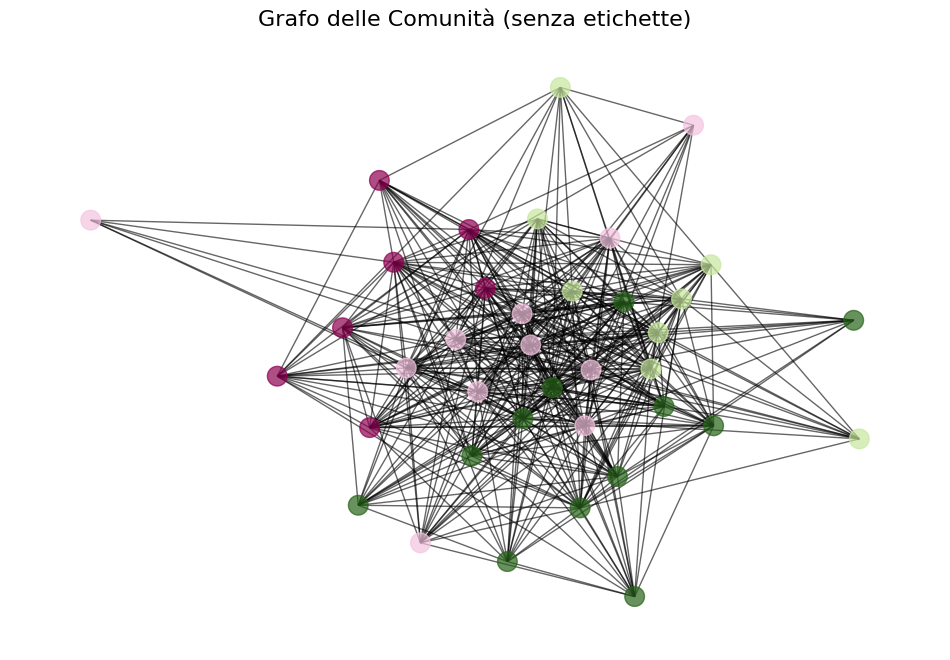

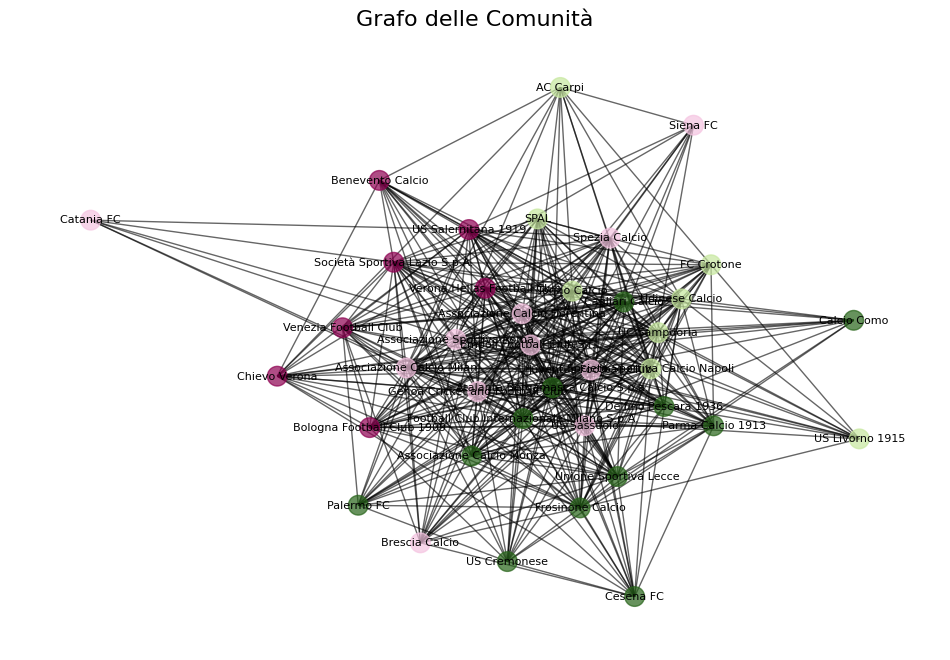

/Users/andreavisi/Library/Python/3.9/lib/python/site-packages/networkx/drawing/nx_pylab.py:437: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


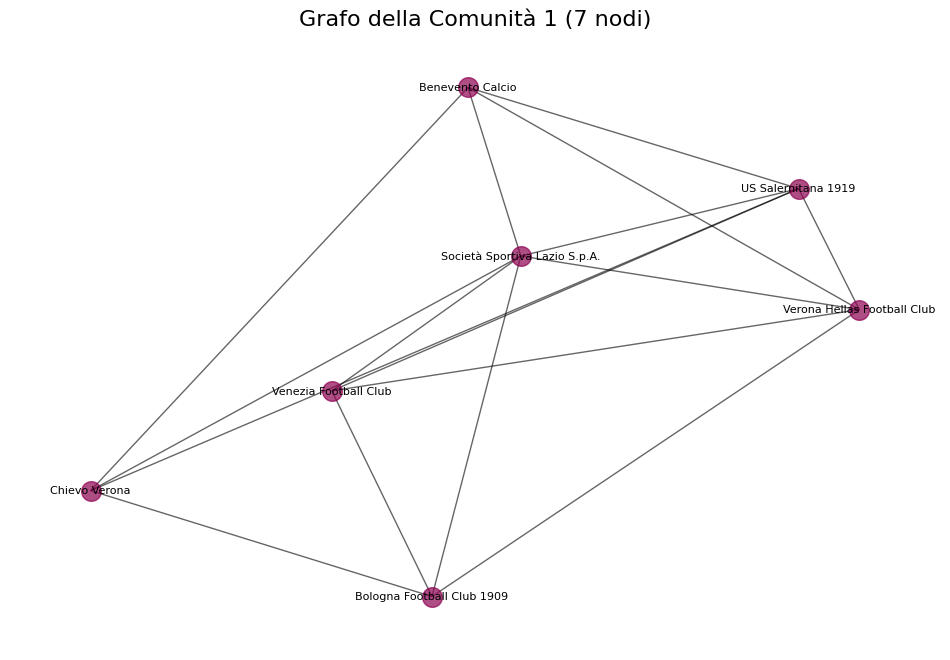

Comunità 1: ['Società Sportiva Lazio S.p.A.', 'US Salernitana 1919', 'Bologna Football Club 1909', 'Verona Hellas Football Club', 'Venezia Football Club', 'Benevento Calcio', 'Chievo Verona']


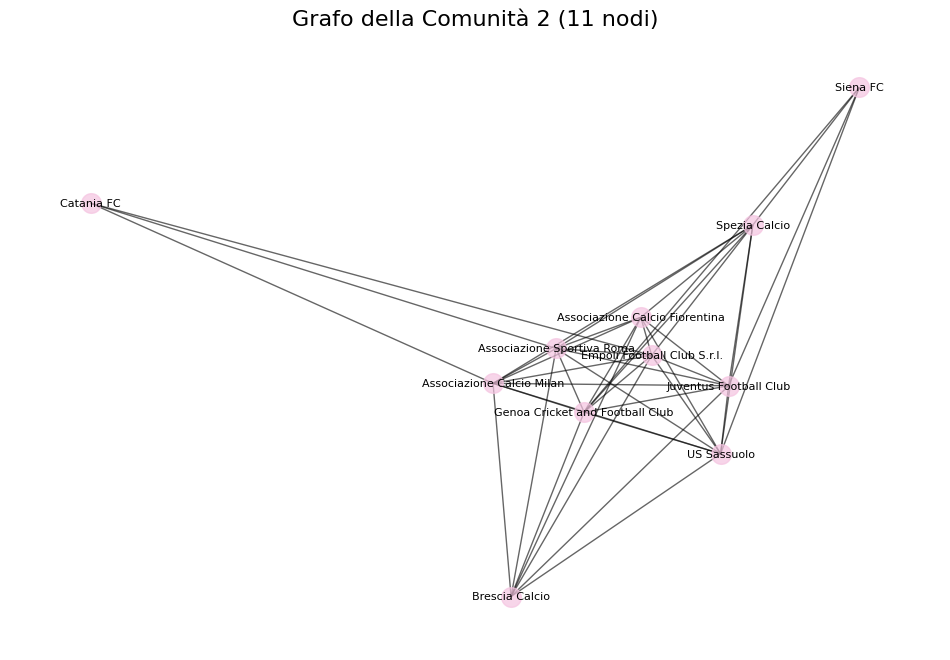

Comunità 2: ['Juventus Football Club', 'Associazione Calcio Fiorentina', 'Empoli Football Club S.r.l.', 'Genoa Cricket and Football Club', 'US Sassuolo', 'Associazione Calcio Milan', 'Associazione Sportiva Roma', 'Spezia Calcio', 'Catania FC', 'Brescia Calcio', 'Siena FC']


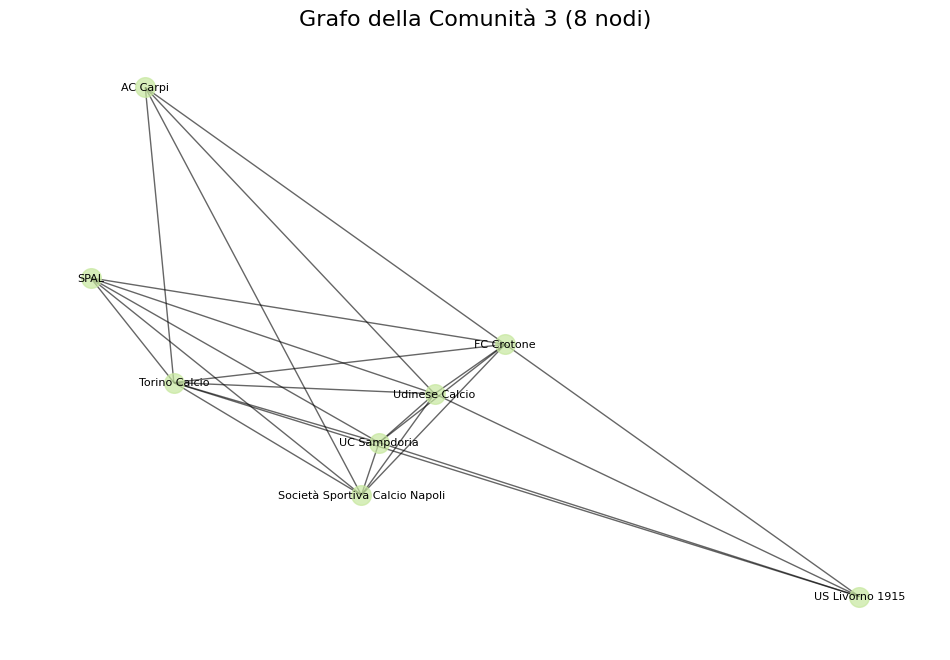

Comunità 3: ['UC Sampdoria', 'Società Sportiva Calcio Napoli', 'Torino Calcio', 'Udinese Calcio', 'FC Crotone', 'SPAL', 'US Livorno 1915', 'AC Carpi']


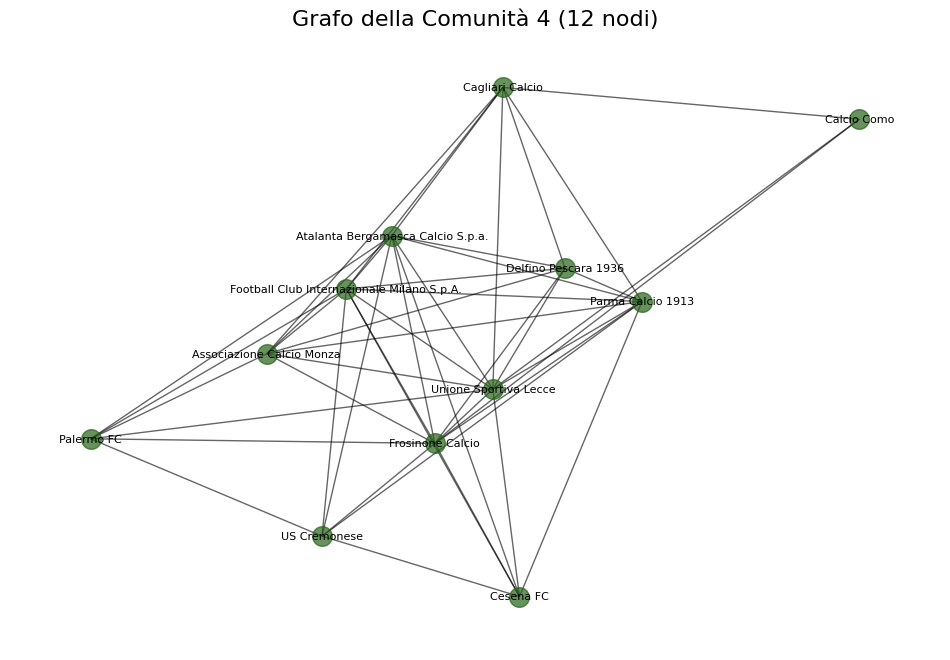

Comunità 4: ['Associazione Calcio Monza', 'Frosinone Calcio', 'Calcio Como', 'Atalanta Bergamasca Calcio S.p.a.', 'Unione Sportiva Lecce', 'Cagliari Calcio', 'Palermo FC', 'Football Club Internazionale Milano S.p.A.', 'Parma Calcio 1913', 'Cesena FC', 'US Cremonese', 'Delfino Pescara 1936']


In [94]:
import os
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import community as community_louvain

# Step 1: Caricare i dati
transfers_df = pd.read_csv('../Datasets/SNA/transfers.csv')
clubs_df = pd.read_csv('../Datasets/SNA/clubs.csv')

# Creare una directory per salvare le immagini
output_dir = 'community_graphs_it'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Sostituire i valori NaN in transfer_fee con 0
transfers_df['transfer_fee'] = transfers_df['transfer_fee'].fillna(0)

print(f"Numero di nodi: {G.number_of_nodes()}")
print(f"Numero di archi: {G.number_of_edges()}")

# Step 3: Creazione del grafo non diretto e rilevazione delle comunità
G_undirected = G_italian.to_undirected()
partition = community_louvain.best_partition(G_undirected)

# Rinumerare le comunità da 1
renumbered_partition = {node: comm + 1 for node, comm in partition.items()}
num_communities = len(set(renumbered_partition.values()))

# Mostrare il numero di comunità e la loro cardinalità
print(f"\nNumero di comunità trovate: {num_communities}")
community_sizes = {}
for node, comm in renumbered_partition.items():
    community_sizes[comm] = community_sizes.get(comm, 0) + 1

for comm, size in community_sizes.items():
    print(f"Comunità {comm}: {size} nodi")

# Calcolare le posizioni dei nodi una volta per il grafo totale
colors = plt.cm.PiYG(np.linspace(0, 1, num_communities))
node_colors = [colors[renumbered_partition[node] - 1] for node in G_undirected.nodes()]
pos = nx.spring_layout(G_undirected, seed=42)  # Calcolo unico del layout

# Step 4: Visualizzare il grafo totale con e senza etichette
# Grafo senza etichette
plt.figure(figsize=(12, 8))
nx.draw_networkx_nodes(G_undirected, pos, node_color=node_colors, node_size=200, alpha=0.7)
nx.draw_networkx_edges(G_undirected, pos, alpha=0.6)
plt.title("Grafo delle Comunità (senza etichette)", fontsize=16)
plt.axis('off')

# Salva la figura del grafo senza etichette
plt.savefig(os.path.join(output_dir, 'community_graph_no_labels.png'))
plt.show()
plt.close()

# Grafo con etichette
plt.figure(figsize=(12, 8))
nx.draw_networkx_nodes(G_undirected, pos, node_color=node_colors, node_size=200, alpha=0.7)
nx.draw_networkx_edges(G_undirected, pos, alpha=0.6)
nx.draw_networkx_labels(G_undirected, pos, font_size=8, font_color="black")
plt.title("Grafo delle Comunità", fontsize=16)
plt.axis('off')
# Salva la figura del grafo con etichette
plt.savefig(os.path.join(output_dir, 'community_graph_with_labels.png'))
plt.show()
plt.close()

# Step 5: Visualizzare i grafi per ogni comunità usando le stesse posizioni
for comm in range(1, num_communities + 1):
    # Filtrare i nodi della comunità corrente
    community_nodes = [node for node, com in renumbered_partition.items() if com == comm]
    community_subgraph = G_undirected.subgraph(community_nodes)
    
    # Disegnare il sottografo usando le posizioni del grafo totale
    plt.figure(figsize=(12, 8))
    nx.draw_networkx_nodes(community_subgraph, pos, node_size=200, node_color=colors[comm - 1], alpha=0.7)
    nx.draw_networkx_edges(community_subgraph, pos, alpha=0.6)
    nx.draw_networkx_labels(community_subgraph, pos, font_size=8, font_color="black")
    plt.title(f"Grafo della Comunità {comm} ({len(community_nodes)} nodi)", fontsize=16)
    plt.axis('off')
    # Salva il grafico della comunità
    plt.savefig(os.path.join(output_dir, f'community_{comm}_graph.png'))
    plt.show()
    plt.close()

    print(f"Comunità {comm}: {community_nodes}")

/var/folders/zt/9ggmn83106zfjymwl_r2kkdh0000gn/T/ipykernel_58668/2976358978.py:21: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("tab20")


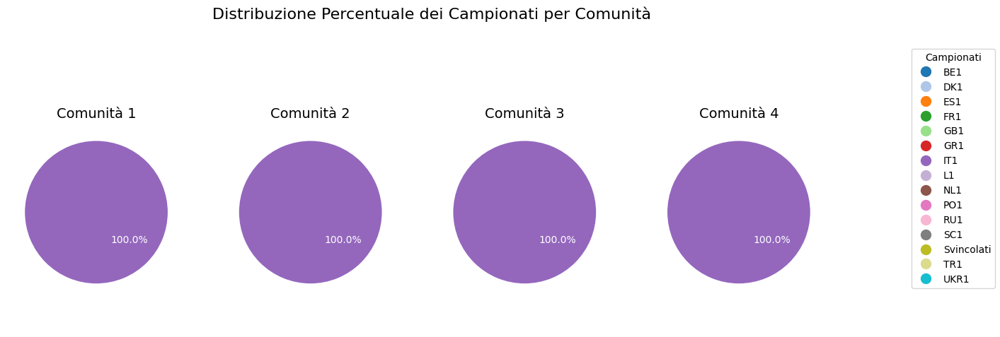

In [95]:
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap

# Creare una directory per salvare le immagini
output_dir = 'community_graphs_it'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Assumendo che 'clubs_df' contenga le colonne 'club_id' e 'domestic_competition_id' che mappano ogni club al suo campionato
club_to_competition = dict(zip(clubs_df['name'], clubs_df['domestic_competition_id']))

# Sostituire "Unknown" e "Without Club" con "Svincolati" nei dati
node_to_competition = {
    node: club_to_competition.get(node, 'Svincolati') for node in G.nodes()
}

# Trova tutti i campionati presenti, includendo "Svincolati"
all_competitions = set(node_to_competition.values())

# Generare una mappatura di colori unica per ogni campionato
cmap = get_cmap("tab20")
competition_colors = {
    competition: cmap(i / len(all_competitions)) for i, competition in enumerate(sorted(all_competitions))
}

# Creiamo una distribuzione dei campionati per ogni comunità
community_competition_distribution = {}

# Supponiamo che `renumbered_partition` contenga la mappatura delle squadre alle comunità
for comm in range(1, num_communities + 1):
    # Filtriamo i nodi appartenenti alla comunità corrente
    community_teams = [node for node, community in renumbered_partition.items() if community == comm]
    
    # Calcoliamo la distribuzione dei campionati per le squadre di questa comunità
    competition_counts = {}
    for team in community_teams:
        competition = node_to_competition.get(team, 'Svincolati')  # Assegna il campionato della squadra
        competition_counts[competition] = competition_counts.get(competition, 0) + 1
    
    # Aggiungiamo la distribuzione al dizionario per la comunità
    community_competition_distribution[comm] = competition_counts

# Ora puoi eseguire l'aggiornamento dei dati come prima
community_competition_distribution_updated = {}
for comm, distribution in community_competition_distribution.items():
    updated_distribution = {}
    for competition, value in distribution.items():
        competition = "Svincolati" if competition == "Unknown" else competition
        updated_distribution[competition] = updated_distribution.get(competition, 0) + value
    community_competition_distribution_updated[comm] = updated_distribution

# Ora puoi continuare con la parte del grafico
fig, axes = plt.subplots(1, num_communities, figsize=(16, 6), subplot_kw=dict(aspect="equal"))

for idx, (comm, distribution) in enumerate(community_competition_distribution_updated.items()):
    # Ordinare i dati per una rappresentazione coerente
    sorted_distribution = dict(sorted(distribution.items()))
    
    # Dati per il grafico
    labels = list(sorted_distribution.keys())
    sizes = list(sorted_distribution.values())
    colors = [competition_colors[label] for label in labels]
    
    # Disegnare il grafico
    wedges, texts, autotexts = axes[idx].pie(
        sizes, labels=labels, colors=colors, autopct="%.1f%%", startangle=140, textprops=dict(color="w")
    )
    axes[idx].set_title(f"Comunità {comm}", fontsize=14)

# Legenda comune per i grafici
fig.legend(
    handles=[plt.Line2D([0], [0], marker='o', color=color, markersize=10, linestyle='') for color in competition_colors.values()],
    labels=competition_colors.keys(),
    loc="center right",
    title="Campionati"
)

# Aggiungere uno spazio tra i grafici e la legenda
plt.subplots_adjust(right=0.85)
plt.suptitle("Distribuzione Percentuale dei Campionati per Comunità", fontsize=16)
plt.savefig(os.path.join(output_dir, f'distribuzione_comunità_it.png'))

plt.show()

/var/folders/zt/9ggmn83106zfjymwl_r2kkdh0000gn/T/ipykernel_58668/1179918820.py:14: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("tab20")


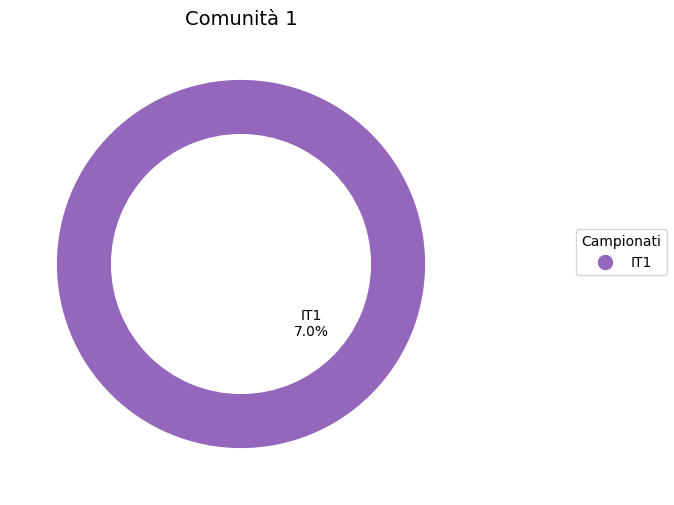

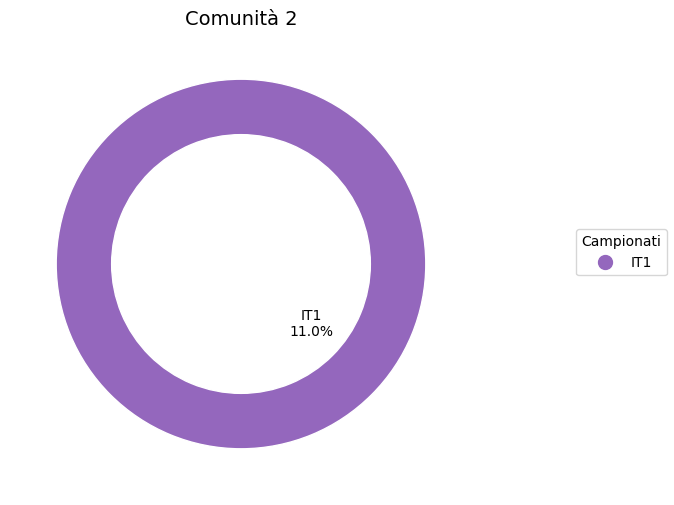

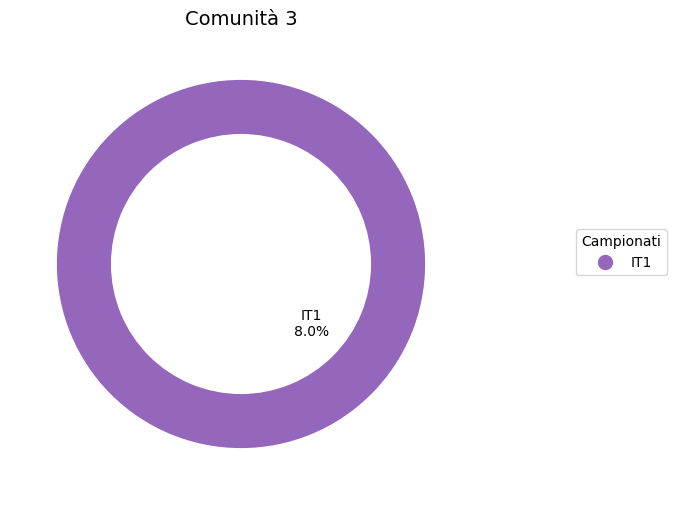

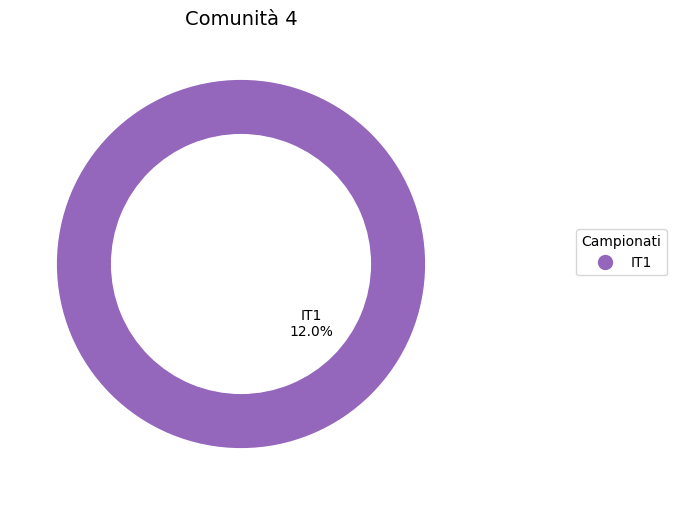

In [96]:
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap
import numpy as np

# Sostituire "Unknown" e "Without Club" con "Svincolati" nei dati
node_to_competition = {
    node: club_to_competition.get(node, 'Svincolati') for node in G.nodes()
}

# Trova tutti i campionati presenti, includendo "Svincolati"
all_competitions = set(node_to_competition.values())

# Generare una mappatura di colori unica per ogni campionato
cmap = get_cmap("tab20")
competition_colors = {
    competition: cmap(i / len(all_competitions)) for i, competition in enumerate(sorted(all_competitions))
}

# Aggiornare i dati per sostituire "Unknown" con "Svincolati" nelle distribuzioni
community_competition_distribution_updated = {}
for comm, distribution in community_competition_distribution.items():
    updated_distribution = {}
    for competition, value in distribution.items():
        competition = "Svincolati" if competition == "Unknown" else competition
        updated_distribution[competition] = updated_distribution.get(competition, 0) + value
    community_competition_distribution_updated[comm] = updated_distribution

# Creare un grafico ad anello per ogni comunità con la sua legenda
for comm, distribution in community_competition_distribution_updated.items():
    # Ordinare i dati per una rappresentazione coerente
    sorted_distribution = dict(sorted(distribution.items()))
    
    # Dati per il grafico
    labels = list(sorted_distribution.keys())
    sizes = list(sorted_distribution.values())
    colors = [competition_colors[label] for label in labels]
    
    # Disegnare il grafico ad anello
    fig, ax = plt.subplots(figsize=(8, 6), subplot_kw=dict(aspect="equal"))
    wedges, texts = ax.pie(
        sizes, labels=None, colors=colors, startangle=140, radius=1.0, wedgeprops=dict(width=0.3, edgecolor='w')
    )
    
    # Aggiungere i nomi dei campionati e le percentuali al centro dei segmenti
    for i, p in enumerate(wedges):
        ang = (p.theta2 - p.theta1) / 2.0 + p.theta1
        x = 0.5 * np.cos(np.radians(ang))  # Ridurre il raggio per spostare il testo verso il centro
        y = 0.5 * np.sin(np.radians(ang))
        ax.text(x, y, f"{labels[i]}\n{sizes[i]:.1f}%", ha='center', va='center', fontsize=10, color='black')

    ax.set_title(f"Comunità {comm}", fontsize=14)

    # Legenda specifica per questa comunità
    fig.legend(
        handles=[plt.Line2D([0], [0], marker='o', color=competition_colors[label], markersize=10, linestyle='') for label in labels],
        labels=labels,
        loc="center right",
        title="Campionati"
    )

    # Aggiungere spaziatura tra grafico e legenda
    plt.subplots_adjust(right=0.8)
    plt.show()

In [97]:
def filter_italian_teams(clubs_df):
    """
    Filtra le squadre italiane dal DataFrame dei club.
    
    Args:
        clubs_df (pd.DataFrame): DataFrame con le informazioni dei club.
        
    Returns:
        pd.DataFrame: DataFrame con solo le squadre italiane.
    """
    italian_teams = clubs_df[clubs_df['domestic_competition_id'] == 'IT1']  # Filtrare per paese, presupponendo che esista una colonna 'country'
    return italian_teams

def calculate_global_team_balance_for_italians(transfers_df, clubs_df):
    """
    Calcola il bilancio globale solo per le squadre italiane.
    
    Args:
        transfers_df (pd.DataFrame): Dati dei trasferimenti.
        clubs_df (pd.DataFrame): Dati dei club.
        
    Returns:
        dict: Bilancio globale per le squadre italiane.
    """
    italian_clubs = filter_italian_teams(clubs_df)
    italian_club_ids = italian_clubs['club_id'].values
    club_id_to_name = dict(zip(clubs_df['club_id'], clubs_df['name']))
    team_balances = {}

    for _, transfer in transfers_df.iterrows():
        from_club_id = transfer["from_club_id"]
        to_club_id = transfer["to_club_id"]
        fee = transfer["transfer_fee"]

        # Trovare i nomi dei club utilizzando la mappatura
        from_club = club_id_to_name.get(from_club_id, None)
        to_club = club_id_to_name.get(to_club_id, None)

        # Aggiornare i bilanci solo per le squadre italiane
        if from_club and from_club_id in italian_club_ids:
            team_balances[from_club] = team_balances.get(from_club, 0) + fee
        if to_club and to_club_id in italian_club_ids:
            team_balances[to_club] = team_balances.get(to_club, 0) - fee

    return team_balances

def calculate_season_team_balance_for_italians(transfers_df, season, clubs_df):
    """
    Calcola il bilancio delle squadre italiane per una stagione specifica.
    
    Args:
        transfers_df (pd.DataFrame): Dati dei trasferimenti.
        season (str): Stagione specifica (es. "23/24").
        clubs_df (pd.DataFrame): Dati dei club.
        
    Returns:
        dict: Bilancio della stagione per le squadre italiane.
    """
    italian_clubs = filter_italian_teams(clubs_df)
    italian_club_ids = italian_clubs['club_id'].values
    season_transfers = transfers_df[transfers_df["transfer_season"] == season]
    
    club_id_to_name = dict(zip(clubs_df['club_id'], clubs_df['name']))
    team_balances = {}

    for _, transfer in season_transfers.iterrows():
        from_club_id = transfer["from_club_id"]
        to_club_id = transfer["to_club_id"]
        fee = transfer["transfer_fee"]

        # Trovare i nomi dei club utilizzando la mappatura
        from_club = club_id_to_name.get(from_club_id, None)
        to_club = club_id_to_name.get(to_club_id, None)

        # Aggiornare i bilanci solo per le squadre italiane
        if from_club and from_club_id in italian_club_ids:
            team_balances[from_club] = team_balances.get(from_club, 0) + fee
        if to_club and to_club_id in italian_club_ids:
            team_balances[to_club] = team_balances.get(to_club, 0) - fee

    return team_balances

def calculate_global_community_balance_for_italians(transfers_df, partition, communities, clubs_df):
    """
    Calcola la media dei bilanci globali delle squadre italiane per ogni comunità.
    
    Args:
        transfers_df (pd.DataFrame): Dati dei trasferimenti.
        partition (dict): Mappatura delle squadre alle comunità.
        communities (list): Lista delle comunità.
        clubs_df (pd.DataFrame): Dati dei club.
        
    Returns:
        dict: Media dei bilanci per ogni comunità per le squadre italiane.
    """
    team_balances = calculate_global_team_balance_for_italians(transfers_df, clubs_df)
    community_balances = {comm: [] for comm in communities}

    for team, balance in team_balances.items():
        community = partition.get(team, None)
        if community:
            community_balances[community].append(balance)

    community_average_balances = {
        comm: sum(balances) / len(balances) if balances else 0
        for comm, balances in community_balances.items()
    }

    return community_average_balances

def calculate_season_community_balance_for_italians(transfers_df, partition, communities, season, clubs_df):
    """
    Calcola la media dei bilanci delle squadre italiane per ogni comunità nella stagione specifica.
    
    Args:
        transfers_df (pd.DataFrame): Dati dei trasferimenti.
        partition (dict): Mappatura delle squadre alle comunità.
        communities (list): Lista delle comunità.
        season (str): Stagione specifica (es. "23/24").
        clubs_df (pd.DataFrame): Dati dei club.
        
    Returns:
        dict: Media dei bilanci per ogni comunità nella stagione specifica per le squadre italiane.
    """
    team_balances = calculate_season_team_balance_for_italians(transfers_df, season, clubs_df)
    community_balances = {comm: [] for comm in communities}

    for team, balance in team_balances.items():
        community = partition.get(team, None)
        if community:
            community_balances[community].append(balance)

    community_average_balances = {
        comm: sum(balances) / len(balances) if balances else 0
        for comm, balances in community_balances.items()
    }

    return community_average_balances

# Esegui la funzione per le squadre italiane
transfers_df['transfer_fee'] = transfers_df['transfer_fee'].fillna(0)  # Sostituire NaN con 0 nei fee

# Bilancio globale di ogni squadra italiana
global_team_balances_italians = calculate_global_team_balance_for_italians(transfers_df, clubs_df)
print("\nBilancio globale di ogni squadra italiana:")
for team, balance in sorted(global_team_balances_italians.items(), key=lambda x: x[1], reverse=True):
    print(f"  {team}: {balance:.2f}")

# Media dei bilanci globali delle squadre italiane per comunità
global_community_balances_italians = calculate_global_community_balance_for_italians(transfers_df, renumbered_partition, range(1, num_communities + 1), clubs_df)
print("\nMedia dei bilanci globali delle comunità italiane:")
for community, balance in global_community_balances_italians.items():
    print(f"  Comunità {community}: {balance:.2f}")

# Bilancio delle squadre italiane nella stagione 23/24
season_team_balances_italians = calculate_season_team_balance_for_italians(transfers_df, "23/24", clubs_df)
print("\nBilancio delle squadre italiane nella stagione 23/24:")
for team, balance in sorted(season_team_balances_italians.items(), key=lambda x: x[1], reverse=True):
    print(f"  {team}: {balance:.2f}")

# Media dei bilanci delle squadre italiane per comunità nella stagione 23/24
season_community_balances_italians = calculate_season_community_balance_for_italians(transfers_df, renumbered_partition, range(1, num_communities + 1), "23/24", clubs_df)
print("\nMedia dei bilanci delle comunità italiane nella stagione 23/24:")
for community, balance in season_community_balances_italians.items():
    print(f"  Comunità {community}: {balance:.2f}")


Bilancio globale di ogni squadra italiana:
  Genoa Cricket and Football Club: 166200000.00
  Empoli Football Club S.r.l.: 154600000.00
  UC Sampdoria: 149950000.00
  Atalanta Bergamasca Calcio S.p.a.: 119495000.00
  Udinese Calcio: 116060500.00
  Verona Hellas Football Club: 115137000.00
  Spezia Calcio: 48728000.00
  US Sassuolo: 47401000.00
  Palermo FC: 40850000.00
  Associazione Calcio Fiorentina: 30730000.00
  SPAL: 24745000.00
  Delfino Pescara 1936: 24516000.00
  FC Crotone: 17640000.00
  Torino Calcio: 15910000.00
  Unione Sportiva Lecce: 15470000.00
  Brescia Calcio: 14475000.00
  Cesena FC: 13550000.00
  Frosinone Calcio: 12505000.00
  Siena FC: 8250000.00
  AC Carpi: 7755000.00
  Catania FC: 6750000.00
  Chievo Verona: 4390000.00
  US Livorno 1915: 900000.00
  US Cremonese: -4300000.00
  Benevento Calcio: -6450000.00
  Venezia Football Club: -19821500.00
  US Salernitana 1919: -23590000.00
  Bologna Football Club 1909: -41940000.00
  Calcio Como: -50630000.00
  Cagliari Cal

Bilancio Globale della Comunità 1 - Deviazione Standard: 57.03M, Varianza: 3252.94M²


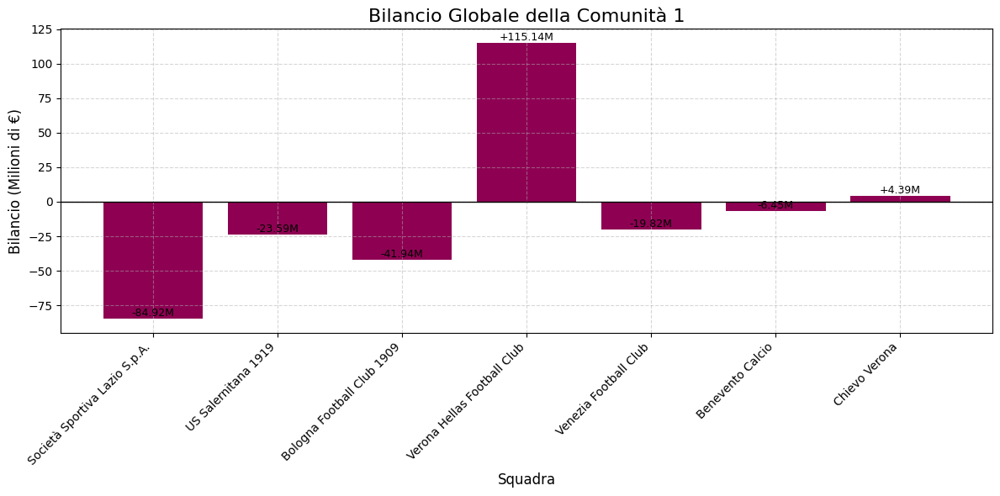

Bilancio della Comunità 1 nella Stagione 23/24 - Deviazione Standard: 43.11M, Varianza: 1858.79M²


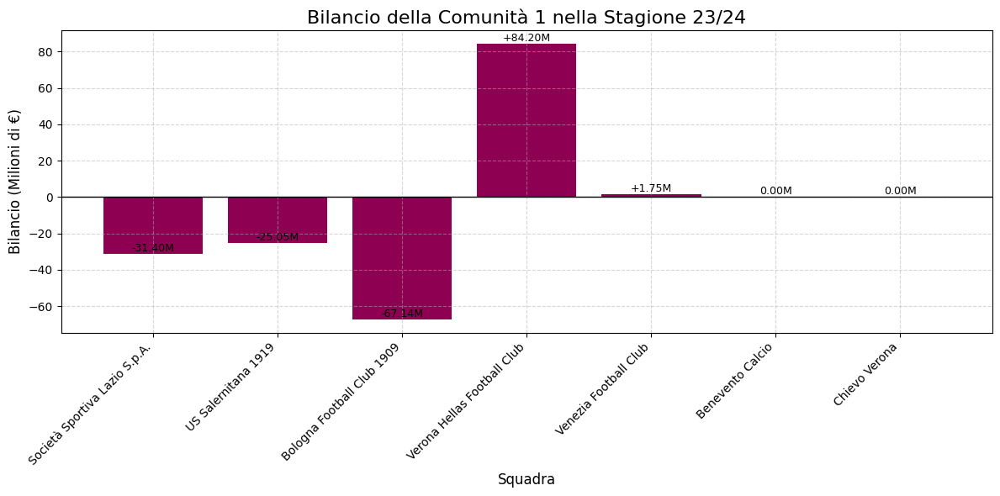

Bilancio Globale della Comunità 2 - Deviazione Standard: 195.41M, Varianza: 38184.48M²


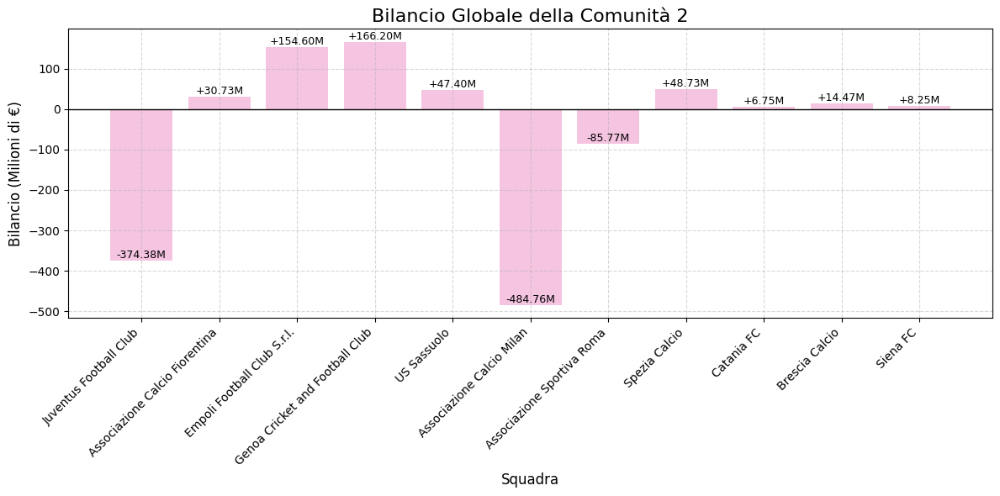

Bilancio della Comunità 2 nella Stagione 23/24 - Deviazione Standard: 31.54M, Varianza: 994.83M²


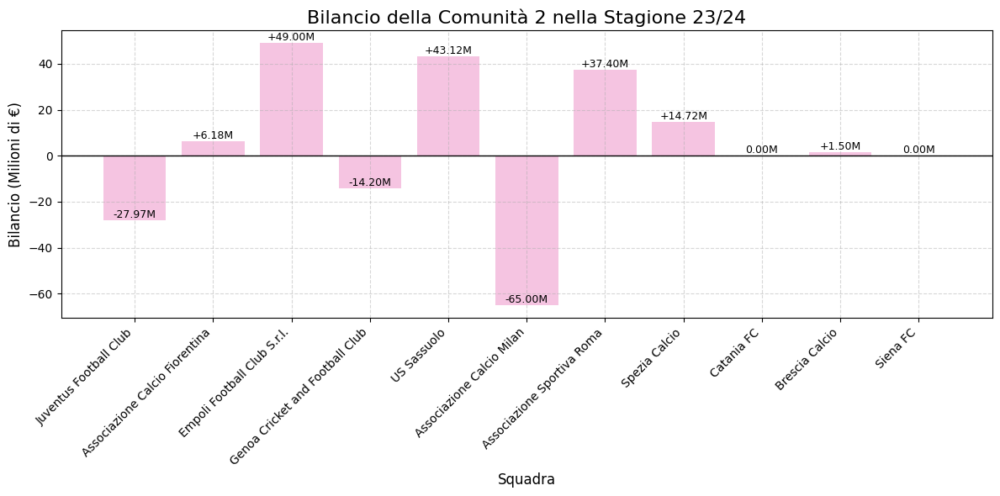

Bilancio Globale della Comunità 3 - Deviazione Standard: 222.47M, Varianza: 49493.15M²


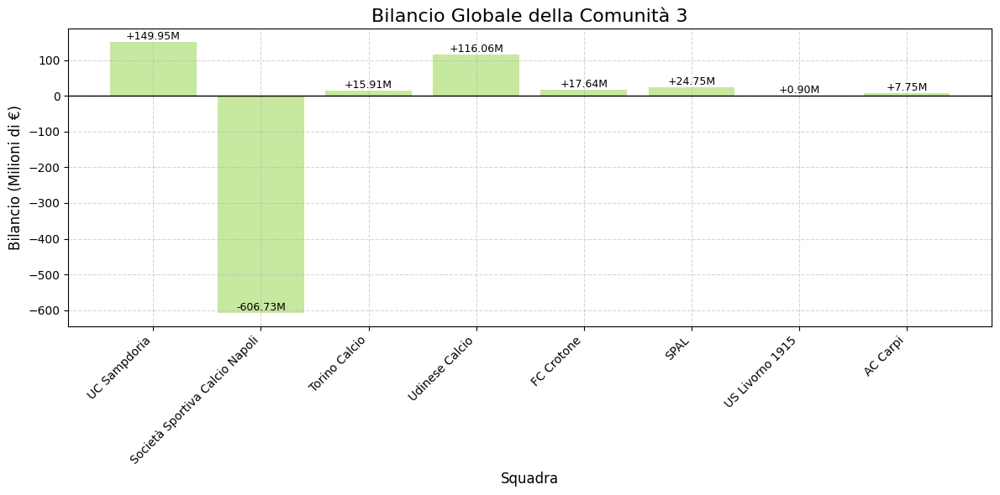

Bilancio della Comunità 3 nella Stagione 23/24 - Deviazione Standard: 12.91M, Varianza: 166.57M²


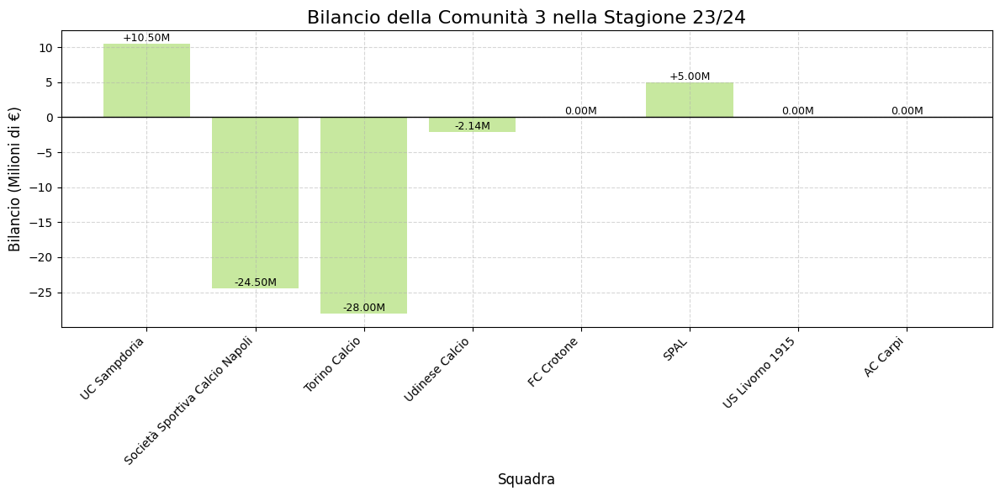

Bilancio Globale della Comunità 4 - Deviazione Standard: 80.37M, Varianza: 6459.24M²


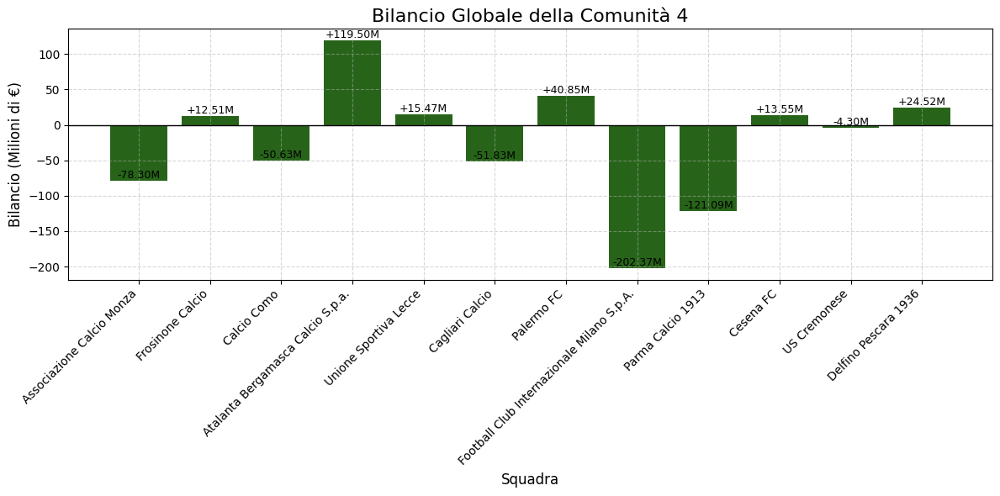

Bilancio della Comunità 4 nella Stagione 23/24 - Deviazione Standard: 22.75M, Varianza: 517.60M²


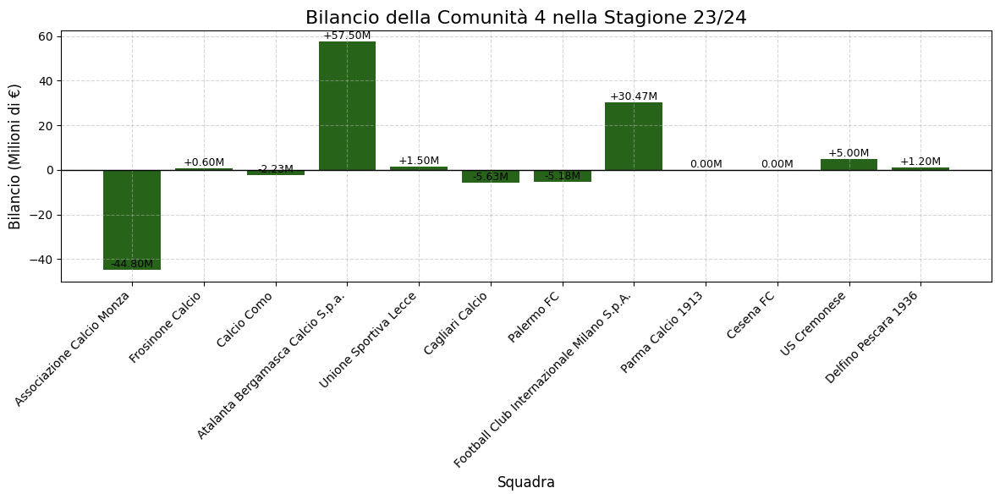

Bilancio Globale di Ogni Squadra (Italiane) - Deviazione Standard: 49.40M, Varianza: 2440.65M²


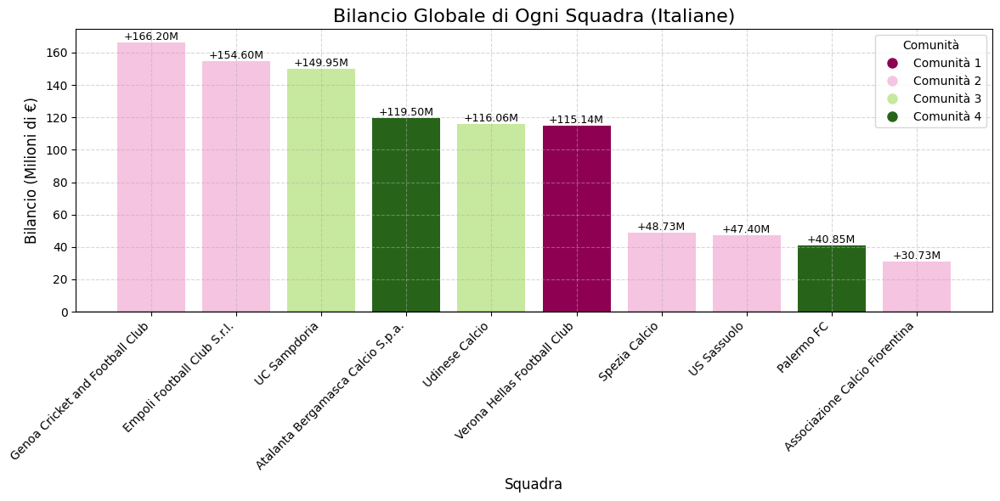

10 Squadre Italiane con il Bilancio Peggiore Globale - Deviazione Standard: 191.45M, Varianza: 36654.34M²


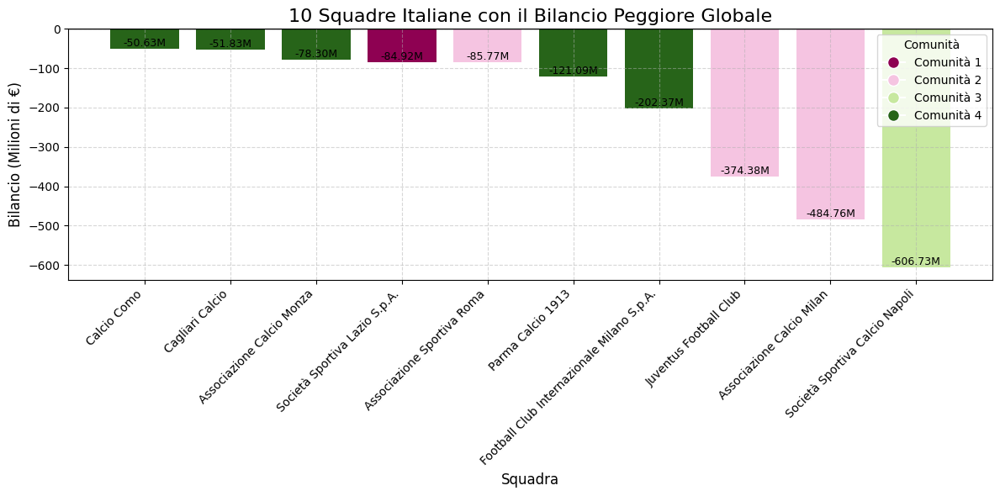

Media dei Bilanci Globali delle Comunità Italiane - Deviazione Standard: 20.32M, Varianza: 412.81M²


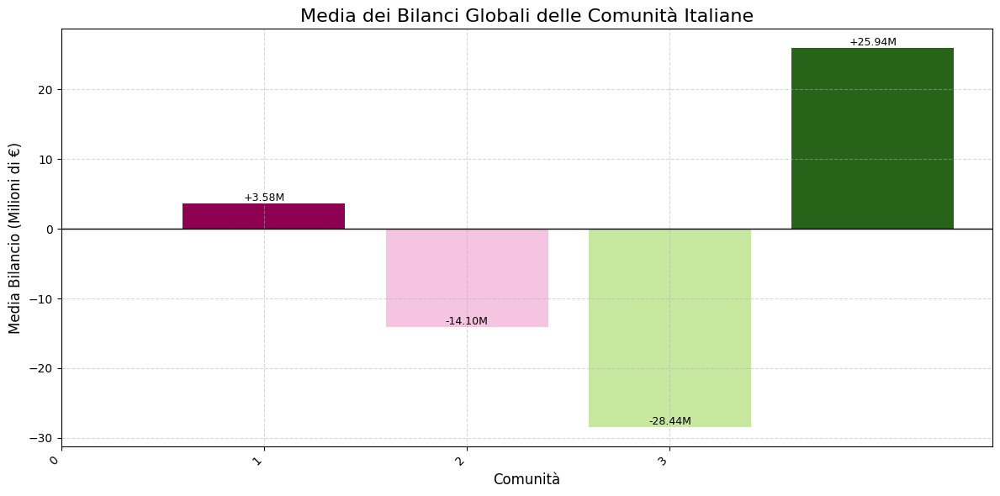

Bilancio delle Squadre Italiane nella Stagione 23/24 - Deviazione Standard: 24.38M, Varianza: 594.30M²


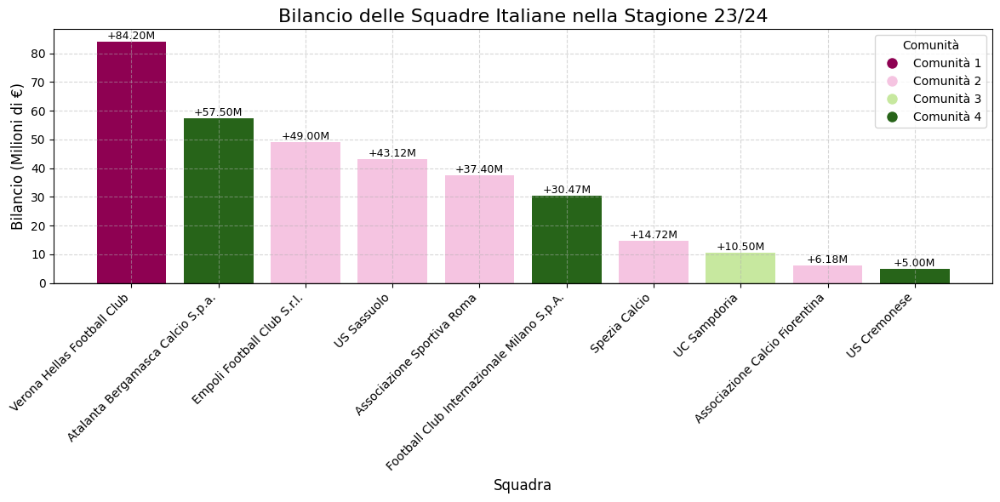

10 Squadre Italiane con il Bilancio Peggiore nella Stagione 23/24 - Deviazione Standard: 19.02M, Varianza: 361.83M²


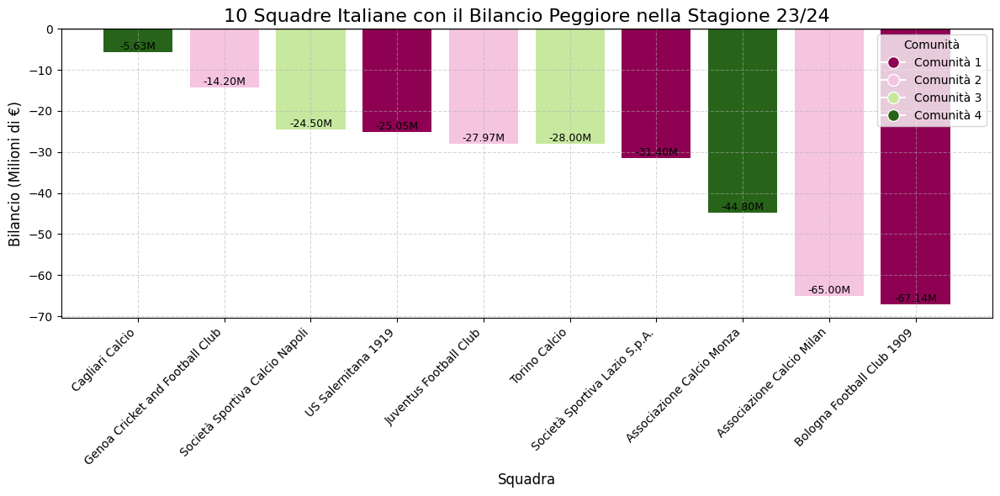

Media dei Bilanci delle Comunità Italiane nella Stagione 23/24 - Deviazione Standard: 1.09M, Varianza: 1.19M²


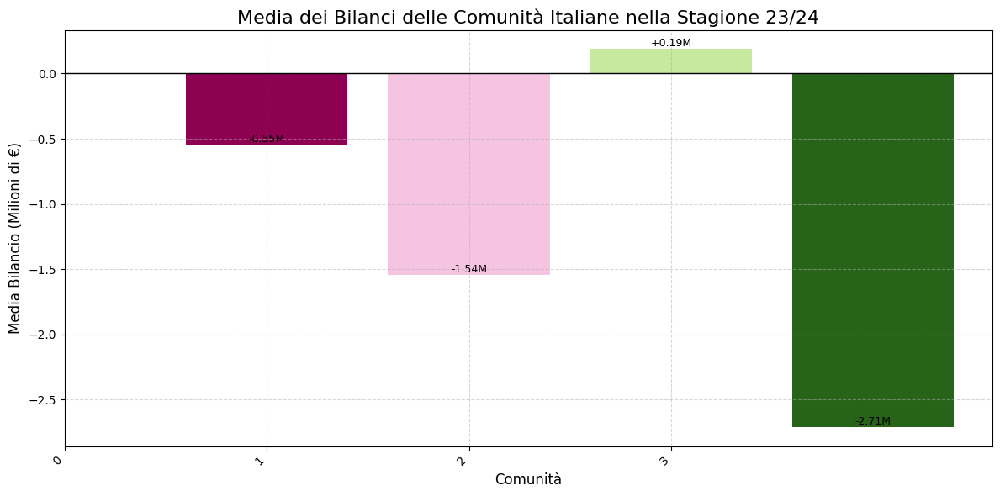

In [98]:
import numpy as np
import matplotlib.pyplot as plt

def plot_bar_chart(data, title, xlabel, ylabel, sort=False, top_n=None, community_mapping=None, community_colors=None, bar_colors=None):
    """
    Funzione per creare un istogramma a partire dai dati, con valori in milioni di euro.
    I migliori team possono essere colorati in base alla comunità cui appartengono.
    Calcola la deviazione standard e la varianza e le stampa a schermo, colorando di rosso scuro solo i valori negativi sopra l'istogramma.

    Args:
        data (dict): Dizionario con chiavi e valori da plottare.
        title (str): Titolo del grafico.
        xlabel (str): Etichetta asse X.
        ylabel (str): Etichetta asse Y.
        sort (bool): Ordinare i dati in ordine decrescente.
        top_n (int): Numero massimo di elementi da mostrare (se specificato).
        community_mapping (dict): Mappatura di ogni squadra alla sua comunità.
        community_colors (list): Colori delle comunità.
        bar_colors (list): Colori specifici per le barre.
    """
    # Ordinare i dati se richiesto
    if sort:
        data = dict(sorted(data.items(), key=lambda x: x[1], reverse=True))
    if top_n:
        data = dict(list(data.items())[:top_n])

    # Convertire i valori in milioni di euro
    data_in_millions = {key: value / 1e6 for key, value in data.items()}

    # Calcolare la deviazione standard e la varianza
    values = list(data_in_millions.values())
    std_dev = np.std(values)
    variance = np.var(values)

    # Stampare la deviazione standard e la varianza a schermo
    print(f"{title} - Deviazione Standard: {std_dev:.2f}M, Varianza: {variance:.2f}M²")
    
    # Determinare i colori basati sulla comunità, se forniti
    if community_mapping and community_colors:
        colors = [
            community_colors[community_mapping.get(team, 0) - 1] if team in community_mapping else 'gray'
            for team in data.keys()
        ]
    elif bar_colors:
        colors = bar_colors
    else:
        colors = 'skyblue'

    # Creare il grafico
    plt.figure(figsize=(12, 6))
    bars = plt.bar(
        data_in_millions.keys(),
        data_in_millions.values(),
        color=colors
    )

    # Aggiungere i valori sopra ogni colonna, colorando di rosso scuro i valori negativi
    for bar, team in zip(bars, data_in_millions.keys()):
        height = bar.get_height()
        sign = "+" if height > 0 else ""
        color = 'black' 

        plt.text(
            bar.get_x() + bar.get_width() / 2,
            height,
            f"{sign}{height:.2f}M",
            ha='center',
            va='bottom',
            fontsize=9,
            color=color
        )

    # Aggiungere la riga nera per il valore 0
    plt.axhline(0, color='black', linewidth=1)

    # Aggiungere griglia
    plt.grid(True, linestyle='--', alpha=0.5)

    # Titoli e etichette
    plt.title(title, fontsize=16)
    plt.xlabel(xlabel, fontsize=12)
    plt.ylabel(ylabel, fontsize=12)
    plt.xticks(rotation=45, ha='right', fontsize=10)

    # Impostazione dell'asse X con numeri interi per la media dei bilanci
    if ylabel == "Media Bilancio (Milioni di €)":
        plt.xticks(np.arange(len(data_in_millions)), [int(i) for i in range(len(data_in_millions))], fontsize=10)

    # Aggiungere la legenda per i colori delle comunità (solo nel bilancio globale delle squadre)
    if community_mapping and community_colors:
        from matplotlib.lines import Line2D
        legend_elements = [
            Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10, label=f"Comunità {i+1}")
            for i, color in enumerate(community_colors)
        ]
        plt.legend(handles=legend_elements, title="Comunità", loc="upper right", fontsize=10)

    plt.tight_layout()
    plt.show()


# Filtrare le squadre italiane da renumbered_partition
italian_teams = [team for team in renumbered_partition.keys() if team in clubs_df[clubs_df['domestic_competition_id'] == 'IT1']['name'].values]

# Creare la mappatura dei colori delle comunità in base al grafo
colors = plt.cm.PiYG(np.linspace(0, 1, num_communities))  # Colori in base al numero di comunità

# Istogrammi separati per ogni comunità (bilanci globali)
for comm in range(1, num_communities + 1):
    # Selezioniamo i nodi della comunità che sono italiani
    community_nodes = [node for node, community in renumbered_partition.items() if community == comm and node in italian_teams]
    
    # Bilancio globale per i team di quella comunità
    community_team_balances = {team: global_team_balances.get(team, 0) for team in community_nodes}
    
    # Plot dei bilanci globali della comunità
    plot_bar_chart(
        community_team_balances,
        title=f"Bilancio Globale della Comunità {comm}",
        xlabel="Squadra",
        ylabel="Bilancio (Milioni di €)",
        bar_colors=[colors[comm - 1]] * len(community_team_balances)  # Colore unico per la comunità
    )

    # Bilancio delle squadre della comunità nella stagione 23/24
    community_season_balances = {team: season_team_balances.get(team, 0) for team in community_nodes}
    
    # Plot dei bilanci della stagione 23/24 della comunità
    plot_bar_chart(
        community_season_balances,
        title=f"Bilancio della Comunità {comm} nella Stagione 23/24",
        xlabel="Squadra",
        ylabel="Bilancio (Milioni di €)",
        bar_colors=[colors[comm - 1]] * len(community_season_balances)  # Colore unico per la comunità
    )


# Bilancio globale di ogni squadra con colori basati sulla comunità e legenda per le squadre italiane
plot_bar_chart(
    {team: balance for team, balance in global_team_balances.items() if team in italian_teams},
    title="Bilancio Globale di Ogni Squadra (Italiane)",
    xlabel="Squadra",
    ylabel="Bilancio (Milioni di €)",
    sort=True,
    top_n=10,  # Mostra le prime 20 squadre italiane
    community_mapping=renumbered_partition,  # Mappa squadre -> comunità
    community_colors=list(colors)  # Colori delle comunità
)

# Bilancio globale delle 20 squadre italiane con il bilancio peggiore
worst_20_global_team_balances = dict(sorted({team: balance for team, balance in global_team_balances.items() if team in italian_teams}.items(), key=lambda x: x[1])[:10])

plot_bar_chart(
    worst_20_global_team_balances,
    title="10 Squadre Italiane con il Bilancio Peggiore Globale",
    xlabel="Squadra",
    ylabel="Bilancio (Milioni di €)",
    sort=True,
    top_n=10,  # Mostra le 20 squadre italiane con il bilancio peggiore
    community_mapping=renumbered_partition,  # Mappa squadre -> comunità
    community_colors=list(colors)  # Colori delle comunità
)

# Media dei bilanci globali delle comunità italiane (con legenda)
plot_bar_chart(
    {comm: balance for comm, balance in global_community_balances.items() if any(team in italian_teams for team in renumbered_partition if renumbered_partition[team] == comm)},
    title="Media dei Bilanci Globali delle Comunità Italiane",
    xlabel="Comunità",
    ylabel="Media Bilancio (Milioni di €)",
    bar_colors=list(colors[:len(global_community_balances)])
)

# Bilancio delle squadre italiane nella stagione 23/24
plot_bar_chart(
    {team: balance for team, balance in season_team_balances.items() if team in italian_teams},
    title="Bilancio delle Squadre Italiane nella Stagione 23/24",
    xlabel="Squadra",
    ylabel="Bilancio (Milioni di €)",
    sort=True,
    top_n=10,  # Mostra le prime 20 squadre italiane
    community_mapping=renumbered_partition,  # Mappa squadre -> comunità
    community_colors=list(colors)  # Colori delle comunità
)

# Bilancio delle 20 squadre italiane con il bilancio peggiore nella stagione 23/24
worst_20_season_team_balances = dict(sorted({team: balance for team, balance in season_team_balances.items() if team in italian_teams}.items(), key=lambda x: x[1])[:10])

plot_bar_chart(
    worst_20_season_team_balances,
    title="10 Squadre Italiane con il Bilancio Peggiore nella Stagione 23/24",
    xlabel="Squadra",
    ylabel="Bilancio (Milioni di €)",
    sort=True,
    top_n=10,  # Mostra le 20 squadre italiane con il bilancio peggiore
    community_mapping=renumbered_partition,  # Mappa squadre -> comunità
    community_colors=list(colors)  # Colori delle comunità
)

# Media dei bilanci delle comunità italiane nella stagione 23/24
plot_bar_chart(
    {comm: balance for comm, balance in season_community_balances.items() if any(team in italian_teams for team in renumbered_partition if renumbered_partition[team] == comm)},
    title="Media dei Bilanci delle Comunità Italiane nella Stagione 23/24",
    xlabel="Comunità",
    ylabel="Media Bilancio (Milioni di €)",
    bar_colors=list(colors[:len(season_community_balances)])
)

/var/folders/zt/9ggmn83106zfjymwl_r2kkdh0000gn/T/ipykernel_58668/3349921989.py:79: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)


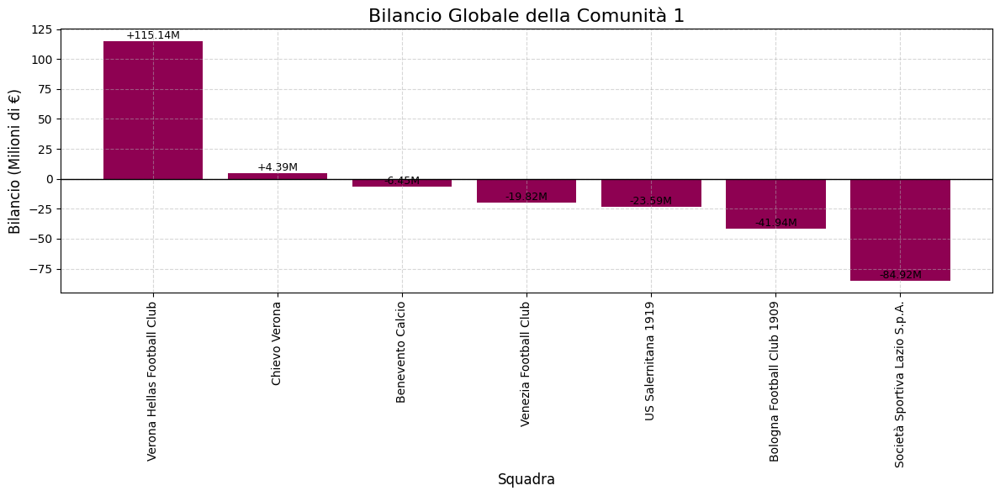

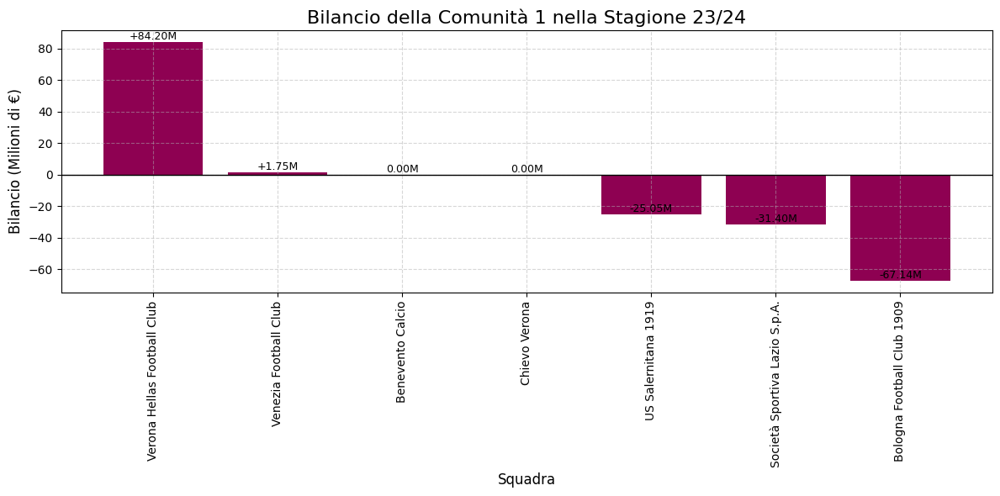

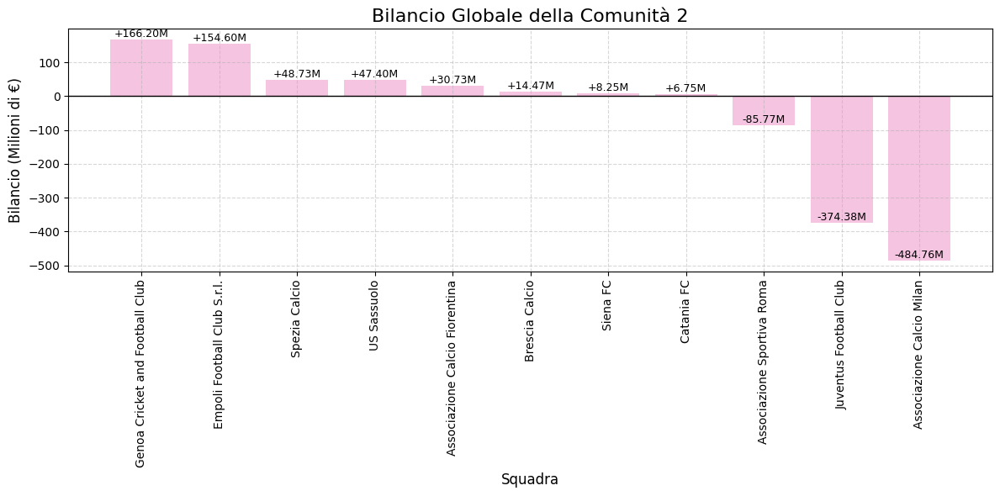

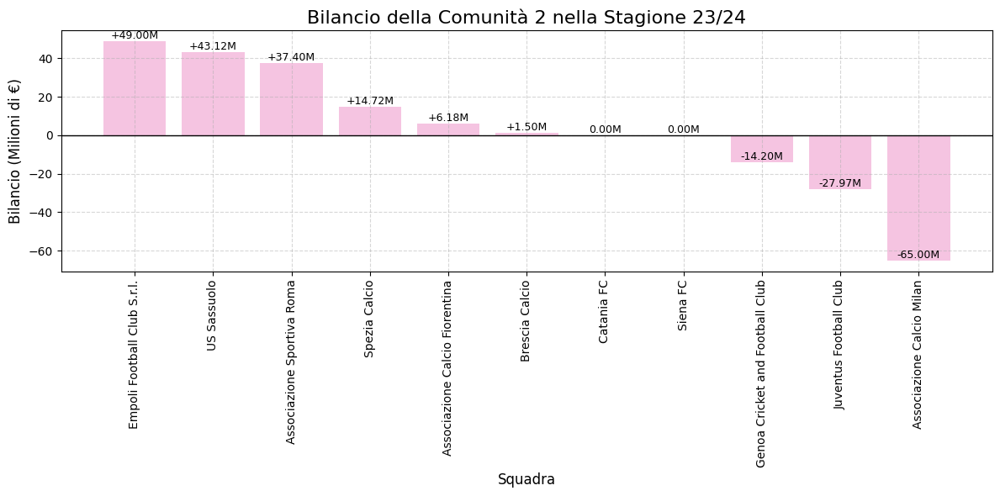

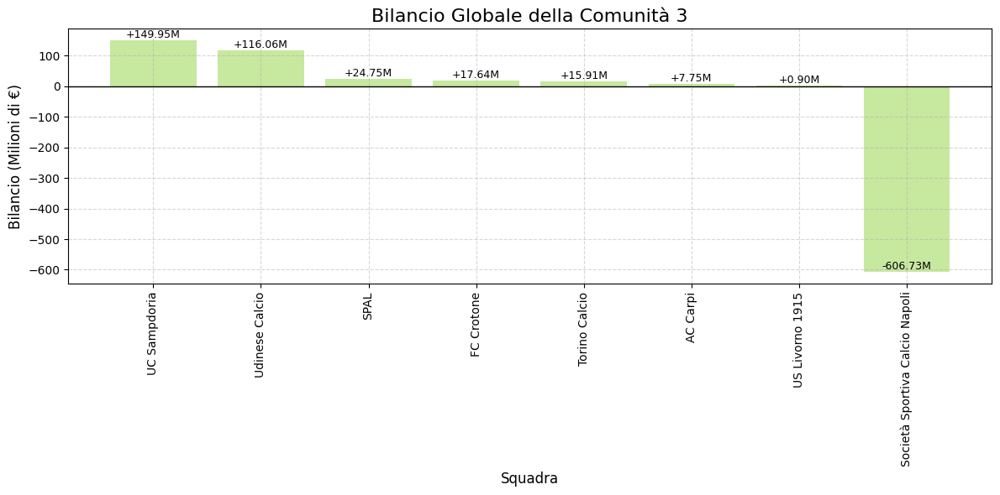

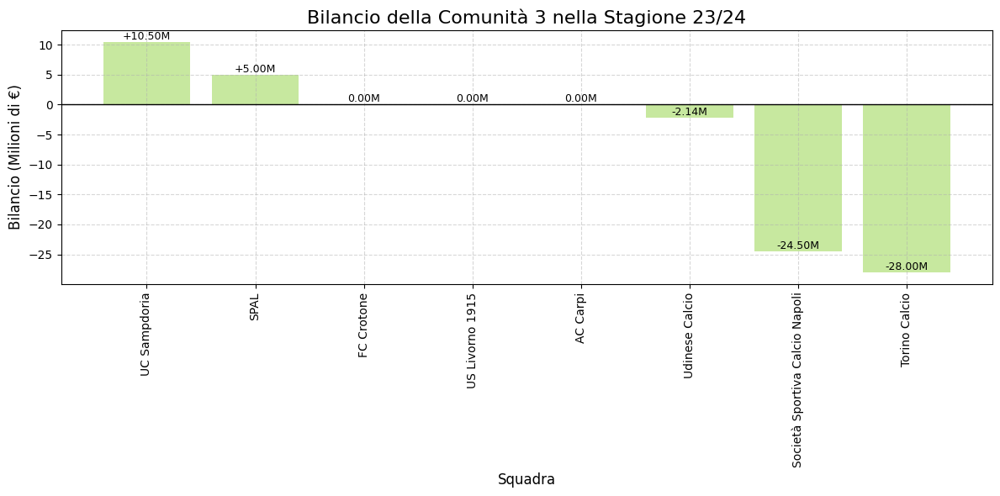

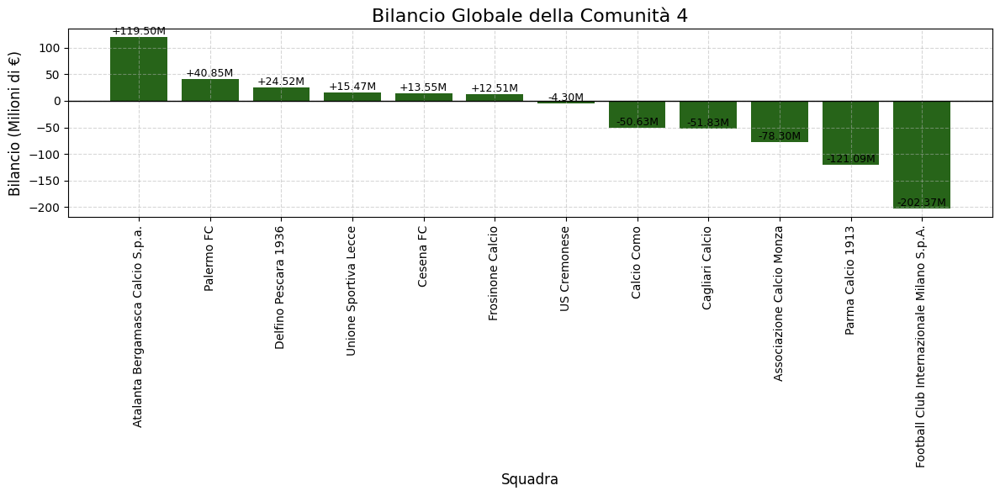

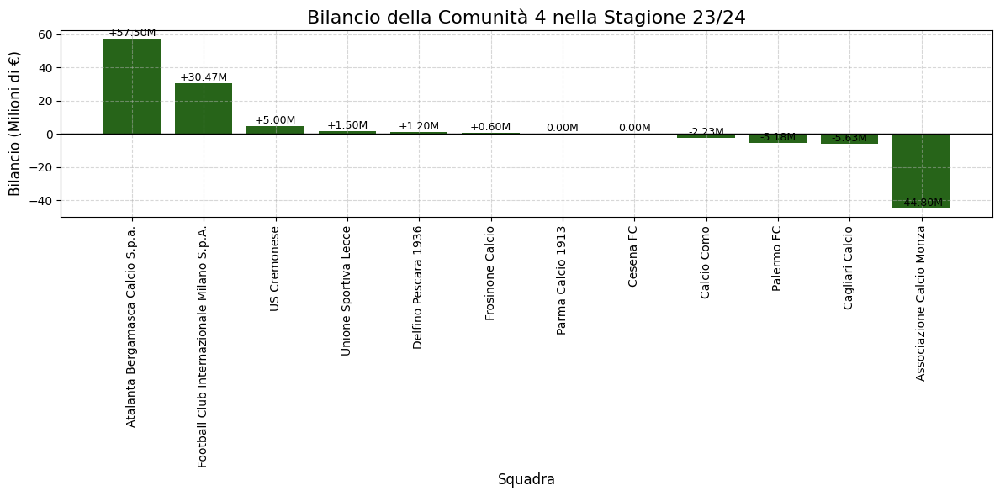

In [99]:
def plot_bar_chart(data, title, xlabel, ylabel, sort=False, top_n=None, community_mapping=None, community_colors=None, bar_colors=None, line_position=None):
    """
    Funzione per creare un istogramma a partire dai dati, con valori in milioni di euro.
    I migliori team possono essere colorati in base alla comunità cui appartengono.

    Args:
        data (dict): Dizionario con chiavi e valori da plottare.
        title (str): Titolo del grafico.
        xlabel (str): Etichetta asse X.
        ylabel (str): Etichetta asse Y.
        sort (bool): Ordinare i dati in ordine decrescente.
        top_n (int): Numero massimo di elementi da mostrare (se specificato).
        community_mapping (dict): Mappatura di ogni squadra alla sua comunità.
        community_colors (list): Colori delle comunità.
        bar_colors (list): Colori specifici per le barre.
        line_position (int): Posizione della linea rossa verticale per separare i migliori e peggiori club.
    """
    # Ordinare i dati se richiesto
    if sort:
        data = dict(sorted(data.items(), key=lambda x: x[1], reverse=True))
    if top_n:
        data = dict(list(data.items())[:top_n])

    # Convertire i valori in milioni di euro
    data_in_millions = {key: value / 1e6 for key, value in data.items()}

    # Determinare i colori basati sulla comunità, se forniti
    if community_mapping and community_colors:
        colors = [
            community_colors[community_mapping.get(team, 0) - 1] if team in community_mapping else 'gray'
            for team in data.keys()
        ]
    elif bar_colors:
        colors = bar_colors
    else:
        colors = 'skyblue'

    # Creare il grafico
    plt.figure(figsize=(12, 6))
    bars = plt.bar(
        data_in_millions.keys(),
        data_in_millions.values(),
        color=colors
    )

    # Aggiungere i valori sopra ogni colonna
    for bar in bars:
        height = bar.get_height()
        sign = "+" if height > 0 else ""
        plt.text(
            bar.get_x() + bar.get_width() / 2,
            height,
            f"{sign}{height:.2f}M",
            ha='center',
            va='bottom',
            fontsize=9,
            color='black'
        )

    # Aggiungere la riga nera per il valore 0
    plt.axhline(0, color='black', linewidth=1)

    # Aggiungere la linea rossa verticale per separare i migliori e peggiori club
    if line_position is not None:
        plt.axvline(x=line_position, color='red', linestyle='--', linewidth=2)

    # Aggiungere griglia
    plt.grid(True, linestyle='--', alpha=0.5)

    # Titoli e etichette
    plt.title(title, fontsize=16)
    plt.xlabel(xlabel, fontsize=12)
    plt.ylabel(ylabel, fontsize=12)
    
    # Ruotare i nomi delle squadre in verticale
    plt.xticks(rotation=90, ha='center', fontsize=10)

    # Rimuovere la legenda
    plt.legend().set_visible(False)

    plt.tight_layout()
    plt.show()

# Codice per generare i grafici
for comm in range(1, num_communities + 1):
    # Selezioniamo i nodi della comunità
    community_nodes = [node for node, community in renumbered_partition.items() if community == comm]
    
    # Bilancio globale per i team di quella comunità
    community_team_balances = {team: global_team_balances.get(team, 0) for team in community_nodes}
    
    # Ordinare i bilanci in ordine decrescente
    sorted_community_balances = dict(sorted(community_team_balances.items(), key=lambda x: x[1], reverse=True))

    # Prendere i 5 migliori e i 5 peggiori club
    best_5 = list(sorted_community_balances.items())[:10]
    worst_5 = list(sorted_community_balances.items())[-5:]

    # Unire i 5 migliori e peggiori in un solo dizionario
    combined_balances = dict(best_5 + worst_5)

    # Trova la posizione dove separare i migliori dai peggiori (la linea rossa verticale)
    line_position = len(best_5)

    # Plot dei bilanci globali della comunità con la separazione tra i migliori e peggiori
    plot_bar_chart(
        combined_balances,
        title=f"Bilancio Globale della Comunità {comm}",
        xlabel="Squadra",
        ylabel="Bilancio (Milioni di €)",
        community_mapping=renumbered_partition,  # Mappa squadre -> comunità
        community_colors=[colors[comm - 1]] * len(combined_balances)  # Colore unico per la comunità
    )

    # Bilancio delle squadre della comunità nella stagione 23/24
    community_season_balances = {team: season_team_balances.get(team, 0) for team in community_nodes}
    
    # Ordinare i bilanci della stagione 23/24 in ordine decrescente
    sorted_community_season_balances = dict(sorted(community_season_balances.items(), key=lambda x: x[1], reverse=True))

    # Prendere i 5 migliori e i 5 peggiori club nella stagione 23/24
    best_5_season = list(sorted_community_season_balances.items())[:10]
    worst_5_season = list(sorted_community_season_balances.items())[-5:]

    # Unire i 5 migliori e peggiori nella stagione 23/24
    combined_balances_season = dict(best_5_season + worst_5_season)

    # Trova la posizione dove separare i migliori dai peggiori (la linea rossa verticale)
    line_position_season = len(best_5_season)

    # Plot dei bilanci della stagione 23/24 della comunità con la separazione tra i migliori e peggiori
    plot_bar_chart(
        combined_balances_season,
        title=f"Bilancio della Comunità {comm} nella Stagione 23/24",
        xlabel="Squadra",
        ylabel="Bilancio (Milioni di €)",
        community_mapping=renumbered_partition,  # Mappa squadre -> comunità
        community_colors=[colors[comm - 1]] * len(combined_balances_season)  # Colore unico per la comunità
    )

Indice di Similarità Medio per la Comunità 1: 1.0000


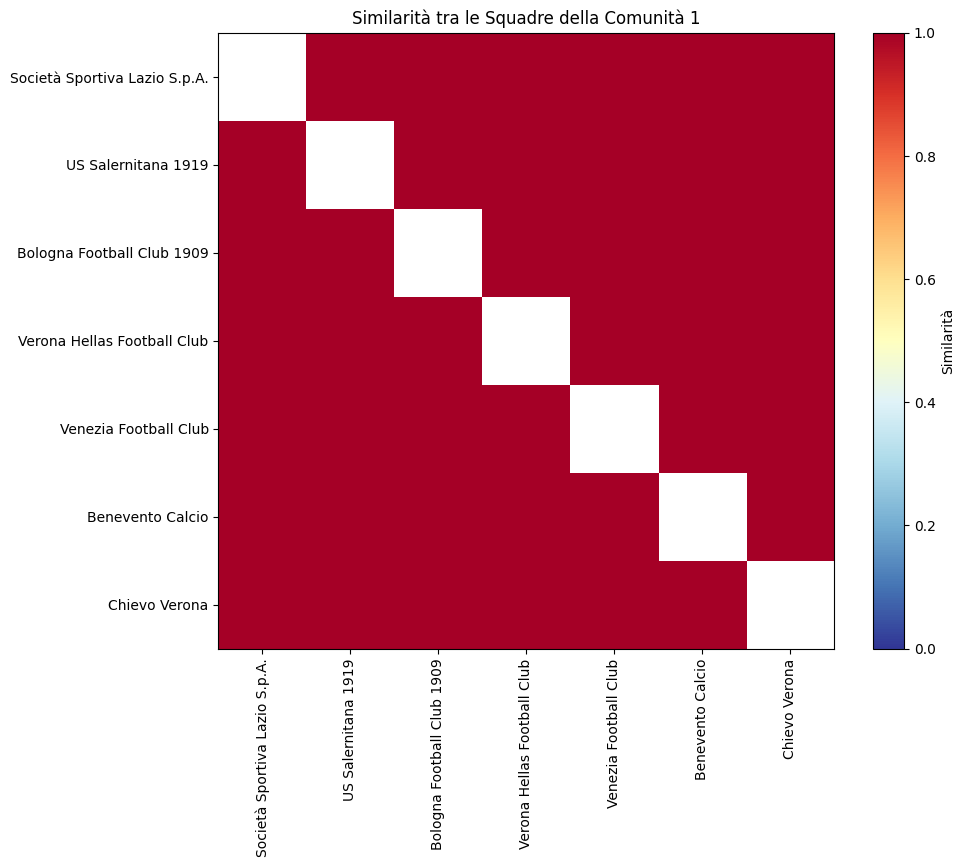

Indice di Similarità Medio per la Comunità 2: 0.9999


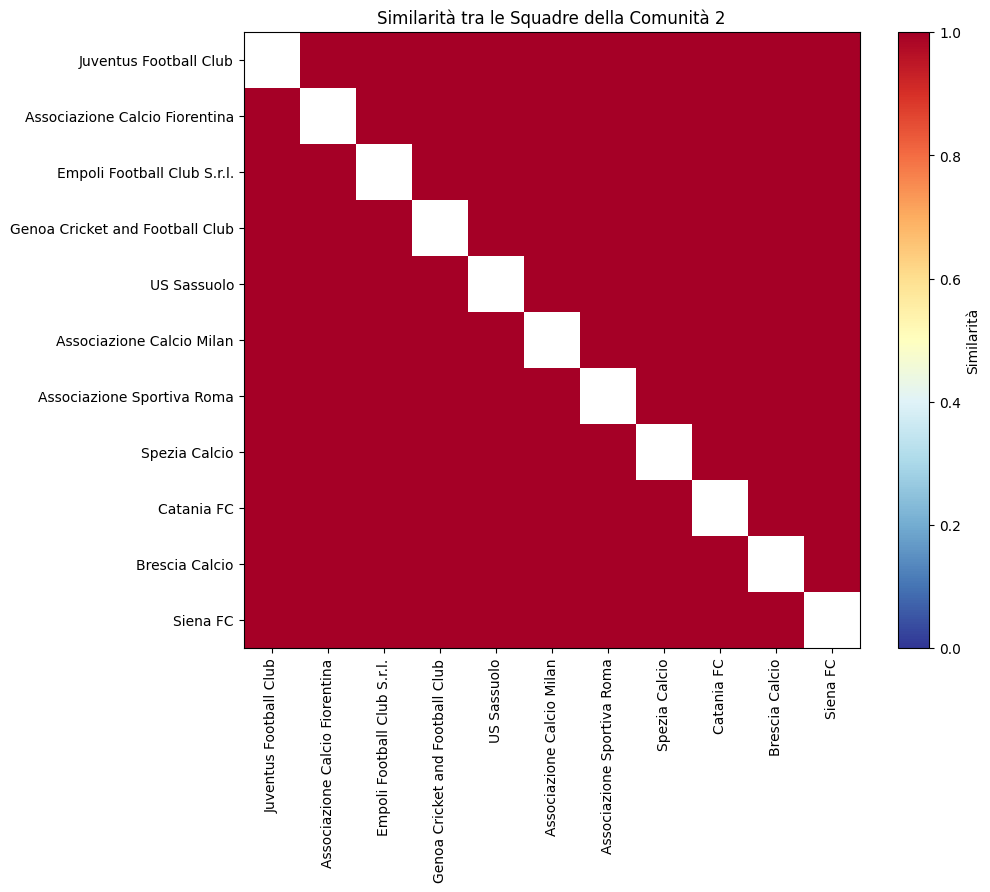

Indice di Similarità Medio per la Comunità 3: 0.9999


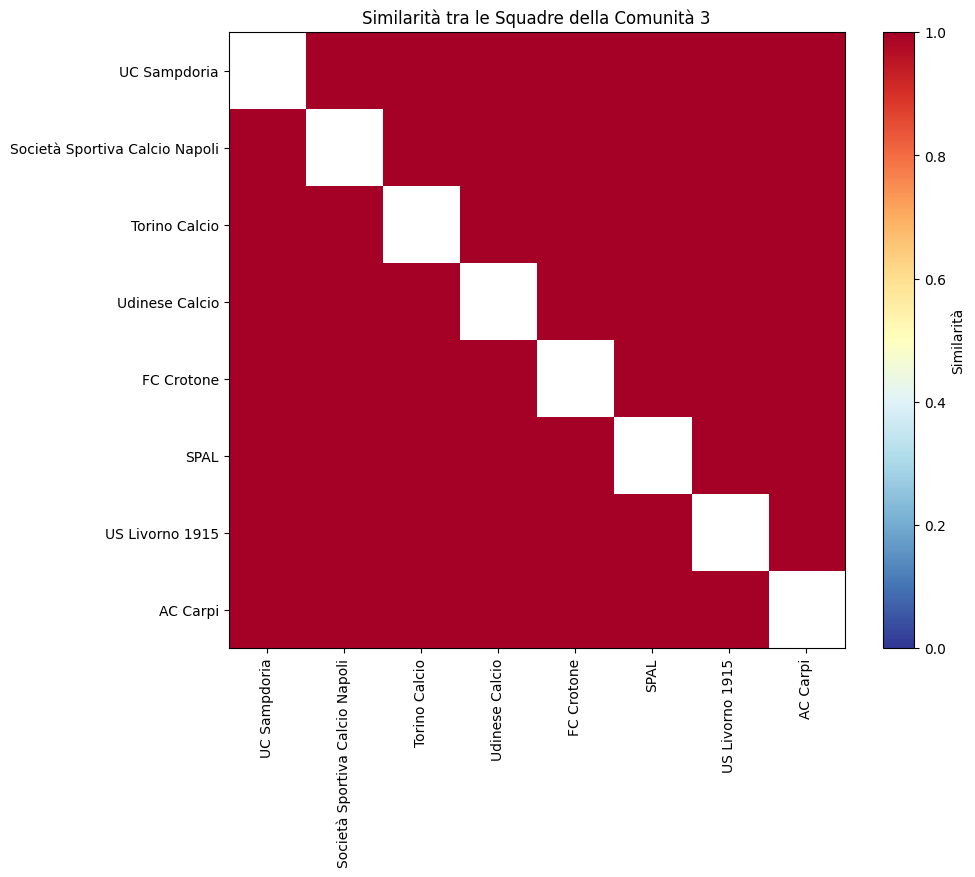

Indice di Similarità Medio per la Comunità 4: 1.0000


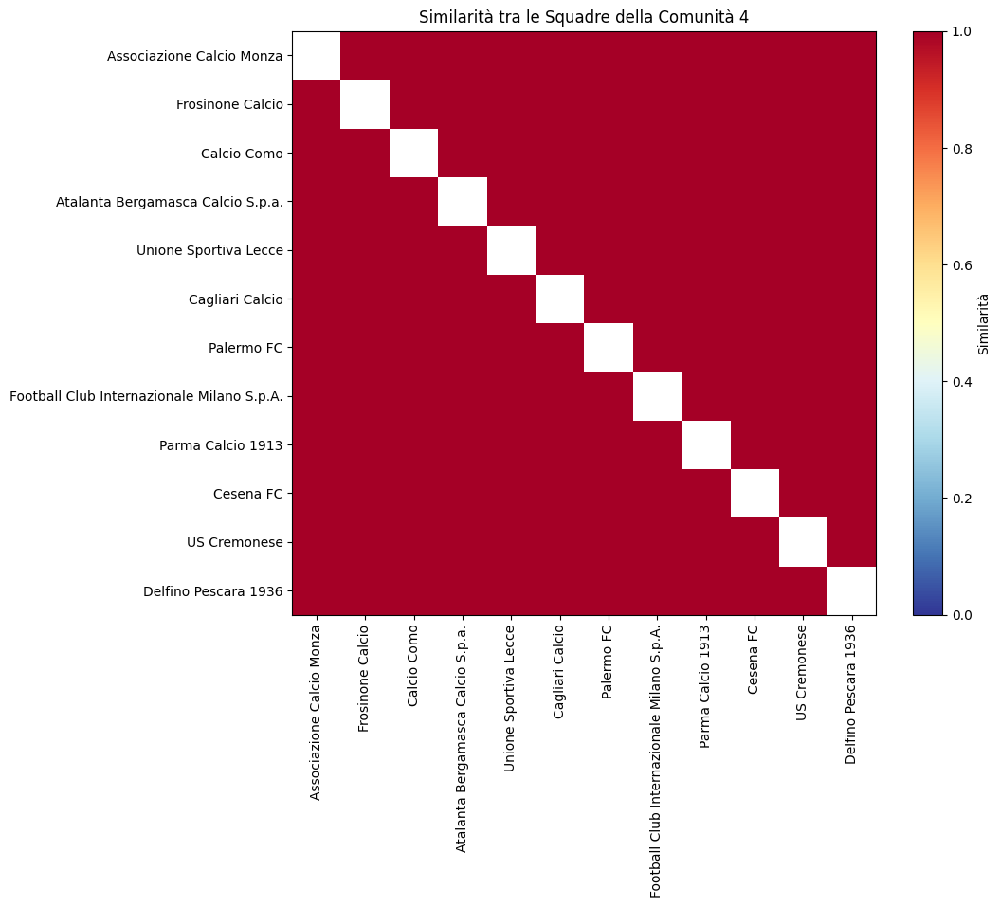

In [100]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity

def plot_all_community_similarities(df_features, similarity_matrix, renumbered_partition):
    """
    Calcola e visualizza la similarità tra le squadre per ogni comunità, con una heatmap
    che ha lo 0 bianco e i colori sono proporzionati alla similarità.

    Args:
        df_features (pd.DataFrame): Caratteristiche delle squadre.
        similarity_matrix (np.ndarray): Matrice di similarità tra le squadre.
        renumbered_partition (dict): Mappatura dei nodi alle comunità.
    """
    num_communities = len(set(renumbered_partition.values()))
    
    for comm in range(1, num_communities + 1):
        community_teams = [team for team, comm_id in renumbered_partition.items() if comm_id == comm]
        
        if not community_teams:
            print(f"Attenzione: la comunità {comm} non contiene squadre.")
            continue
        
        community_features = df_features[df_features["Team"].isin(community_teams)]
        
        if community_features.empty:
            print(f"Attenzione: nessuna caratteristica trovata per le squadre nella comunità {comm}.")
            continue
        
        missing_teams = [team for team in community_teams if team not in df_features["Team"].values]
        if missing_teams:
            print(f"Attenzione: le seguenti squadre non sono presenti nel DataFrame per la comunità {comm}: {missing_teams}")

        community_indices = []
        for team in community_teams:
            team_index = df_features[df_features["Team"] == team].index
            if not team_index.empty:
                community_indices.append(team_index[0])
            else:
                print(f"Attenzione: la squadra {team} non è nel DataFrame delle caratteristiche.")

        if not community_indices:
            print(f"Errore: nessuna squadra valida trovata per la comunità {comm}.")
            continue

        community_similarity_matrix = similarity_matrix[community_indices, :][:, community_indices]

        avg_similarity = calculate_average_similarity(community_similarity_matrix)
        print(f"Indice di Similarità Medio per la Comunità {comm}: {avg_similarity:.4f}")

        # Personalizzazione della heatmap per mostrare lo 0 come bianco e i colori proporzionati alla similarità
        plt.figure(figsize=(10, 8))
        # Usare un colormap personalizzato che va da bianco (0) a rosso brillante (1)
        cmap = plt.cm.RdYlBu_r  # Rosso-giallo-blu, invertito per fare il bianco al centro
        plt.imshow(community_similarity_matrix, cmap=cmap, interpolation="nearest", vmin=0, vmax=1)
        plt.colorbar(label="Similarità")

        # Etichette delle squadre
        plt.xticks(range(len(community_teams)), community_teams, rotation=90)
        plt.yticks(range(len(community_teams)), community_teams)

        plt.title(f"Similarità tra le Squadre della Comunità {comm}")
        plt.show()

# Esegui la funzione per tutte le comunità
df_features = get_team_features(transfers_df, clubs_df, renumbered_partition)
similarity_matrix = calculate_similarity(df_features)
plot_all_community_similarities(df_features, similarity_matrix, renumbered_partition)